<a href="https://colab.research.google.com/github/qudsiramiz/udthesis/blob/main/python/udthesis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mount the drive

In [1]:
from google.colab import drive

drive.mount("/content/gdrive", force_remount=True)
!pwd

Mounted at /content/gdrive
/content


In [2]:
cd /content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis

/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis


In [3]:
!ls

'2021-06-21 11.42.32 PhD Thesis Defense'   data      ToDos.gsheet
 Certificates				   figures


## Import the required packages

In [4]:
import os,sys

import time as tm

start = tm.time()

from IPython.display import clear_output

import copy
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.ticker import FormatStrFormatter
from matplotlib.dates import DateFormatter, AutoDateFormatter, AutoDateLocator
from matplotlib.ticker import FuncFormatter
import matplotlib as mpl
import matplotlib.colors as colors
from matplotlib import gridspec
import seaborn as sns

from datetime     import *
from matplotlib   import pyplot
from glob         import glob
import pandas as pd

from scipy.interpolate import interp1d as spl

import warnings

#plt.close( 'all' )

# Stop printing 'too many figures' warning

plt.rcParams.update({'figure.max_open_warning': 0})
#plt.rcParams["figure.figsize"] = [16,10]

import numpy as np

import sys

import h5py as hf
import scipy as sp
%matplotlib inline

from astropy import units as u

import warnings
warnings.filterwarnings('ignore')
#from google.colab import output

## Install plasmapy

In [ ]:
!pip install plasmapy
clear_output()

In [ ]:
# If this doesn't work, just restart the runtime and it will work!
import plasmapy as pp
import plasmapy.formulary as pfp

In [ ]:
# Define a tick formatter
def tickformatx(x):
    if int(x) == float(x):
        return str(round(10**x, 2))
    else:
        return str(round(10**x, 2))

def tickformaty(x):
    if int(x) == float(x):
        return str(round(10**x/1e6, 3))
    else:
        return str(round(10**x/1e6, 3))

## Install all Latex dependencies

In [5]:
%%time
!sudo apt-get install aptitude
!sudo aptitude install texlive-fonts-recommended texlive-fonts-extra
!pip install tex
!sudo apt-get -y install texlive-full
!sudo apt-get install dvipng
!sudo apt-get install --fix-missing
!sudo apt-get update
clear_output()

CPU times: user 4.82 s, sys: 885 ms, total: 5.71 s
Wall time: 8min 1s


In [6]:
font = { 'family' : 'Times New Roman', 'weight' : 'normal', 'size' : 10 }
plt.rc( 'font', **font )
plt.rc('text', usetex=True)

In [ ]:
'''
from matplotlib.backends.backend_pgf import FigureCanvasPgf
matplotlib.backend_bases.register_backend('pdf', FigureCanvasPgf)

import matplotlib.pyplot as plt

pgf_with_latex = {
    "text.usetex": True,            # use LaTeX to write all text
    "pgf.rcfonts": False,           # Ignore Matplotlibrc
    "pgf.preamble": [
        r'\usepackage{color}'     # xcolor for colours
    ]
}
font = { 'family' : 'Times New Roman', 'weight' : 'normal', 'size' : 10 }
plt.rc( 'font', **font )
matplotlib.rcParams.update(pgf_with_latex)
'''

# Spline interpolation

In [9]:
%%time

from scipy.interpolate  import RectBivariateSpline

# Stop printing 'too many figures' warning

plt.rcParams.update({'figure.max_open_warning': 0})
plt.rcParams["figure.figsize"] = [8,10]

#fn = 'brazil_149p6_rs0.h5'

#fn = 'Data/data_Rp_betap_jz_b.h5'

#fn = 'Data/data_Rp_betap_jz_b_149p6_hb.h5'
#
#data = hf.File( fn, 'r+' )
#
#rp = data['Rp']
#
#bp = data['betap']

#-------------------------------------------------------------------------------
# Spline interpolation of the growth rate
#-------------------------------------------------------------------------------

def spl_int( x=None, y=None, ang=None ) :

	
    if ( x is None ) :

        raise ValueError( 'MMS beta value missing' )
        return

    if ( y is None ) :

        raise ValueError( 'MMS anisotropy value missing' )
        return

    if ( ang is None ) :

        raise ValueError( 'Propagation angle information missing' )
        return

    # Load the growth rates and create a spline function for each of the
    # different type of waves

    drct = '../mms/mms_fest/linear_instability_files/mms_instab/'

    # Parallel firehose

    drct_f1 = drct + 'fir1/'

    lin_b_f1 = np.loadtxt( drct_f1 + 'out_bj.dat'  )[0]
    lin_r_f1 = np.loadtxt( drct_f1 + 'out_ri.dat'  )[:,0]
    lin_g_f1 = np.transpose( np.loadtxt( drct_f1 + 'out_gij.dat' )  )
    lin_k_f1 = np.transpose( np.loadtxt( drct_f1 + 'out_kij.dat' )  )

    spline_g_f1 = RectBivariateSpline( lin_b_f1, lin_r_f1, lin_g_f1 )
    spline_k_f1 = RectBivariateSpline( lin_b_f1, lin_r_f1, lin_k_f1 )

    # Cyclotron

    drct_cl = drct + 'cycl/'

    lin_b_cl = np.loadtxt( drct_cl + 'out_bj.dat'  )[0]
    lin_r_cl = np.loadtxt( drct_cl + 'out_ri.dat' )[:,0]
    lin_g_cl = np.transpose( np.loadtxt( drct_cl + 'out_gij.dat' )  )
    lin_k_cl = np.transpose( np.loadtxt( drct_cl + 'out_kij.dat' )  )

    spline_g_cl = RectBivariateSpline( lin_b_cl, lin_r_cl, lin_g_cl )
    spline_k_cl = RectBivariateSpline( lin_b_cl, lin_r_cl, lin_k_cl )

    # Oblique firehose

    drct_f2 = drct + 'fir2/'

    lin_b_f2 = np.loadtxt( drct_f2 + 'out_bj.dat'  )[0]
    lin_r_f2 = np.loadtxt( drct_f2 + 'out_ri.dat'  )[:,0]
    lin_g_f2 = np.transpose( np.loadtxt(drct_f2 + 'out_gij.dat' )  )
    lin_k_f2 = np.transpose( np.loadtxt( drct_f2 + 'out_kij.dat' )  )

    spline_g_f2 = RectBivariateSpline( lin_b_f2, lin_r_f2, lin_g_f2 )
    spline_k_f2 = RectBivariateSpline( lin_b_f2, lin_r_f2, lin_k_f2 )

	# Mirror

    drct_mr = drct + 'mirr/'

    lin_b_mr = np.loadtxt( drct_mr + 'out_bj.dat'  )[0]
    lin_r_mr = np.loadtxt( drct_mr + 'out_ri.dat'  )[:,0]
    lin_g_mr = np.transpose( np.loadtxt(drct_mr + 'out_gij.dat' )  )
    lin_k_mr = np.transpose( np.loadtxt( drct_mr + 'out_kij.dat' )  )

    spline_g_mr = RectBivariateSpline( lin_b_mr, lin_r_mr, lin_g_mr )
    spline_k_mr = RectBivariateSpline( lin_b_mr, lin_r_mr, lin_k_mr )

    g_a = np.full( np.shape( x ), np.nan )
    g_b = np.full( np.shape( x ), np.nan )

    k_a = np.full( np.shape( x ), np.nan )
    k_b = np.full( np.shape( x ), np.nan )

    for i in range( np.shape( x )[0] ) :

        #print( i )
        for j in range( np.shape( x )[1] ) :
            
            #f = FloatProgress(min=0, max=shape(x)[0] )
            #display(f)

            try :

                if( y[i,j] >= 1 and ang == 'par' ) :
	
                    g_a[i,j] = spline_g_cl( x[i,j], y[i,j] )
                    k_a[i,j] = spline_k_cl( x[i,j], y[i,j] )

                elif( y[i,j] <= 1 and ang == 'par' ) :
	
                    g_b[i,j] = spline_g_f1( x[i,j], y[i,j] )
                    k_b[i,j] = spline_k_f1( x[i,j], y[i,j] )
	
                elif( y[i,j] >= 1 and ang == 'per' ) :
	
                    g_a[i,j] = spline_g_mr( x[i,j], y[i,j] )
                    k_a[i,j] = spline_k_mr( x[i,j], y[i,j] )
	
                elif( y[i,j] <= 1 and ang == 'per' ) :
	
                    g_b[i,j] = spline_g_f2( x[i,j], y[i,j] )
                    k_b[i,j] = spline_k_f2( x[i,j], y[i,j] )

            except :
	
                pass

    return g_a, g_b, k_a, k_b

CPU times: user 86 µs, sys: 0 ns, total: 86 µs
Wall time: 90.1 µs


In [8]:
%%time

#------------------------------------------------------------------------------
# set the colormap and centre the colorbar
#------------------------------------------------------------------------------

class MidpointNormalize(mpl.colors.Normalize):

    """Normalise the colorbar."""

    def __init__(self, vmin=None, vmax=None, midpoint=None, clip=False):
        self.midpoint = midpoint
        mpl.colors.Normalize.__init__(self, vmin, vmax, clip)

    def __call__(self, value, clip=None):
        x, y = [self.vmin, self.midpoint, self.vmax], [0, 0.5, 1]
        return np.ma.masked_array(np.interp(value, x, y), np.isnan(value))

class MidpointLogNorm(mpl.colors.SymLogNorm):

    """Normalise the colorbar."""

    def __init__(self, vmin=None, vmax=None, midpoint=None, clip=False):
        self.midpoint = midpoint
        mpl.colors.SymLogNorm.__init__(self, 1.e-5, 0.01, vmin, vmax)

    def __call__(self, value, clip=None):
        x, y = [self.vmin, self.midpoint, self.vmax], [0, 0.5, 1]
        return np.ma.masked_array(np.interp(value, x, y), np.isnan(value))

CPU times: user 0 ns, sys: 835 µs, total: 835 µs
Wall time: 670 µs


In [ ]:
%%time
'''
#-------------------------------------------------------------------------------
# Running the analysis
#-------------------------------------------------------------------------------

fn = 'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'

data = hf.File( fn, 'r+' )

rp = data['Rp']

bp = data['betap']


cgdf = input( 'Create data file? ==> ( y or n )  ' )

#cgdf = 'n'

key = [ 'g_a_par', 'g_b_par', 'k_a_par', 'k_b_par', 
        'g_a_per', 'g_b_per', 'k_a_per', 'k_b_per'  ]

if( cgdf == 'y' ) :

    g_a_par, g_b_par, k_a_par, k_b_par = spl_int( bp, rp, ang='par' )
    print( 'Par component done' )
    g_a_per, g_b_per, k_a_per, k_b_per = spl_int( bp, rp, ang='per' )
    print( 'Per component done' )

    hf_f = hf.File( '../data/gamma_k_kaw_ti0p6te0p6.h5', 'w' )

    hf_f.create_dataset( key[0], data=g_a_par )
    hf_f.create_dataset( key[1], data=g_b_par )
    hf_f.create_dataset( key[2], data=k_a_par*sqrt( 2 / array( bp ) ) )
    hf_f.create_dataset( key[3], data=k_b_par*sqrt( 2 / array( bp ) ) )

    hf_f.create_dataset( key[4], data=g_a_per )
    hf_f.create_dataset( key[5], data=g_b_per )
    hf_f.create_dataset( key[6], data=k_a_per*sqrt( 2 / array( bp ) ) )
    hf_f.create_dataset( key[7], data=k_b_per*sqrt( 2 / array( bp ) ) )

    hf_f.close( )
'''

# Joint PDF function

In [ ]:
# Import some modules and packages


# Define the figure parameter

plt.rcParams.update( {'figure.max_open_warning': 0} ) # This line suppresses the warning if there are more than 20 figures open.

plt.rcParams["figure.figsize"] = [10,10] # Define the figure initial size

###############################################################################
# Define the function for plotting the joint pdf
###############################################################################

def jnt_pdf( x=None, y=None, z=None, bins=100, comp=None ) :

    if ( x is None ) :

        raise ValueError( 'x data not provided' )
        return

    if ( y is None ) :

        raise ValueError( 'y data not provided' )
        return

    if ( comp is None ) :

        raise ValueError( 'Component not provided' )
        return

    #x_s = abs( x )/np.nanstd( abs( x ) )
    x_s = x
    y_s = y/np.nanstd( y )

    xr = np.linspace( np.nanmin( x_s ), np.nanmax( x_s ), bins )
    yr = np.linspace( np.nanmin( y_s ), np.nanmax( y_s ), bins )

    # Plotting the histogram

    plt.close( 'all' )
    fig1, axs1 = plt.subplots()

    hst = axs1.hist2d( x_s, y_s, bins=bins,
                                    range=[ [ np.nanmin( x_s ), np.nanmax( x_s ) ], 
                                            [ np.nanmin( y_s ), np.nanmax( y_s ) ] ], 
                                 norm=mpl.colors.Normalize(), cmap=plt.cm.Spectral )

    plt.close('all')
    # Plotting the surface contour

    X,Y = np.meshgrid( xr, yr )

    fig2, axs2 = plt.subplots( constrained_layout=True )
    #cs = axs2.contourf( X, Y, np.transpose( hst[0] ), levels=25, norm=mpl.colors.LogNorm(),cmap=plt.cm.jet, origin='lower' )
    cs = axs2.imshow( np.transpose( hst[0] ), extent=[np.nanmin( x_s ), np.nanmax( x_s ),
                                                      np.nanmin( y_s ), np.nanmax( y_s )], 
                     norm=mpl.colors.LogNorm(),cmap=plt.cm.Spectral, origin='lower' )

    axs2.set_ylabel( r'$T_p$', fontsize=20 )
    axs2.set_xlabel( r'$\mathcal{I}$', fontsize=20 )
    axs2.set_title( r'Joint PDF between $\mathcal{I}$ and $T_p$', fontsize=22 )

    #axs2.set_ylabel( r'$\omega_{nll}/\sigma_\omega$', fontsize=20 )
    #axs2.set_xlabel( r'$J_Z/\sigma_{J}$', fontsize=20 )
    #axs2.set_title( r'Joint PDF between $J_Z$ and $\omega$', fontsize=22 )
    #cbar = fig2.colorbar( cs )

    divider = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax = divider.append_axes("top", size="10%", pad=0.05 )

    cbar = plt.colorbar( cs, cax=cax, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    cbar.ax.tick_params( which='both', direction='in',
    labeltop=False, top=True, labelbottom=False, bottom=False,width=1.5,
    labelsize=20, labelrotation=0 )
    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar.ax.set_xticklabels( cbar.ax.get_xticklabels(), rotation=0, fontsize=18 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar.ax.xaxis.set_label_position('top')

    cbar.set_label( 'N', fontsize=20 )

#   lims2 = [ min( [ axs2.get_xlim(), axs2.get_ylim() ] ), 
#             max( [ axs2.get_xlim(), axs2.get_ylim() ] ),]
#
#   axs2.plot( lims2, lims2, 'k-' )

    plt.show( )
#   fld = 'figures/hist_r_g_'
#   plt.savefig( fld + comp + '_log.png', format='png', dpi=500 )

    return hst, x_s, y_s

## Calc PDF

In [ ]:
def calc_pdf(series,weight=100,inc=None,Normalize=False):

	# find rms, create empty array of arrays for bins

	if inc is not None:

		series = (series-series.shift(inc))

	else:

		series=series.copy()

	#dropna and then sort the data from min to max, then reset the indices

	series.dropna(inplace=True)

	if Normalize :

		rmsval = series.std()

		series = series/rmsval

	# find the rms value of the series

	series.sort_values(inplace=True)

	series.reset_index(drop=True, inplace = True)

	length = int(len(series)/weight)

	pdf = np.zeros(length); bins=np.zeros(length)

	# For each bin, take the size, divide by the max-min of that bin, then add to pdf

	acc = 0

	for i in range(weight,len(series),weight):

		temp = series[i-weight:i]

		bins[acc] = temp.mean()

		pdf[acc]  = weight/(temp.max()-temp.min())

		acc += 1

	# return array of pdfs

	return bins,pdf/len(series)

def pdf_inc(series,inc,weight=100):

	tmp=(series.shift(-inc)-series).copy()

	return calc_pdf(tmp,weight)

In [ ]:
%%time

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              'data_Rp_betap_jz_b_149p6.h5',
              'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              'data_Rp_betap_jz_b_149p6_k28.h5',
              'data_Rp_betap_jz_b_149p6_lb.h5',
              'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              'gamma_149p6.h5',
              'gamma_149p6_dzobe1.h5',
              'gamma_149p6_hb.h5',
              'gamma_149p6_k28.h5',
              'gamma_149p6_lb.h5',
              'gamma_149p6_rs0.h5',
              'gamma_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )

for ( xx, yy ) in zip( data_file_list, gamma_file_list ) :
    if('Time' in xx) :
        dat = hf.File(xx, 'r+')

CPU times: user 32.6 ms, sys: 14.8 ms, total: 47.4 ms
Wall time: 5.27 s


In [ ]:
dat['Rp'].shape

(4096, 1024)

In [ ]:
data_dir[:-9]

'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/'

##All the figures for $\beta, R_p, J_z,$ and  $\gamma$

### 2-D Cases

In [10]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              #'data_Rp_betap_jz_b_149p6.h5',
              #'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              #'data_Rp_betap_jz_b_149p6_k28.h5',
              #'data_Rp_betap_jz_b_149p6_lb.h5',
              #'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              #'gamma_k_149p6.h5',
              #'gamma_k_149p6_dzobe1.h5',
              'gamma_k_149p6_hb.h5',
              #'gamma_k_149p6_k28.h5',
              #'gamma_k_149p6_lb.h5',
              #'gamma_k_149p6_rs0.h5',
              'gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = '1'
for ( xx, yy ) in zip( data_file_list[0:1], gamma_file_list[0:1] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp']

	    # Beta values

        bp = data['betap']

        # Magnetic field components

        b_x = data['bx'][:,:,0]
        b_y = data['by'][:,:,0]
        b_z = data['bz'][:,:,0]

        # z-component of the current

        #j_z = data_jz_b['jz'][:,:,0]

        j_z = data['jz'][:,:,0]

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        b_x_mat = np.asmatrix( b_x )
        b_y_mat = np.asmatrix( b_y )
        b_z_mat = np.asmatrix( b_z )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        # Change matrices to a 1d-array

        b_arr = b_mat.getA1( )

        r_arr = r_mat.getA1( )

        # Concatenate the anisotropy and beta arrays

        b_total = np.concatenate( ( b_total, b_arr ), axis=0 )
        r_total = np.concatenate( ( r_total, r_arr ), axis=0 )

        #om = om_mat.getA1()

        b_x_arr_arr = b_x_mat.getA1( )
        b_y_arr_arr = b_y_mat.getA1( )
        b_z_arr_arr = b_z_mat.getA1( )

        j_z_arr = j_mat.getA1( )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18

    fig = plt.figure( num=None, figsize=( 15, 45 ), dpi=200, facecolor='w',
                                                              edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.02, hspace=0. )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    axs1 = fig.add_subplot( 1, 5, 1 )

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot( 1, 5, 2 )

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot( 1, 5, 3 )

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='b', top=True, bottom=False, labelsize=clabelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=labelsize )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot( 1, 5, 4 )
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("top", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='c', top=True, bottom=False )

    # Define the position of colorbar label and plot the label

    cbar4.ax.xaxis.set_label_position('top')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_xlabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_xlabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0 )
    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot( 1, 5, 5 )

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("top", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_xticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='c', top=True, bottom=False )

    # Define the position of colorbar label and plot the label

    cbar5.ax.xaxis.set_label_position('top')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose',
    #                    x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_xlabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    #clabels2 = [ xx for xx in cbar2.get_ticks() ]
    #clabels2[0] = ''
    #clabels2[2] = ''
    #clabels2[4] = ''
    #clabels2[6] = ''
    #cbar2.ax.set_ticklabels(clabels2)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/data_Rp_betap_jz_b_149p6_hb.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5
<KeysViewHDF5 ['Rp', 'betap', 'bx', 'by', 'bz', 'jz']>
<KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>
CPU times: user 56.8 s, sys: 8.95 s, total: 1min 5s
Wall time: 1min 1s


### 2-D Cases (2 rows)

#### 149p6hb

/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/data_Rp_betap_jz_b_149p6_hb.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5
<KeysViewHDF5 ['Rp', 'betap', 'bx', 'by', 'bz', 'jz']>
<KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>


KeyboardInterrupt: ignored

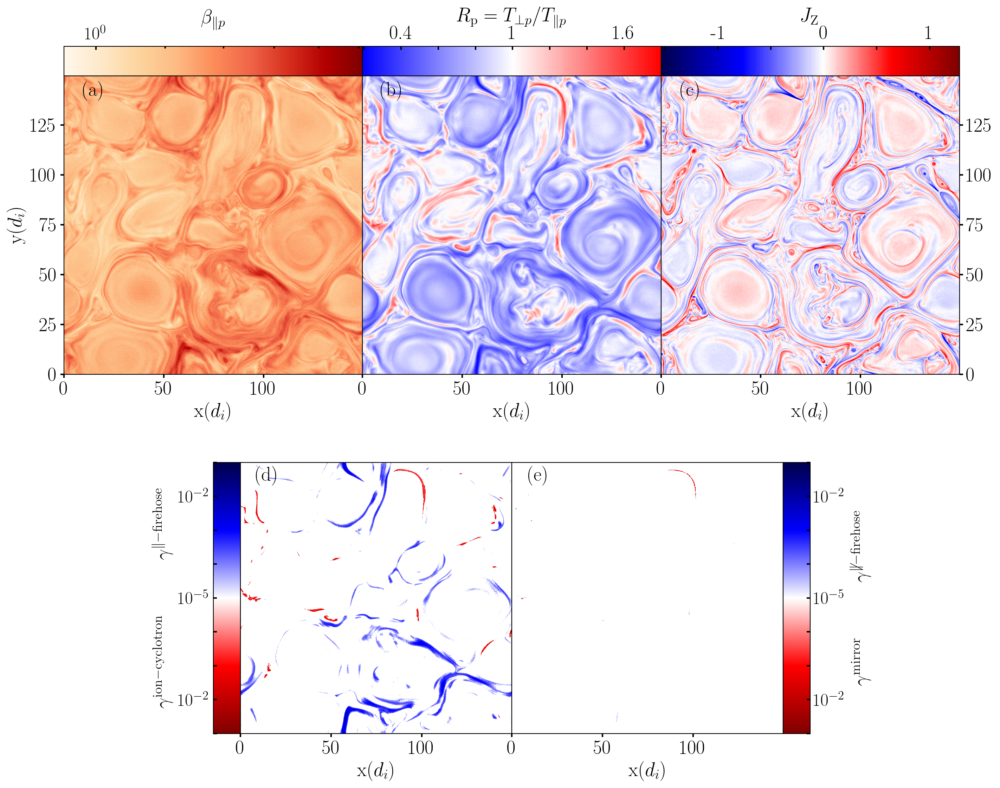

In [83]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              #'data_Rp_betap_jz_b_149p6.h5',
              #'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              #'data_Rp_betap_jz_b_149p6_k28.h5',
              #'data_Rp_betap_jz_b_149p6_lb.h5',
              #'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              #'gamma_k_149p6.h5',
              #'gamma_k_149p6_dzobe1.h5',
              'gamma_k_149p6_hb.h5',
              #'gamma_k_149p6_k28.h5',
              #'gamma_k_149p6_lb.h5',
              #'gamma_k_149p6_rs0.h5',
              'gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[0:1], gamma_file_list[0:1] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp']

	    # Beta values

        bp = data['betap']

        # Magnetic field components

        b_x = data['bx'][:,:,0]
        b_y = data['by'][:,:,0]
        b_z = data['bz'][:,:,0]

        # z-component of the current

        #j_z = data_jz_b['jz'][:,:,0]

        j_z = data['jz'][:,:,0]

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        b_x_mat = np.asmatrix( b_x )
        b_y_mat = np.asmatrix( b_y )
        b_z_mat = np.asmatrix( b_z )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        # Change matrices to a 1d-array

        b_arr = b_mat.getA1( )

        r_arr = r_mat.getA1( )

        # Concatenate the anisotropy and beta arrays

        b_total = np.concatenate( ( b_total, b_arr ), axis=0 )
        r_total = np.concatenate( ( r_total, r_arr ), axis=0 )

        #om = om_mat.getA1()

        b_x_arr_arr = b_x_mat.getA1( )
        b_y_arr_arr = b_y_mat.getA1( )
        b_z_arr_arr = b_z_mat.getA1( )

        j_z_arr = j_mat.getA1( )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18

    fig = plt.figure( num=None, figsize=( 13, 11 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.95, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out', labelright=True, right=True, 
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.95, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out', labelright=True, right=True, labelleft=False, left=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.95, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', top=True, bottom=False, width=1.5, labelsize=labelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=labelsize )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.95, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("left", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_yticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='y', direction='in', labelleft=True, 
    labelright=False, color='k', left=True, right=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.yaxis.set_label_position('left')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_xlabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_ylabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )
    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.95, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("right", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_yticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='y', direction='in', labelright=True, 
    labelleft=False, color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.yaxis.set_label_position('right')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose',
    #                    x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_ylabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    #clabels2 = [ xx for xx in cbar2.get_ticks() ]
    #clabels2[0] = ''
    #clabels2[2] = ''
    #clabels2[4] = ''
    #clabels2[6] = ''
    #cbar2.ax.set_ticklabels(clabels2)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

#### kaw

In [82]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              #'data_Rp_betap_jz_b_149p6.h5',
              #'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              #'data_Rp_betap_jz_b_149p6_k28.h5',
              #'data_Rp_betap_jz_b_149p6_lb.h5',
              #'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              #'gamma_k_149p6.h5',
              #'gamma_k_149p6_dzobe1.h5',
              'gamma_k_149p6_hb.h5',
              #'gamma_k_149p6_k28.h5',
              #'gamma_k_149p6_lb.h5',
              #'gamma_k_149p6_rs0.h5',
              'gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[1:2], gamma_file_list[1:2] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp']

	    # Beta values

        bp = data['betap']

        # Magnetic field components

        b_x = data['bx'][:,:,0]
        b_y = data['by'][:,:,0]
        b_z = data['bz'][:,:,0]

        # z-component of the current

        #j_z = data_jz_b['jz'][:,:,0]

        j_z = data['jz'][:,:,0]

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        b_x_mat = np.asmatrix( b_x )
        b_y_mat = np.asmatrix( b_y )
        b_z_mat = np.asmatrix( b_z )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        # Change matrices to a 1d-array

        b_arr = b_mat.getA1( )

        r_arr = r_mat.getA1( )

        # Concatenate the anisotropy and beta arrays

        b_total = np.concatenate( ( b_total, b_arr ), axis=0 )
        r_total = np.concatenate( ( r_total, r_arr ), axis=0 )

        #om = om_mat.getA1()

        b_x_arr_arr = b_x_mat.getA1( )
        b_y_arr_arr = b_y_mat.getA1( )
        b_z_arr_arr = b_z_mat.getA1( )

        j_z_arr = j_mat.getA1( )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18

    fig = plt.figure( num=None, figsize=( 13, 5 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.9, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out', labelright=True, right=True, 
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.9, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out', labelright=True, right=True, labelleft=False, left=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.9, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', top=True, bottom=False, width=1.5, labelsize=labelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=labelsize )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.9, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("top", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='x', direction='in', labeltop=True, labelbottom=False, 
    color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.xaxis.set_label_position('top')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_xlabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_xlabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=0 )
    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.9, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("top", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_xticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='x', direction='in', labeltop=True, labelbottom=False, 
    color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.xaxis.set_label_position('top')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose',
    #                    x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_xlabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=0 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    #clabels2 = [ xx for xx in cbar2.get_ticks() ]
    #clabels2[0] = ''
    #clabels2[2] = ''
    #clabels2[4] = ''
    #clabels2[6] = ''
    #cbar2.ax.set_ticklabels(clabels2)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

CPU times: user 16.3 s, sys: 7.51 s, total: 23.8 s
Wall time: 15.4 s


In [ ]:
pad = 0.02

for i in range(1) :
    fig = plt.figure( num=None, figsize=( 15, 45 ), dpi=200, facecolor='w',
                                                              edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.02, hspace=0. )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    axs1 = fig.add_subplot( 1, 5, 1 )

    # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=20 )

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=10, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=10, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=20 )
    plt.savefig('test.pdf')

In [ ]:
%%time

for ( xx, yy ) in zip( data_file, gamma_file ) :

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    fig = plt.figure( num=None, figsize=( 15, 45 ), dpi=200, facecolor='w',
                                                              edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.02, hspace=0. )

    extent=[0, 149.6, 0, 149.6]
    
    # Define the axes in the figure

    axs1 = fig.add_subplot( 1, 5, 1 )

    # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

    #axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=20 )

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=0.05 )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    cbar1.ax.tick_params( which='both', direction='in',
    labeltop=False, top=True, labelbottom=False, bottom=False,width=1.5,
    labelsize=20, labelrotation=0 )
    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar1.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=20 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot( 1, 5, 2 )

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=np.amin( r_mat ), vmax=np.amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

   #labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
   #print( [ item.get_text() for item in axs1.get_xticklabels() ] )
   #labels2[0] = ''

   #axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=0.05 )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.25', '', '', '1.0', '', '', '', '2.0' ]

	#cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=18 )
 
    cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=20 )

    # Figure 3

    axs3 = fig.add_subplot( 1, 5, 3 )

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=0.05 )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '', '-1', '', '0', '', '1', '' ]
    #cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=12 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='b', top=True, bottom=False )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=20 )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot( 1, 5, 4 )
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("top", size="10%", pad=0.05 )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0.1 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=18  )
#   cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='c', top=True, bottom=False )

    # Define the position of colorbar label and plot the label

    cbar4.ax.xaxis.set_label_position('top')

    cbar4.ax.set_xlabel( 'Ion-Cyclotron       Firehose',
    x= 0.5, weight=None, fontsize=16 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot( 1, 5, 5 )

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("top", size="10%", pad=0.05 )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0.1 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_xticklabels( lbl5, rotation=0, fontsize=18  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='c', top=True, bottom=False )

    # Define the position of colorbar label and plot the label

    cbar5.ax.xaxis.set_label_position('top')

    cbar5.ax.set_xlabel( 'Mirror        Firehose',
                        x= 0.5, weight=None, fontsize=16 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'mms/mms_fest/figures/thesis/{xx[48:-3]}_{yy[45:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = 0.05 )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )

    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = 0.05 )

### 3-D case

In [ ]:
%%time

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = ['3Ddata_Rp_betap_b_yan512.h5']

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = ['gamma_k_yan_512.h5']

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

j_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
j_files = ['3Ddata_j_yan512.h5']
j_file_list = [j_dir + xx for xx in j_files]

data = hf.File( data_file_list[0], 'r+' )
gamma = hf.File( gamma_file_list[0], 'r+' )
j = hf.File( j_file_list[0], 'r+' )

In [ ]:
data.keys(), gamma.keys(), j.keys()

(<KeysViewHDF5 ['Rp', 'betap', 'bx', 'by', 'bz']>,
 <KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>,
 <KeysViewHDF5 ['jx', 'jy', 'jz']>)

In [ ]:
np.shape(data['bx'][:,:,0])

(512, 512)

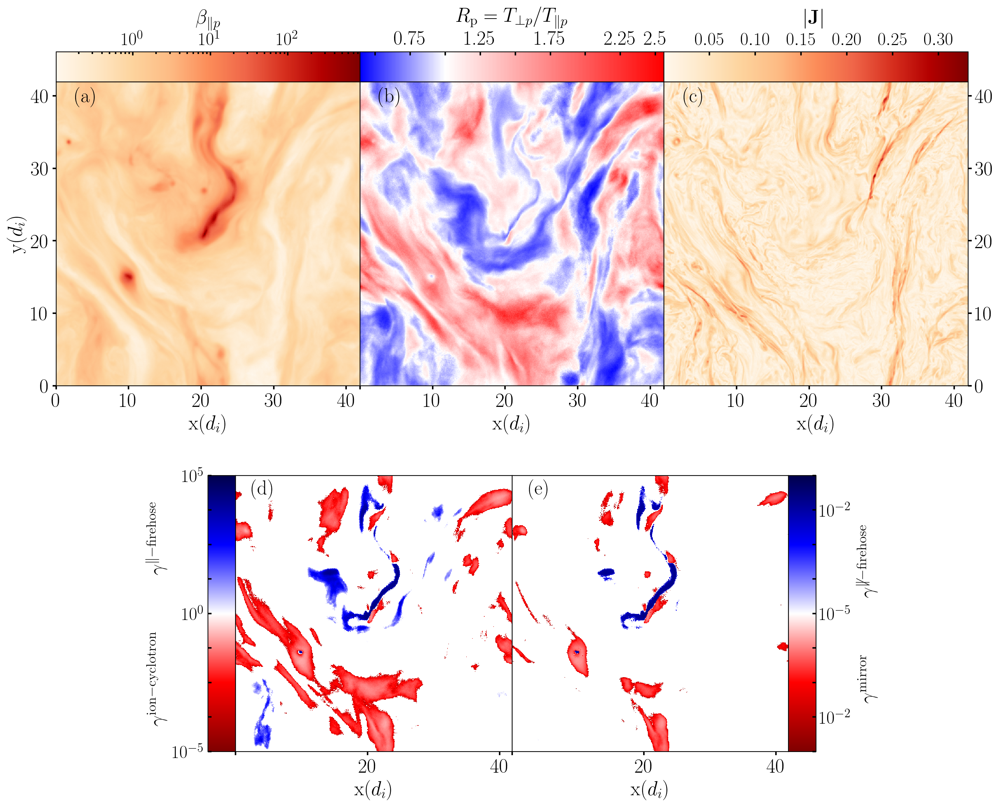

CPU times: user 12.7 s, sys: 6.1 s, total: 18.8 s
Wall time: 12.2 s


In [123]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = ['3Ddata_Rp_betap_b_yan512.h5']

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = ['gamma_k_yan_512.h5']

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

j_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
j_files = ['3Ddata_j_yan512.h5']
j_file_list = [j_dir + xx for xx in j_files]

r_total = []
b_total = []
j_total = []
n_pln = 0

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[0:1], gamma_file_list[0:1] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )
        j = hf.File( j_file_list[0], 'r+' )

        print(data.keys())
        print(gamma.keys())
        print(j.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp'][:,:,n_pln]

	    # Beta values

        bp = data['betap'][:,:,n_pln]

        # magnitude of the current
        j_z = np.sqrt(j['jx'][:,:,n_pln]**2 + j['jy'][:,:,n_pln]**2 + j['jz'][:,:,n_pln]**2)

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ][:,:,n_pln]
        b_par = gamma[ key[1] ][:,:,n_pln]
        a_per = gamma[ key[2] ][:,:,n_pln]
        b_per = gamma[ key[3] ][:,:,n_pln]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        #g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        #g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        #g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        #g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        #g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        #g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        #g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        #g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18
    labelpad = 9

    fig = plt.figure( num=None, figsize=( 13, 11 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 41.9, 0, 41.9]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.95, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)
    
    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize, labelpad=labelpad )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.95, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    #cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize, labelpad=labelpad )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
    #norm=mpl.colors.Normalize( vmin=np.nanmin( j_mat ), vmax=np.nanmax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), np.amax( j_mat )/2. ) )

    im3.axes.tick_params( which='both', direction='out', right=True, labelright=True, left=False, labelleft=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.95, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    #cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', width=1.5, top=True, bottom=False, labelsize=clabelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$|\mathbf{J}|$', fontsize=labelsize, labelpad=labelpad )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.95, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("left", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='y', direction='in', labelleft=True, 
    labelright=False, color='k', left=True, right=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.yaxis.set_label_position('left')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_ylabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose',
    #y= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_ylabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.95, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("right", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_yticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='y', direction='in', labelright=True, 
    labelleft=False, color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.yaxis.set_label_position('right')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_ylabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    clabels2 = [ xx for xx in cbar2.get_ticks() ]
    clabels2[0] = ''
    clabels2[2] = ''
    clabels2[4] = ''
    clabels2[6] = ''
    cbar2.ax.set_xticklabels(clabels2)

    #clabels3 = [ xx for xx in cbar3.get_ticks() ]
    #clabels3[0] = ''
    #clabels3[2] = ''
    #clabels3[4] = ''
    #clabels3[6] = ''
    #cbar3.ax.set_xticklabels(clabels3)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

In [119]:
np.nanmin(j_mat), np.nanmax(j_mat)

(0.00043573555327575667, 0.33204823841840736)

In [109]:
jj = np.sqrt(j['jx'][:,:,0]**2 + j['jy'][:,:,0]**2 + j['jz'][:,:,0]**2)
jj


array([[0.01061724, 0.01098432, 0.0092352 , ..., 0.01260868, 0.00922457,
        0.01044079],
       [0.01179518, 0.01797126, 0.00786902, ..., 0.01582616, 0.01216723,
        0.00906265],
       [0.01448083, 0.02544452, 0.02025435, ..., 0.01725093, 0.01681726,
        0.02096249],
       ...,
       [0.04332447, 0.04445131, 0.04090009, ..., 0.04279002, 0.04084405,
        0.04119287],
       [0.02738337, 0.03834694, 0.03478813, ..., 0.03830403, 0.02963353,
        0.02815237],
       [0.0138811 , 0.01671319, 0.01159193, ..., 0.01900282, 0.00924037,
        0.01018969]])

In [110]:
np.nanmin(jj), np.nanmax(jj)

(0.00043573555327575667, 0.33204823841840736)

#Brazil plotting and threshold function

## Threshold function

In [ ]:
################################################################################

def get_thresh(instab, gamma, verbose=False, parnt_drct=None, drct=None, res='hi-res') :

    # Open the appropriate data files for the requested instability.  If a
    # valid instability was not specified, abort. 

    if (parnt_drct is None) :
        parnt_drct='/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/' +\
                    'data/all_instabilities_ben/out/protn'

    if instab in ['fir1', 'fir2'] :
        ohalf = -1
    elif instab in ['cycl', 'mirr'] :
        ohalf = +1
    else :
        return np.array( [ ] ), np.array( [ ] )

    if drct is None :
        if instab in ['mirr', 'fir2'] :
            drct = '0.001_4.000_0.000'
        elif instab in ['cycl', 'fir1'] :
            drct = '0.001_4.000_0.000_00.00'

    if instab in ['mirr', 'fir2'] and res=='lo-res':
        res = 'hi-res'
        new_drct = f'/content/gdrive/Shareddrives/Shadowfax/GIT/SpacePlasFest/qudsi/mms_fest/' +\
        f'thresh/ean/out/protn/{instab}/0.001_4.000_0.000/{res}/'
    else :
        new_drct = f'{parnt_drct}/{instab}/{drct}/{res}/'

    fl_b = open(new_drct + 'out_bj.dat' )
    fl_r = open(new_drct + 'out_ri.dat' )
    fl_g = open(new_drct + 'out_gij.dat')

    # Extract the values in the files.

    arr_b = np.array( [ [ float( val ) for val in ln.split( ) ] for ln in fl_b ] )
    arr_r = np.array( [ [ float( val ) for val in ln.split( ) ] for ln in fl_r ] )
    arr_g = np.array( [ [ float( val ) for val in ln.split( ) ] for ln in fl_g ] )

    ( n_r, n_b ) = arr_g.shape

    # If requested, print out the shape of the arrays.

    if ( verbose ) :
        plt.contour( arr_b, arr_r, arr_g )
        plt.show( )

    # Initialize the threshold arrays.

    crv_b = arr_b[0,:]
    crv_r = np.zeros_like( crv_b )

    # Extract the requested threshold level. For each beta-value, use
    # interpolation to estimate the anisotropy-value that has a gamma
    # value closest to the target "gamma".

    for j in np.arange( n_b ) :

        # If the target value "gamma" does not fall into the range of
        # gamma-values returned for this beta-value, skip to the next
        # beta-value.

        if ( ( np.amin( arr_g[:,j] ) >= gamma ) or
             ( np.amax( arr_g[:,j] ) <= gamma )    ) :

            continue

        # Search through the anisotropy-values (beginning with R = 1)
        # until one is found with a gamma-value less than the target
        # "gamma" and that is followed by an anisotropy-value with a
        # gamma-value greater than the target "gamma".

        # Note.  The "for"-statement immediately below may seem a bit
        #        odd, but it does work.  The "[::ohalf]" ensures that
        #        the loop begins with R = 1 and moves outward.  The
        #        "[:-1]" remove supresses the final anisotropy value.

        for i in np.arange( n_r )[::ohalf][:-1] :


            # If the gamma-value of the current anisotropy-value is
            # less than the target "gamma" and the gamma-value of
            # the next anisotropy-value is greater than the target
            # "gamma", interpolate between them.

            if ( ( arr_g[i      ,j] >  0.    ) and
                 ( arr_g[i      ,j] <= gamma ) and
                 ( arr_g[i+ohalf,j] >= gamma )     ) :
            
                #print(i,j)

                # Extract the bounding anisotropy-values and the
                # logs of their corresponding gamma-values.

                r1 = arr_r[i      ,j]
                r2 = arr_r[i+ohalf,j]

                l1 = np.log10( arr_g[i      ,j] )
                l2 = np.log10( arr_g[i+ohalf,j] )

                # Store the interpolated value to the threshold
                # array.

                crv_r[j] = ( ( np.log10( gamma ) - l1 ) * ( r2 - r1 ) / ( l2 - l1 ) ) + r1

                # If requested, print out the interpolation
                # values.

                # Move on to the next beta-value.

                break

    # Remove elements from the threshold arrays corresponding to beta-values
    # for which no anisotropy-value could be found.

    tk = np.where( crv_r != 0 )

    crv_b = crv_b[tk]
    crv_r = crv_r[tk]

#    print min(crv_b), max( crv_b), min(crv_r), max(crv_r)
    # Return the threshold arrays.

    return crv_b, crv_r

## Functional form for threshold function plot

In [ ]:
# Threshold calculation based on Verscharen and Chandran 2018
def compute_rr(bb=None, gamma=-2, instab='cycl') :

    if (instab=='cycl') :
        if (gamma==-2) :
            a= 0.649
            b= 0.400
            c= 0
        elif (gamma==-3) :
            a = 0.437
            b = 0.428
            c = -0.003
        elif (gamma==-4) :
            a = 0.367
            b = 0.364
            c = 0.011
        else :
            print(r'Only values of $\gamma/\Omega$ = -2, -3 and -4 are supported')
    elif (instab=='mirr') :
        if (gamma==-2) :
            a= 1.040
            b= 0.633
            c= -0.012
        elif (gamma==-3) :
            a = 0.801
            b = 0.763
            c = -0.063
        elif (gamma==-4) :
            a = 0.702
            b = 0.674
            c = -0.009
        else :
            print(r'Only values of $\gamma/\Omega$ = -2, -3 and -4 are supported')
    elif (instab=='fir1') :
        if (gamma==-2) :
            a= -0.647
            b= 0.583
            c= 0.713
        elif (gamma==-3) :
            a = -0.497
            b = 0.566
            c = 0.543
        elif (gamma==-4) :
            a = -0.408
            b = 0.529
            c = 0.410
        else :
            print(r'Only values of $\gamma/\Omega$ = -2, -3 and -4 are supported')
    elif (instab=='fir2') :
        if (gamma==-2) :
            a= -1.447
            b= 1.000
            c= -0.148
        elif (gamma==-3) :
            a = -1.390
            b = 1.005
            c = -0.111
        elif (gamma==-4) :
            a = -1.454
            b = 1.023
            c = -0.178
        else :
            print(r'Only values of $\gamma/\Omega$ = -2, -3 and -4 are supported')        

    return 1 + a/((bb -c)**b)

In [ ]:
xmin = 1e-1
xmax = 100
bb = np.logspace(np.log10(xmin), np.log10(xmax), 100)
#rr = np.logspace(ymin, ymax, 100)
rr_cycl = compute_rr(bb=bb, gamma=-2, instab='cycl')
#rr_mirr = compute_rr(bb=bb, gamma=-2, instab='mirr')
#rr_fir1 = compute_rr(bb=bb, gamma=-2, instab='fir1')
#rr_fir2 = compute_rr(bb=bb, gamma=-2, instab='fir2')
    
plt.plot(bb, rr_cycl, color='k', ls=':', lw=1.5)
#axs1.plot(bb, rr_mirr, color='m', ls='.', lw=1.5)
#axs1.plot(bb, rr_fir1, color='orange', ls='.', lw=1.5)
#axs1.plot(bb, rr_fir2, color='r', ls='.', lw=1.5)

In [ ]:
def brazil_plots(bp, rp, xmin=None, xmax=None, ymin=None, ymax=None, bins=None, nbins=None,
                 cmin=None, norm=None, cmap=None, vmin=None, vmax=None, g_lim_1=None, g_lim_2=None,
                 g_lim_3=None, g_lim_4=None, dir_par=None, dir_per=None, res='hi-res', loc=1,
                 sim=None, density=False, plot_thresh=False, plot_ver_thresh=None, save_fig=True,
                 plot_show=False) :

    """
    The code to plot the brazil plot for any kind of data. The scale of both x- and y-axes is 'log',
    this can be changed in the line which 65 or so where 'bins' is defined and setting both scales
    of x- and y-axes to linear instead of log.

    bp : ion parallel beta (type:array)
    rp : ion anisotropy (type:array)
    xmin : minimum value of x-axis (type:float)
    xmax : maximum value of x-axis (type:float)
    ymin : minimum value of y-axis (type:float)
    ymax : maximum value of y-axis (type:float)
    bins : x and y bins (type:array)
    nbins : number of bins in each direction, defaults to 50 (type:float)
    cmin : minimum value in a bin to be plotted, defaults to 10 (type:float)
    norm : norm of the mpl.colors.LogNorm() (default value)
    cmap : colormap, defaults to plt.cm.Blues
    vmin : minimum value of colorbar
    vmax : maximum value fo colorbar
    g_lim_1 to 4 : value of instability thresholds to be plotted
        1 => cyclotron instability
        2 => parallel firehose instability
        3 => mirror instability
        4 => oblique firehose instability
    dir_par : directory for parallel instabilities
    dir_per : directory for oblique instabilities
    res : resolution of thresholds to be plotted, defaults to 'hi-res', other option is 'lo-res'
    loc : location of legend
    sim : type of data, this is used while saving figure
    density : whether to plot probabilty density or somple histogram, defaults to false
    plot_thresh : whether to plot thresholds, defaults to false
    save_fig : to save the figure or not, defaults to true
    plot_show : display the plot, defaults to false
    """
    
    # Define all the default values
    pad = 0.02
    clabelpad = 10
    labelsize = 18
    ticklabelsize = 15
    cticklabelsize = 15
    clabelsize = 15
    ticklength = 3
    tickwidth = 1.5
    ticklength = 6
    mticklength = 4
    cticklength = 5
    mcticklength = 4
    labelrotation = 0

    # Extract the data
    # Anisotropy
    rp_arr = np.array(rp)

    # Beta values
    bp_arr = np.array(bp)

    if bins is None :
        if (nbins is None):
            nbins = 50
        bins = (np.logspace(np.log10(np.nanmin(bp_arr)), np.log10(np.nanmax(bp_arr)),nbins),
                np.logspace(np.log10(np.nanmin(rp_arr)), np.log10(np.nanmax(rp_arr)),nbins))

    if cmap is None :
        cmap = plt.cm.Blues

    if cmin is None :
        cmin = 10

    ( hist, ex, ey, f ) = plt.hist2d(bp_arr , rp_arr, bins=bins, cmin=cmin, norm=norm, cmap=cmap)
    plt.close('all')

    if(density==True) :
        n_hist = np.full((np.shape(hist)), np.nan)
        N = np.nansum(hist)

        for xx in np.arange(len(ex) - 1):
            for yy in np.arange(len(ey) - 1):
                db = ex[xx+1] - ex[xx]
                dr = ey[yy+1] - ey[yy]
                n_hist[xx,yy] = hist[xx,yy]/(N * db * dr)
        hist = []
    else :
        n_hist = hist

    if None in [vmin, vmax] :
        vmin = np.nanmin(n_hist)
        vmax = np.nanmax(n_hist)

    if None in [xmin, xmax, ymin, ymax] :
        xmin = 0.9*ex[0]
        xmax = 1.2*ex[-1]
        ymin = 0.8*ey[0]
        ymax = 1.2*ey[-1]

    if norm is None :
        norm = mpl.colors.LogNorm(vmin, vmax)

    # Define the figure
    fig = plt.figure(num=None, figsize=( 5, 6 ), dpi=200, facecolor='w', edgecolor='gray')
    fig.subplots_adjust(left=0.01, right=0.95, top=0.99, bottom=0.01, wspace=0.02, hspace=0.)

    # Define the axes in the figure
    axs1 = fig.add_subplot( 1, 1, 1 )

    im1 = axs1.pcolormesh( ex, ey, np.transpose(n_hist), alpha=0.9, vmin=vmin, vmax=vmax,
                          shading='auto', cmap=cmap, norm=norm)

    axs1.axhline( 1, lw=1.0, c='k' )

    im1.axes.tick_params(which='major', axis='both', direction='in', labelbottom=True, bottom=True,
                         labeltop=False, top=True, labelleft=True, left=True, labelright=False,
                         right=True, width=tickwidth, length=ticklength, labelsize=ticklabelsize,
                         labelrotation=labelrotation)
    im1.axes.tick_params(which='minor', axis='both', direction='in', labelbottom=False, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=mticklength,
                         labelsize=ticklabelsize, labelrotation=labelrotation)

    axs_xlabel = r'$\beta_{\parallel \mathrm{p}} = 2 \mu_0 n_\mathrm{p} k_\mathrm{B}$' +\
                 r'$T_{\parallel \mathrm{p}}/B^2$'

    axs_ylabel = r'$R_{\mathrm{p}} = T_{\perp \mathrm{p}}/T_{\parallel \mathrm{p}}$'

    axs1.set_xlabel(axs_xlabel, fontsize=labelsize)
    axs1.set_ylabel(axs_ylabel, fontsize=labelsize)

    axs1.set_xlim(xmin, xmax)
    axs1.set_ylim(ymin, ymax)
    axs1.set_xscale('log')
    axs1.set_yscale('log')

    # Create a new axis for colorbar
    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure and the padding
    # between the colorbar and the figure, the orientation the colorbar
    cax1 = divider1.append_axes("top", size="5%", pad=0.01 )
    cbar1 = plt.colorbar(im1, cax=cax1, orientation='horizontal', ticks=None, fraction=0.05,
                         pad=0.01)
    
    # Define the parameters related to the label of tickmarks and their relative positioning, color
    # of the tickmarks, and where they appear on the colorbar
    cax1.axes.tick_params(which='major', axis='x', direction='in', pad=0, labeltop=True,
                         labelbottom=False, top=True, bottom=True, length=cticklength,
                         labelsize=clabelsize, color='k')
    cax1.axes.tick_params(which='minor', axis='x', direction='in', pad=0, labeltop=False,
                         labelbottom=False, top=True, bottom=True, length=mcticklength,
                         labelsize=clabelsize, color='k')

    cbar1.ax.xaxis.set_label_position('top')

    if (density==True) :
        #cbar_label = r'$\tilde{p}( \beta_{\parallel \mathrm{p}}, R_\mathrm{p}) = n/$' +\
        #             r'$( N \Delta \beta_{\parallel \mathrm{p}} \Delta R_\mathrm{p} )$'
        cbar_label = 'Probability Density'
    else :
        cbar_label = r'$N$'

    cbar1.set_label(cbar_label, fontsize=labelsize, labelpad=clabelpad)

    if (plot_thresh==True) :
        if None in [g_lim_1, g_lim_2, g_lim_3, g_lim_4] :
            g_lim_1 = 2
            g_lim_2 = 2
            g_lim_3 = 2
            g_lim_4 = 2

        if None in [dir_par, dir_per] :
            dir_par = '0.001_4.000_0.000_00.00'
            dir_per = '0.001_4.000_0.000'

        crv_b_1, crv_r_1 = get_thresh('cycl', 10**(-g_lim_1), drct=dir_par, res=res, verbose=False)
        axs1.plot(crv_b_1, crv_r_1, color='k', ls='dashdot', lw=1.5, label='cyclotron')
    
        crv_b_2, crv_r_2 = get_thresh('fir1', 10**(-g_lim_2), drct=dir_par, res=res, verbose=False)
        axs1.plot(crv_b_2, crv_r_2, color='orange', ls='dashed', lw=1.5, label='parallel firehose')

        crv_b_3, crv_r_3 = get_thresh('mirr', 10**(-g_lim_3), drct=dir_per, res=res, verbose=False)
        axs1.plot(crv_b_3, crv_r_3, color='m', ls='dashdot', lw=1.5, label='mirror')
    
        crv_b_4, crv_r_4 = get_thresh('fir2', 10**(-g_lim_4), drct=dir_per, res=res, verbose=False)
        axs1.plot(crv_b_4, crv_r_4, color='r', ls='dashed', lw=1.5, label='oblique firehose')

        # Set the label colors of legend label
        labelcolor=['k', 'orange', 'm', 'r']
        l = axs1.legend(fontsize=clabelsize, frameon=False, loc=loc)
        for i,text in enumerate(l.get_texts()):
            text.set_color(labelcolor[i])

        # Remove ther markers from legend
        for item in l.legendHandles:
            item.set_visible(False)

        axs1.text(0.98, 0.05, f'$\gamma/\Omega_{{cp}} = 10^{{{-g_lim_1}}}$', verticalalignment='center',
              horizontalalignment='right', fontsize=clabelsize, transform=axs1.transAxes)

    if (plot_ver_thresh==True) :
        bb = np.logspace(np.log10(xmin), np.log10(xmax), 100)
        #rr = np.logspace(ymin, ymax, 100)
        rr_cycl = compute_rr(bb=bb, gamma=-g_lim_1, instab='cycl')
        rr_mirr = compute_rr(bb=bb, gamma=-g_lim_1, instab='mirr')
        rr_fir1 = compute_rr(bb=bb, gamma=-g_lim_1, instab='fir1')
        rr_fir2 = compute_rr(bb=bb, gamma=-g_lim_1, instab='fir2')
    
        axs1.plot(bb, rr_cycl, color='k', ls='dashdot', lw=1.5, label='cyclotron')
        axs1.plot(bb, rr_fir1, color='orange', ls='dashed', lw=1.5, label='parallel firehose')
        axs1.plot(bb, rr_mirr, color='m', ls='dashdot', lw=1.5, label='mirror')
        axs1.plot(bb, rr_fir2, color='r', ls='dashed', lw=1.5, label='oblique firehose')

        # Set the label colors of legend label
        labelcolor=['k', 'orange', 'm', 'r']
        l = axs1.legend(fontsize=clabelsize, frameon=False, loc=loc)
        for i,text in enumerate(l.get_texts()):
            text.set_color(labelcolor[i])

        # Remove ther markers from legend
        for item in l.legendHandles:
            item.set_visible(False)

        axs1.text(0.98, 0.05, f'$\gamma/\Omega_{{cp}} = 10^{{{-g_lim_1}}}$', verticalalignment='center',
              horizontalalignment='right', fontsize=clabelsize, transform=axs1.transAxes)

    if (save_fig==True) :
        if(density==True):
            fig_name = f'figures/brazil_prob_{sim}.pdf'
        else :
            fig_name = f'figures/brazil_{sim}.pdf'
        plt.savefig( fig_name, bbox_inches='tight', pad_inches = 0.05, format='pdf', dpi=300)
    if (plot_show==True) :
        plt.show()
    plt.close('all')

    return (ex, ey, hist, n_hist)

In [ ]:
rr_cycl

## Plot the brazil plot using functional form

### All file names

In [ ]:
fn2dip   = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2dip/data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe_v001.p'
fn2dpp   = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2dpp/data_Rp_betap_jz_b_149p6_v001.p'
fn2d     = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2d/data_Rp_betap_jz_b_149p6_kaw_ti0p6te0p6_Time6000wpe_v001.p'
fn3d     = '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/3Ddata_Rp_betap_b_yan512_v001_rp_bp.p'
fnwnd    = 'data/all_wind_data_v06.p'
fnmms    = 'data/all_spc_20160111_20160124_20170118_20171226.p'
fnpsp    = 'data/psp_e1_gamma_omega_data.p'

In [ ]:
df = pd.read_pickle(fn2dip)
df.keys()

Index(['rp', 'bp', 'jz', 'bx', 'by', 'bz', 'a_par', 'b_par', 'a_per', 'b_per'], dtype='object')

#### 2dip

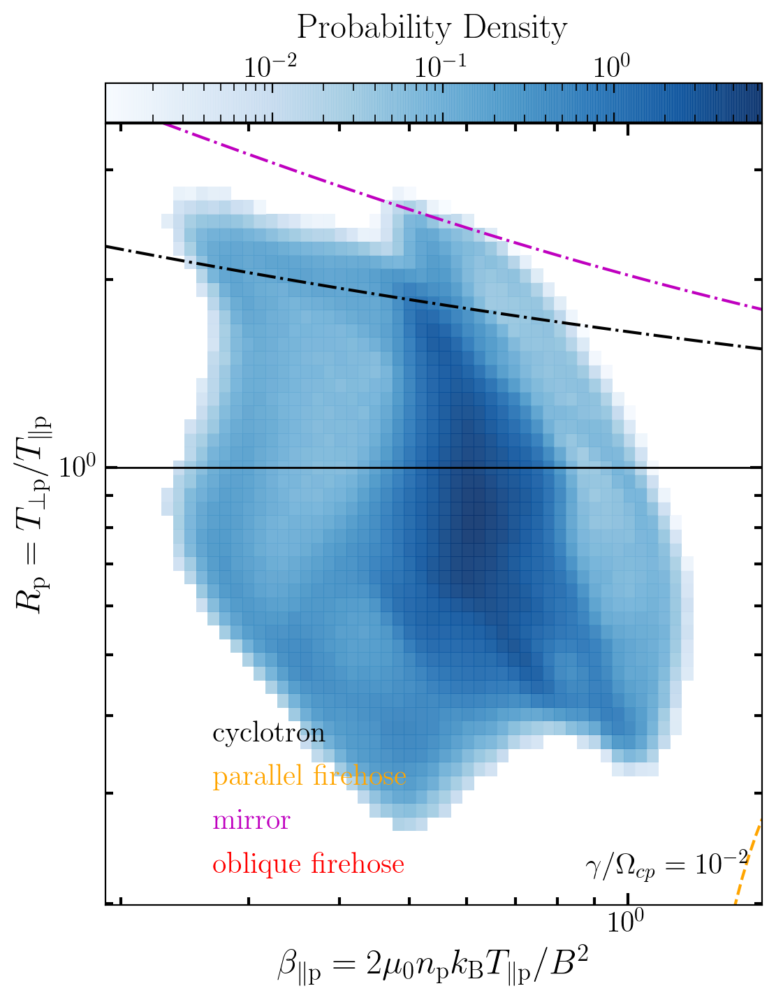

CPU times: user 5.15 s, sys: 2.08 s, total: 7.23 s
Wall time: 5.83 s


In [ ]:
%%time
df = pd.read_pickle(fn2dip)
ex, ey, hist, n_hist = brazil_plots(bp=df.bp, rp=df.rp, g_lim_1=2, g_lim_2=2, g_lim_3=2, g_lim_4=2,
                                    dir_par=None, dir_per=None, loc=3,
                                    sim='2dip', plot_show=True, density=True, plot_thresh=False,
                                    plot_ver_thresh=True, save_fig=True)

#### 2dpp

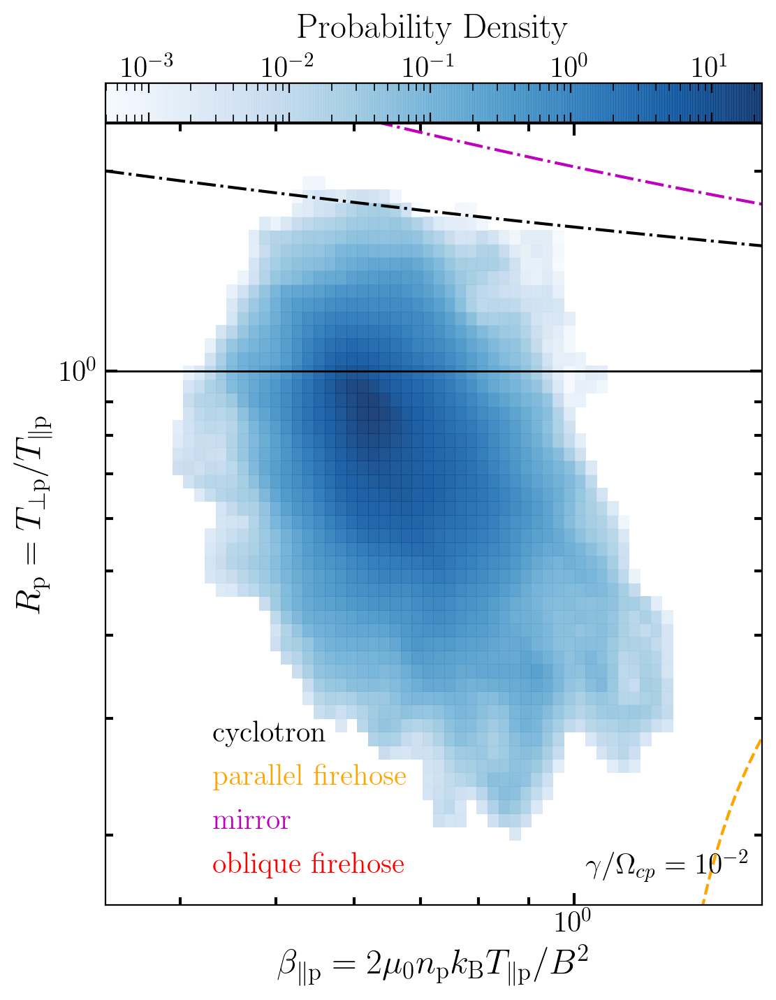

CPU times: user 10.3 s, sys: 2.93 s, total: 13.3 s
Wall time: 12.6 s


In [ ]:
%%time
df = pd.read_pickle(fn2dpp)
dir_par_list = [None]
dir_per_list = [None]
ex, ey, hist, n_hist = brazil_plots(bp=df.bp, rp=df.rp, g_lim_1=2, g_lim_2=2, g_lim_3=2, g_lim_4=2,
                                    dir_par=dir_par_list[0], dir_per=dir_per_list[0], res='hi-res', loc=3,
                                    sim='2dpp', plot_show=True, density=True, plot_thresh=False,
                                    plot_ver_thresh=True, save_fig=True)

#### 2d all

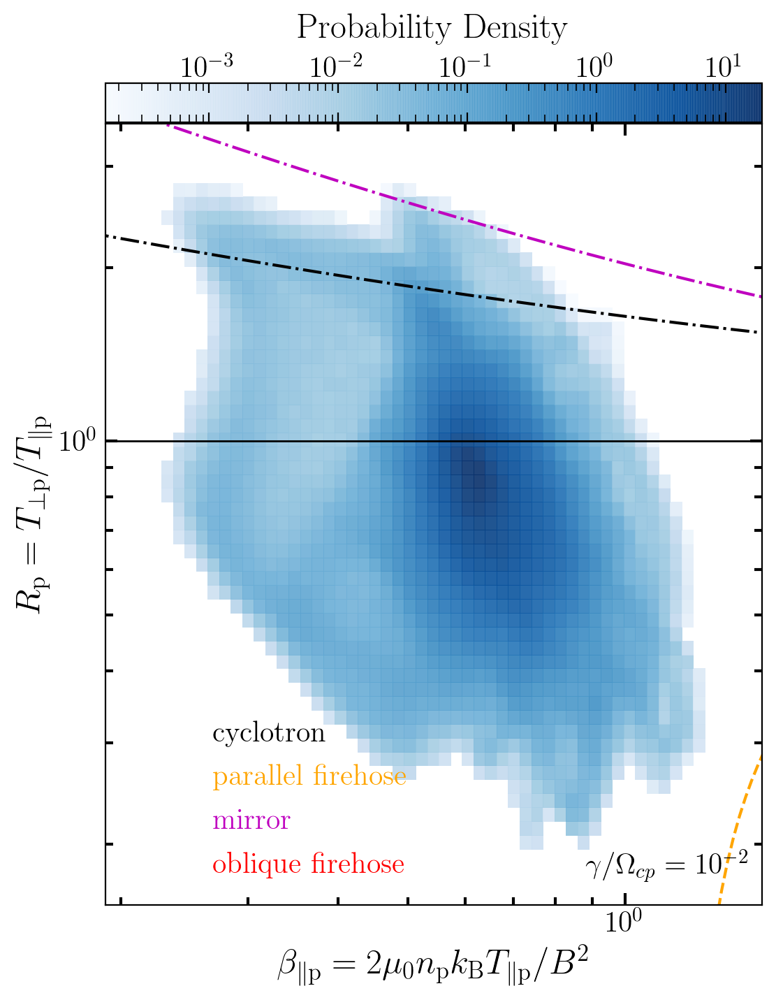

CPU times: user 13.6 s, sys: 4.44 s, total: 18 s
Wall time: 36 s


In [ ]:
%%time
df = pd.read_pickle(fn2d)
ex, ey, hist, n_hist = brazil_plots(bp=df.bp, rp=df.rp, g_lim_1=2, g_lim_2=2, g_lim_3=2, g_lim_4=2,
                                    dir_par=dir_par_list[0], dir_per=dir_per_list[0], res='hi-res',
                                    loc=3, sim='2d', plot_show=True, density=True, plot_thresh=True,
                                    save_fig=True)

#### 3d

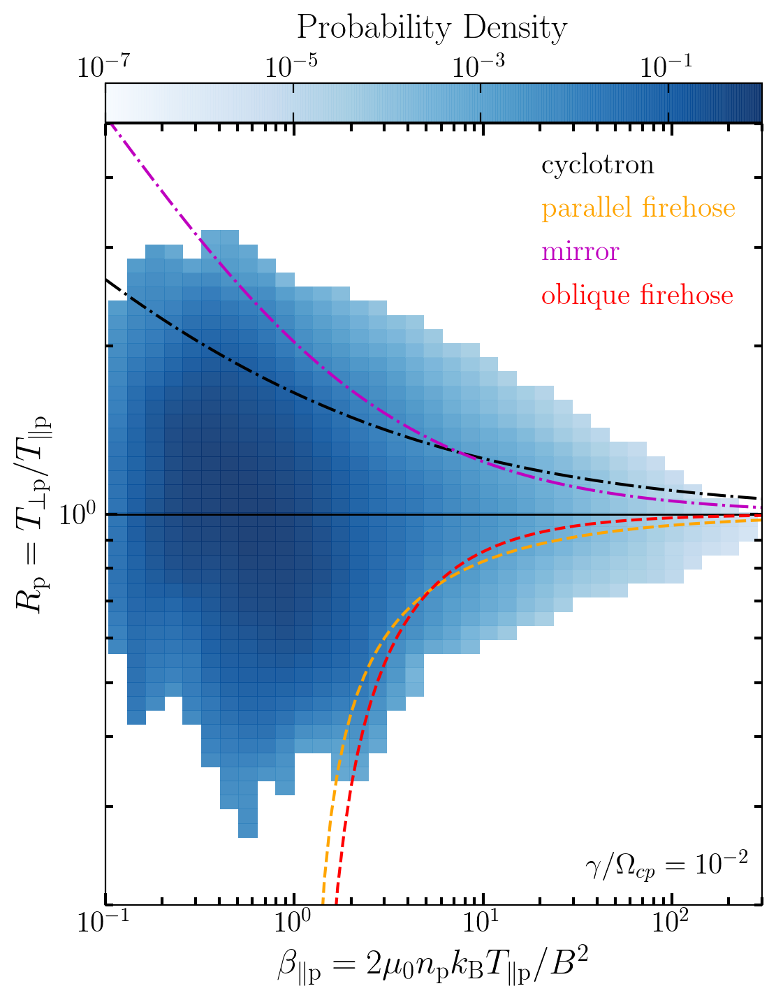

CPU times: user 11.8 s, sys: 5.31 s, total: 17.1 s
Wall time: 17 s


In [ ]:
%%time
df = pd.read_pickle(fn3d)
ex, ey, hist, n_hist = brazil_plots(bp=df.bp, rp=df.rp, xmin=0.1, xmax=3e2, ymin=0.2, ymax=5,
                                    cmin=1000, vmin=1e-7, vmax=1e0, g_lim_1=2, g_lim_2=2, g_lim_3=2,
                                    g_lim_4=2, dir_par=dir_par_list[0], dir_per=dir_per_list[0],
                                    res='lo-res', loc=1, sim='3d', plot_show=True, density=True,
                                    plot_thresh=False, plot_ver_thresh=True, save_fig=True)

In [ ]:
np.nanmax(hist)

#### Wind

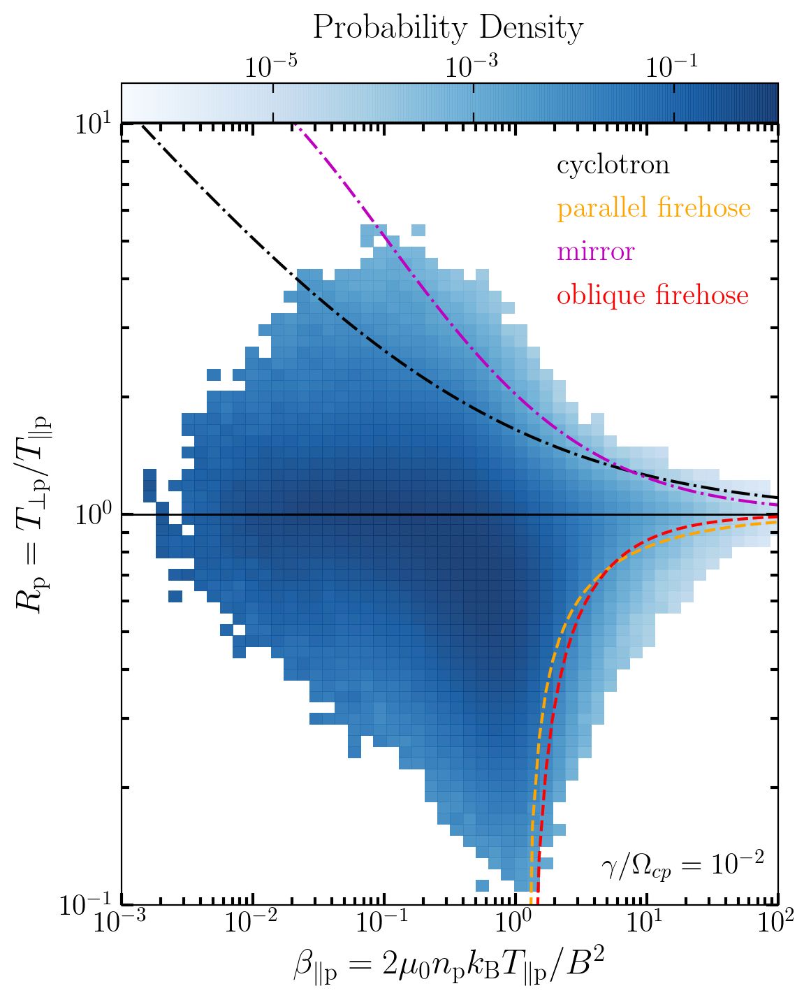

In [ ]:
dir_par_list = [None]
dir_per_list = [None]
df = pd.read_pickle(fnwnd)
ex, ey, hist, n_hist = brazil_plots(bp=df.beta_par_p, rp=df.r_p_x, xmin=1e-3, xmax=1e2, ymin=1e-1,
                                    ymax=1e1, g_lim_1=2, g_lim_2=2, g_lim_3=2, g_lim_4=2, nbins=100,
                                    dir_par=dir_par_list[0], dir_per=dir_per_list[0], res='hi-res',
                                    loc=1, plot_thresh=False, plot_ver_thresh=True, save_fig=True, sim='wnd',
                                    plot_show=True, density=True)

#### MMS

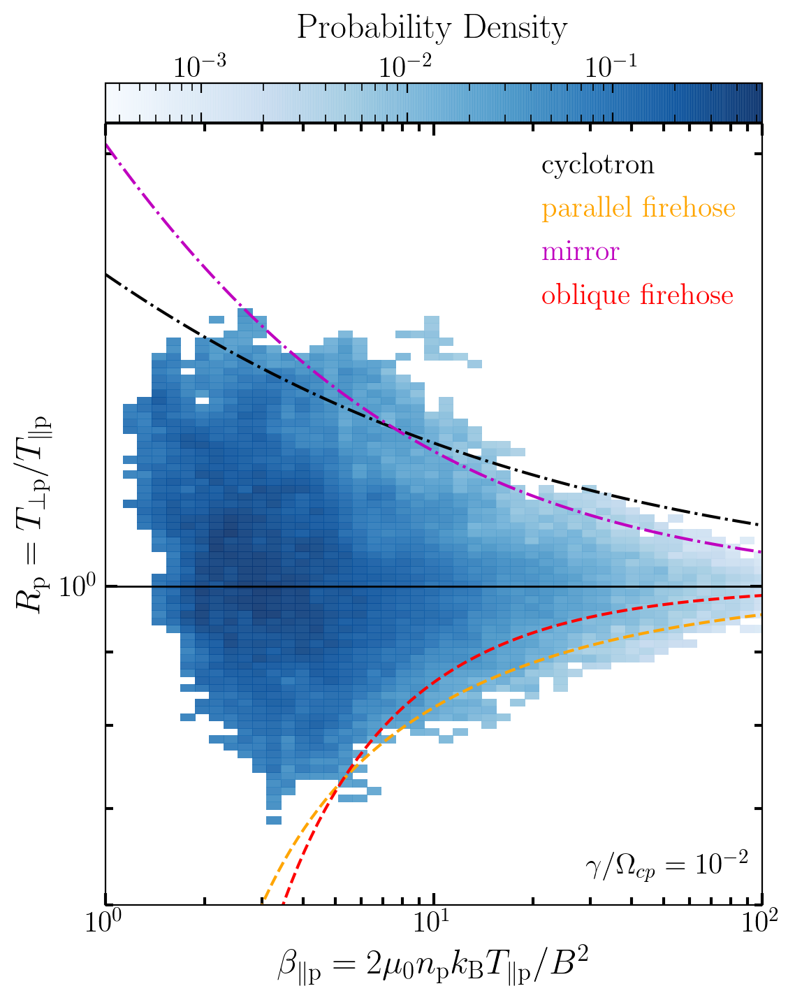

In [ ]:
dir_par_list = [None]
dir_per_list = [None]
df = pd.read_pickle(fnmms)
ex, ey, hist, n_hist = brazil_plots(bp=df.b_p, rp=df.r_p, xmin=1e0, xmax=1e2, ymin=6e-1,
                                    ymax=2.1e0, g_lim_1=2, g_lim_2=2, g_lim_3=2, g_lim_4=2, nbins=100,
                                    dir_par=dir_par_list[0], dir_per=dir_per_list[0], res='lo-res',
                                    loc=1, plot_thresh=False, plot_ver_thresh=True, save_fig=True, sim='mms',
                                    plot_show=True, density=True)

Index(['T_p', 'b_p', 'g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'j_mag',
       'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per', 'pvi', 'r_p', 'time',
       'omnl'],
      dtype='object')

#### PSP

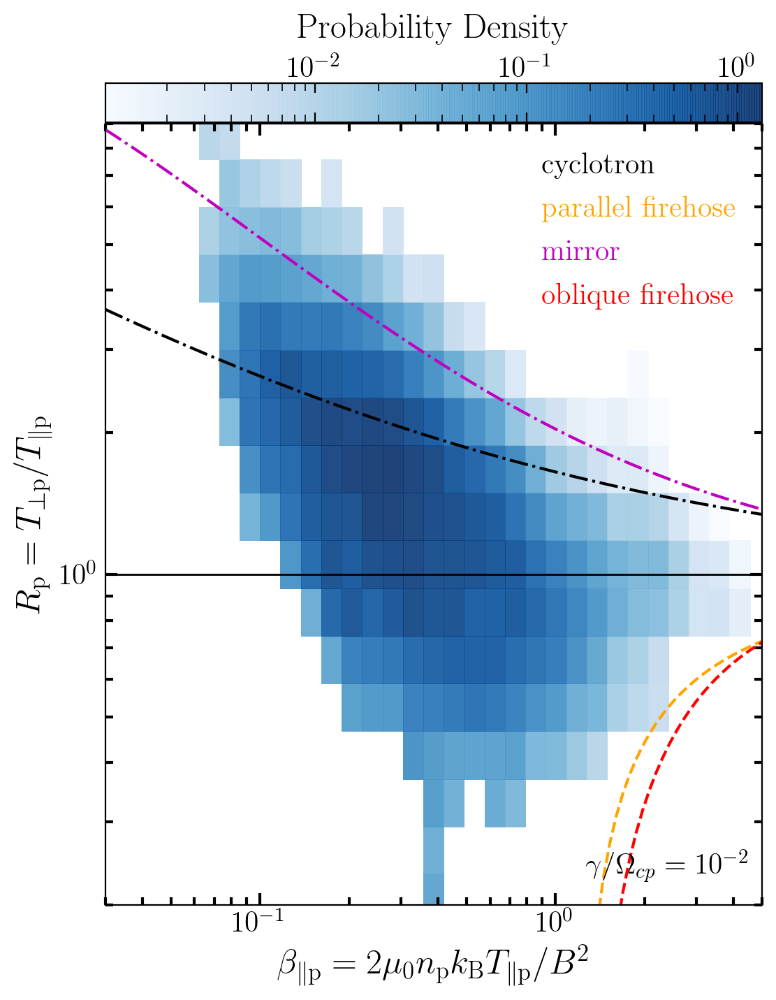

In [ ]:
df = pd.read_pickle(fnpsp)
ex, ey, hist, n_hist = brazil_plots(bp=df.betaparamom, rp=df.tanimom, xmin=3e-2, xmax=5e0,
                                    ymin=2.e-1, ymax=9e0, g_lim_1=2, g_lim_2=2, g_lim_3=2,
                                    g_lim_4=2, dir_par=dir_par_list[0], dir_per=dir_per_list[0],
                                    res='hi-res', loc=1, plot_thresh=False, save_fig=True, sim='psp',
                                    plot_show=True, plot_ver_thresh=True, density=True)

In [ ]:
df.keys()

Index(['betapara_core', 'betaparamom', 'tani_core', 'tanimom', 'time_series',
       'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per', 'k_a_par', 'k_b_par',
       'k_a_per', 'k_b_per', 'omnl', 'dl', 'di'],
      dtype='object')

# Function to calculate the PDF of various parameters

In [ ]:
def calc_pdf(series,weight=100,inc=None,Normalize=False):

	# find rms, create empty array of arrays for bins

	import numpy as np

	if inc is not None:

		series = (series-series.shift(inc))

	else:

		series=series.copy()

	#dropna and then sort the data from min to max, then reset the indices

	series.dropna(inplace=True)

	if Normalize :

		rmsval = series.std()

		series = series/rmsval

	# find the rms value of the series

	series.sort_values(inplace=True)

	series.reset_index(drop=True, inplace = True)

	length = int(len(series)/weight)

	pdf = np.zeros(length); bins=np.zeros(length)

	# For each bin, take the size, divide by the max-min of that bin, then add to pdf

	acc = 0

	for i in range(weight,len(series),weight):

		temp = series[i-weight:i]

		bins[acc] = temp.mean()

		pdf[acc]  = weight/(temp.max()-temp.min())

		acc += 1

	# return array of pdfs

	return bins,pdf/len(series)

def pdf_inc(series,inc,weight=100):

	tmp=(series.shift(-inc)-series).copy()

	return calc_pdf(tmp,weight)

In [ ]:
!pwd

/content


# Concatenate the two 2D arrays for in plane and out of plane simulations and plot one pdf etc for that case!

In [ ]:
df2d = pd.concat([df2dip, df2dpp])

In [ ]:
df2d.describe(), df2dip.describe(), df2dpp.describe()

(                 rp            bp  ...         a_per          b_per
 count  2.097152e+07  2.097152e+07  ...  83294.000000  262444.000000
 mean   8.550706e-01  6.490631e-01  ...      0.416767       0.553557
 std    2.474624e-01  8.980740e-02  ...      0.211800       0.338496
 min    1.963681e-01  2.116555e-01  ...      0.000010       0.000010
 25%    6.965534e-01  5.962740e-01  ...      0.381521       0.051961
 50%    8.353172e-01  6.359680e-01  ...      0.433357       0.730832
 75%    9.602586e-01  6.940790e-01  ...      0.594280       0.800987
 max    2.961548e+00  1.289388e+00  ...      0.849829       0.996793
 
 [8 rows x 10 columns],
                  rp            bp            jz  ...  b_par         a_per  b_per
 count  4.194304e+06  4.194304e+06  4.194304e+06  ...    0.0  39815.000000    0.0
 mean   9.663263e-01  6.166213e-01 -1.465492e-03  ...    NaN      0.506064    NaN
 std    3.832802e-01  1.147673e-01  1.202566e-01  ...    NaN      0.225389    NaN
 min    2.484468e-01  2.1

In [ ]:
len(df2dip.rp)+len(df2dpp.rp), len(df2d.rp)

(20971520, 20971520)

In [ ]:
%%time

# Compute the pdf of various quantities for the case when the mean magnetic 
# field is in plane

rp2dip_pdf = calc_pdf(df2dip.rp, 1000)
bp2dip_pdf = calc_pdf(df2dip.bp, 1000)
jz2dip_pdf = calc_pdf(df2dip.jz, 1000)

a_par2dip_pdf = calc_pdf(df2dip.a_par[df2dip.a_par<=1.e-1], 1000)
a_per2dip_pdf = calc_pdf(df2dip.a_per[df2dip.a_per<=1.e-1], 1000)
b_par2dip_pdf = calc_pdf(df2dip.b_par[df2dip.b_par<=1.e-1], 1000)
b_per2dip_pdf = calc_pdf(df2dip.b_per[df2dip.b_per<=1.e-1], 1000)


CPU times: user 6.07 s, sys: 32.3 ms, total: 6.1 s
Wall time: 6.1 s


In [ ]:
%%time

# Compute the pdf of various quantities for the case when the mean magnetic 
# field is out of the plane

rp2dpp_pdf = calc_pdf(df2dpp.rp, 1000)
bp2dpp_pdf = calc_pdf(df2dpp.bp, 1000)
jz2dpp_pdf = calc_pdf(df2dpp.jz, 1000)

a_par2dpp_pdf = calc_pdf(df2dpp.a_par[df2dpp.a_par<=1.e-1], 1000)
a_per2dpp_pdf = calc_pdf(df2dpp.a_per[df2dpp.a_per<=1.e-1], 1000)
b_par2dpp_pdf = calc_pdf(df2dpp.b_par[df2dpp.b_par<=1.e-1], 1000)
b_per2dpp_pdf = calc_pdf(df2dpp.b_per[df2dpp.b_per<=1.e-1], 1000)


CPU times: user 31.1 s, sys: 258 ms, total: 31.4 s
Wall time: 31.4 s


In [ ]:
%%time

# Compute the pdf of various quantities for the case where the two 2D data are 
# merged together

rp2d_pdf = calc_pdf(df2d.rp, 1000)
bp2d_pdf = calc_pdf(df2d.bp, 1000)
jz2d_pdf = calc_pdf(df2d.jz, 1000)

a_par2d_pdf = calc_pdf(df2d.a_par[df2d.a_par<=1.e-1], 1000)
a_per2d_pdf = calc_pdf(df2d.a_per[df2d.a_per<=1.e-1], 1000)
b_par2d_pdf = calc_pdf(df2d.b_par[df2d.b_par<=1.e-1], 1000)
b_per2d_pdf = calc_pdf(df2d.b_per[df2d.b_per<=1.e-1], 1000)


CPU times: user 38.8 s, sys: 85.1 ms, total: 38.8 s
Wall time: 38.8 s


In [ ]:
%%time

# Compute the pdf of various quantities for the case of 3D simulation

j3 = sqrt(df3d.jx**2 + df3d.jy**2 + df3d.jz**2)

rp3d_pdf = calc_pdf(df3d.rp, 1000)
bp3d_pdf = calc_pdf(df3d.bp, 1000)
j3d_pdf  = calc_pdf(j3, 1000)

a_par3d_pdf = calc_pdf(df3d.a_par[df3d.a_par<=1.e-1], 1000)
a_per3d_pdf = calc_pdf(df3d.a_per[df3d.a_per<=1.e-1], 1000)
b_par3d_pdf = calc_pdf(df3d.b_par[df3d.b_par<=1.e-1], 1000)
b_per3d_pdf = calc_pdf(df3d.b_per[df3d.b_per<=1.e-1], 1000)


In [ ]:

df_pdf = pd.DataFrame()

df_pdf['rp2dip_pdf'] = rp2dip_pdf
df_pdf['bp2dip_pdf'] = bp2dip_pdf
df_pdf['jz2dip_pdf'] = jz2dip_pdf

df_pdf['a_par2dip_pdf'] = a_par2dip_pdf
df_pdf['a_per2dip_pdf'] = a_per2dip_pdf
df_pdf['b_par2dip_pdf'] = b_par2dip_pdf
df_pdf['b_per2dip_pdf'] = b_per2dip_pdf

df_pdf['rp2dpp_pdf'] = rp2dpp_pdf
df_pdf['bp2dpp_pdf'] = bp2dpp_pdf
df_pdf['jz2dpp_pdf'] = jz2dpp_pdf

df_pdf['a_par2dpp_pdf'] = a_par2dpp_pdf
df_pdf['a_per2dpp_pdf'] = a_per2dpp_pdf
df_pdf['b_par2dpp_pdf'] = b_par2dpp_pdf
df_pdf['b_per2dpp_pdf'] = b_per2dpp_pdf

df_pdf['rp2d_pdf'] = rp2d_pdf
df_pdf['bp2d_pdf'] = bp2d_pdf
df_pdf['jz2d_pdf'] = jz2d_pdf

df_pdf['a_par2d_pdf'] = a_par2d_pdf
df_pdf['a_per2d_pdf'] = a_per2d_pdf
df_pdf['b_par2d_pdf'] = b_par2d_pdf
df_pdf['b_per2d_pdf'] = b_per2d_pdf

df_pdf['rp3d_pdf'] = rp3d_pdf
df_pdf['bp3d_pdf'] = bp3d_pdf
df_pdf['j3d_pdf'] = j3d_pdf

df_pdf['a_par3d_pdf'] = a_par3d_pdf
df_pdf['a_per3d_pdf'] = a_per3d_pdf
df_pdf['b_par3d_pdf'] = b_par3d_pdf
df_pdf['b_per3d_pdf'] = b_per3d_pdf

pd.DataFrame.to_pickle( df_pdf, 'data/pic_data/all_pdfs_v001.p', protocol=2 )


NameError: ignored

In [ ]:
df_pdf = pd.read_pickle('data/pic_data/all_pdfs_v001.p')

In [ ]:
ind_a_par = where(df_pdf['a_par3d_pdf'][0] < 0.1)
ind_b_par = where(df_pdf['b_par3d_pdf'][0] < 0.1)
ind_a_per = where(df_pdf['a_per3d_pdf'][0] < 0.1)
ind_b_per = where(df_pdf['b_per3d_pdf'][0] < 0.1)

In [ ]:
df_pdf['a_par3d_pdf'][0][0:50]

In [ ]:
ind_a_par

(array([    0,     1,     2, ..., 16409, 16410, 16411]),)

In [ ]:
#/content/gdrive/My Drive/Studies/Research/Active_Research
#cd ../data/pic_data
!pwd
!ls

/content/gdrive/My Drive/Studies/Research/Active_Research
data  data_file_details.gsheet	data_file_details.ods  mms  msc  pic  psp


## Curve fitting to the 3D-data

In [ ]:
from scipy.optimize import curve_fit

def f(x, m, c): # this is your 'straight line' y=f(x)
    return m*x + c

In [ ]:
popt, pcov = curve_fit(f, log10(a_par3d_pdf[0][ind_a_par]), log10(a_par3d_pdf[1][ind_a_par]))

m_a_par = popt[0]
a_par3d_pdf_fit = 10**popt[1]*a_par3d_pdf[0]**popt[0]

popt, pcov = curve_fit(f, log10(a_per3d_pdf[0][ind_a_per]), log10(a_per3d_pdf[1][ind_a_per]))
m_a_per = popt[0]
a_per3d_pdf_fit = 10**popt[1]*a_per3d_pdf[0]**popt[0]

popt, pcov = curve_fit(f, log10(b_par3d_pdf[0][ind_b_par]), log10(b_par3d_pdf[1][ind_b_par]))
m_b_par = popt[0]
b_par3d_pdf_fit = 10**popt[1]*b_par3d_pdf[0]**popt[0]

popt, pcov = curve_fit(f, log10(b_per3d_pdf[0][ind_b_per]), log10(b_per3d_pdf[1][ind_b_per]))
m_b_per = popt[0]
b_per3d_pdf_fit = 10**popt[1]*b_per3d_pdf[0]**popt[0]

In [ ]:
m_a_par

-0.765910582343305

In [ ]:
df_pdf.keys()

Index(['rp2dip_pdf', 'bp2dip_pdf', 'jz2dip_pdf', 'a_par2dip_pdf',
       'a_per2dip_pdf', 'b_par2dip_pdf', 'b_per2dip_pdf', 'rp2dpp_pdf',
       'bp2dpp_pdf', 'jz2dpp_pdf', 'a_par2dpp_pdf', 'a_per2dpp_pdf',
       'b_par2dpp_pdf', 'b_per2dpp_pdf', 'rp2d_pdf', 'bp2d_pdf', 'jz2d_pdf',
       'a_par2d_pdf', 'a_per2d_pdf', 'b_par2d_pdf', 'b_per2d_pdf', 'rp3d_pdf',
       'bp3d_pdf', 'j3d_pdf', 'a_par3d_pdf', 'a_per3d_pdf', 'b_par3d_pdf',
       'b_per3d_pdf'],
      dtype='object')

Text(0.01, 0.05, '$\\gamma_{\\nparallel firehose}/\\Omega_p$')

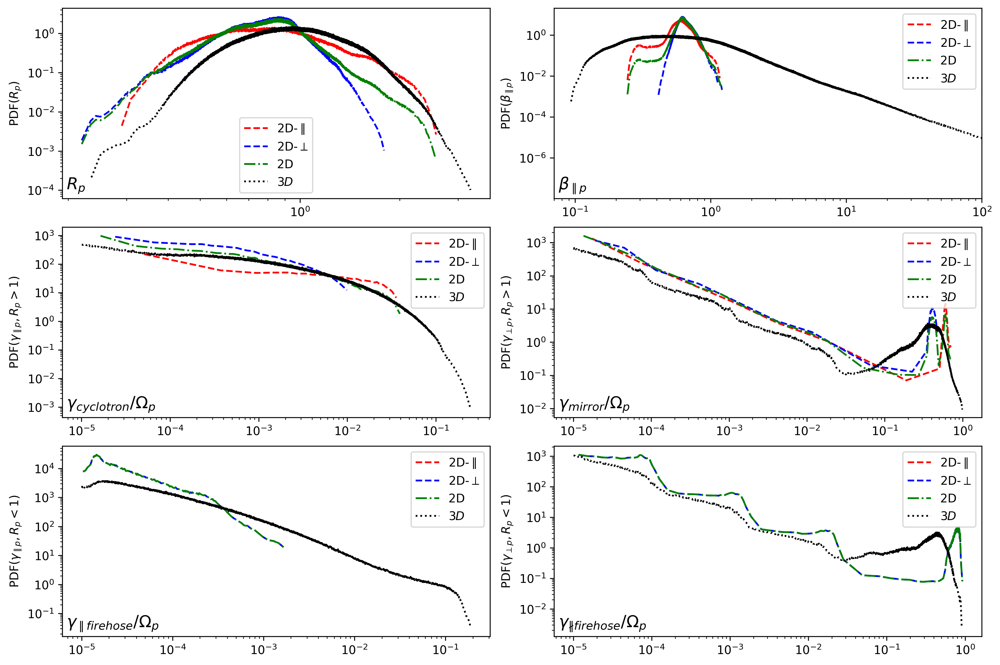

In [ ]:
fig = plt.figure( num=None, figsize=( 12, 9 ), dpi=300, facecolor='w', 
                                                                 edgecolor='k' )

fig.subplots_adjust( left=0.07, right=0.98, top=0.90, bottom=0.07,
                                                        wspace=0.15, hspace=0.15 )

axs1 = fig.add_subplot( 3, 2, 1 )

axs1.plot( df_pdf['rp2dip_pdf'][0], df_pdf['rp2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs1.axvline( x=df2dip.rp.median( ), ls='--', lw=1, c='r' )

axs1.plot( df_pdf['rp2dpp_pdf'][0], df_pdf['rp2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs1.axvline( x=df2dpp.rp.median( ), ls='--', lw=1, c='b' )

axs1.plot( df_pdf['rp2d_pdf'][0], df_pdf['rp2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs1.axvline( x=df2d.rp.median( ), ls='--', lw=1, c='g' )

axs1.plot( df_pdf['rp3d_pdf'][0], df_pdf['rp3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs1.axvline( x=df3d.rp.median( ), ls='--', lw=1, c='k' )

axs1.legend()
axs1.set_ylabel(r'PDF($R_p$)')
axs1.set_xscale('log')
axs1.set_yscale('log')

axs2 = fig.add_subplot( 3, 2, 2 )


axs2.plot( df_pdf['bp2dip_pdf'][0], df_pdf['bp2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs2.axvline( x=df2dip.bp.median( ), ls='--', lw=1, c='r' )

axs2.plot( df_pdf['bp2dpp_pdf'][0], df_pdf['bp2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs2.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='b' )

axs2.plot( df_pdf['bp2d_pdf'][0], df_pdf['bp2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs2.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs2.plot( df_pdf['bp3d_pdf'][0], df_pdf['bp3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs2.axvline( x=df3d.bp.median( ), ls='--', lw=1, c='k' )

axs2.legend()
axs2.set_ylabel(r'PDF($\beta_{\parallel p}$)')
axs2.set_xscale('log')
axs2.set_yscale('log')
axs2.set_xlim(0.07, 100)


axs3 = fig.add_subplot( 3, 2, 3 )

axs3.plot( df_pdf['a_par2dip_pdf'][0], df_pdf['a_par2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs3.axvline( x=df2dip.bp.median( ), ls='--', lw=1, c='r' )

axs3.plot( df_pdf['a_par2dpp_pdf'][0], df_pdf['a_par2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs3.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='b' )

axs3.plot( df_pdf['a_par2d_pdf'][0], df_pdf['a_par2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs3.axvline( x=df2d.bp.median( ), ls='--', lw=1, c='b' )

axs3.plot( df_pdf['a_par3d_pdf'][0], df_pdf['a_par3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs3.axvline( x=df3d.bp.median( ), ls='--', lw=1, c='k' )

#axs3.plot(df_pdf['a_par3d_pdf'][0], a_par3d_pdf_fit, ls='-', lw=1, c='k', label=r'$m=%s$' %(round(m_a_par, 3)))

axs3.legend(loc=1)
axs3.set_ylabel(r'PDF($\gamma_{\parallel p}, R_p >1 $)')
axs3.set_xscale('log')
axs3.set_yscale('log')

axs4 = fig.add_subplot( 3, 2, 4 )


axs4.plot( df_pdf['a_per2dip_pdf'][0], df_pdf['a_per2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs4.axvline( x=df2dip.bp.median( ), ls='--', lw=1, c='b' )

axs4.plot( df_pdf['a_per2dpp_pdf'][0], df_pdf['a_per2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs4.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs4.plot( df_pdf['a_per2d_pdf'][0], df_pdf['a_per2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs4.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs4.plot( df_pdf['a_per3d_pdf'][0], df_pdf['a_per3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs4.axvline( x=df3d.bp.median( ), ls='--', lw=1, c='r' )

#axs4.plot( df_pdf['a_per3d_pdf'][0], a_per3d_pdf_fit, ls='-', lw=1, c='k', label=r'$m=%s$' %(round(m_a_per,3)))

axs4.legend(loc=1)
axs4.set_ylabel(r'PDF($\gamma_{\perp p}, R_p >1 $)')
axs4.set_xscale('log')
axs4.set_yscale('log')

axs5 = fig.add_subplot( 3, 2, 5 )

axs5.plot( df_pdf['b_par2dip_pdf'][0], df_pdf['b_par2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs5.axvline( x=df2dip.bp.median( ), ls='--', lw=1, c='b' )

axs5.plot( df_pdf['b_par2dpp_pdf'][0], df_pdf['b_par2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs5.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs5.plot( df_pdf['b_par2d_pdf'][0], df_pdf['b_par2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs5.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs5.plot( df_pdf['b_par3d_pdf'][0], df_pdf['b_par3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs5.axvline( x=df3d.bp.median( ), ls='--', lw=1, c='r' )

#axs5.plot(df_pdf['b_par3d_pdf'][0], b_par3d_pdf_fit, ls='-', lw=1, c='k', label=r'$m=%s$' %(round(m_b_par,3)))

axs5.legend(loc=1)
axs5.set_ylabel(r'PDF($\gamma_{\parallel p}, R_p < 1 $)')
axs5.set_xscale('log')
axs5.set_yscale('log')

axs6 = fig.add_subplot( 3, 2, 6 )


axs6.plot( df_pdf['b_per2dip_pdf'][0], df_pdf['b_per2dip_pdf'][1], ls='--', lw=1.5, c='r', label= r'2D-$\parallel$' )
#axs6.axvline( x=df2dip.bp.median( ), ls='--', lw=1, c='b' )

axs6.plot( df_pdf['b_per2dpp_pdf'][0], df_pdf['b_per2dpp_pdf'][1], ls='--', lw=1.5, c='b', label= r'2D-$\perp$' )
#axs6.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs6.plot( df_pdf['b_per2d_pdf'][0], df_pdf['b_per2d_pdf'][1], ls='-.', lw=1.5, c='g', label= '2D' )
#axs6.axvline( x=df2dpp.bp.median( ), ls='--', lw=1, c='g' )

axs6.plot( df_pdf['b_per3d_pdf'][0], df_pdf['b_per3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs6.axvline( x=df3d.bp.median( ), ls='--', lw=1, c='r' )

#axs6.plot( df_pdf['b_per3d_pdf'][0], b_per3d_pdf_fit, ls='-', lw=1, c='k', label=r'$m=%s$' %(round(m_b_per,3)))

axs6.legend(loc=1)
axs6.set_ylabel(r'PDF($\gamma_{\perp p}, R_p < 1 $)')
axs6.set_xscale('log')
axs6.set_yscale('log')

axs1.text( 0.01, 0.05, r'$R_p$', fontsize=14, transform=axs1.transAxes )
axs2.text( 0.01, 0.05, r'$\beta_{\parallel p}$', fontsize=14, transform=axs2.transAxes )
axs3.text( 0.01, 0.05, r'$\gamma_{cyclotron}/\Omega_p$', fontsize=14, transform=axs3.transAxes )
axs4.text( 0.01, 0.05, r'$\gamma_{mirror}/\Omega_p$', fontsize=14, transform=axs4.transAxes )
axs5.text( 0.01, 0.05, r'$\gamma_{\parallel firehose}/\Omega_p$', fontsize=14, transform=axs5.transAxes )
axs6.text( 0.01, 0.05, r'$\gamma_{\nparallel firehose}/\Omega_p$', fontsize=14, transform=axs6.transAxes )
#plt.savefig( '../figures/r_b_gamma_pdfs.pdf', dpi=300, format='pdf')

(-1.0, 1.0)

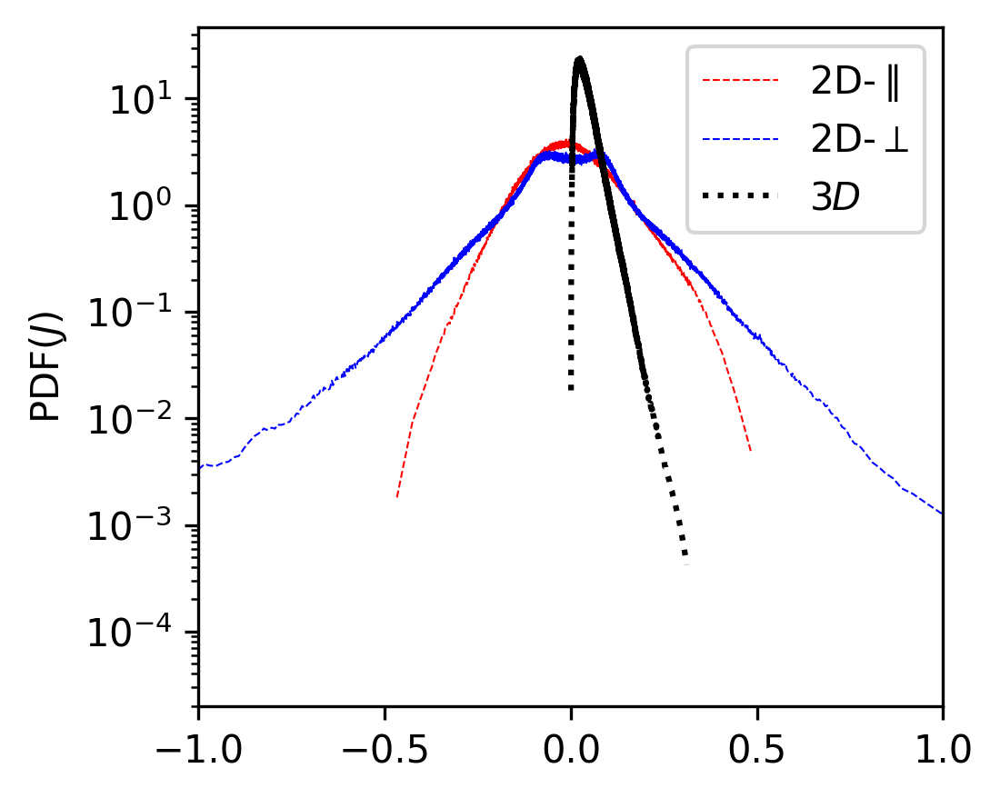

In [ ]:
fig = plt.figure( num=None, figsize=( 3, 3 ), dpi=300, facecolor='w', 
                                                                 edgecolor='k' )

fig.subplots_adjust( left=0.07, right=0.98, top=0.90, bottom=0.07,
                                                        wspace=0.15, hspace=0.15 )

axs1 = fig.add_subplot( 1, 1, 1 )

axs1.plot( df_pdf['jz2dip_pdf'][0], df_pdf['jz2dip_pdf'][1], ls='--', lw=.5, c='r', label= r'2D-$\parallel$' )
#axs1.axvline( x=df2dip.jz.median( ), ls='--', lw=1, c='r' )

axs1.plot( df_pdf['jz2dpp_pdf'][0], df_pdf['jz2dpp_pdf'][1], ls='--', lw=.5, c='b', label= r'2D-$\perp$' )
#axs1.axvline( x=df2dpp.jz.median( ), ls='--', lw=1, c='b' )

#axs1.plot( df_pdf['jz2d_pdf'][0], df_pdf['jz2d_pdf'][1], ls='-.', lw=.5, c='g', label= '2D' )
#axs1.axvline( x=df2d.jz.median( ), ls='--', lw=1, c='g' )

axs1.plot( df_pdf['j3d_pdf'][0], df_pdf['j3d_pdf'][1], ls='dotted', lw=1.5, c='k', label= r'$3D$' )
#axs1.axvline( x=df3d.j.median( ), ls='--', lw=1, c='k' )

axs1.legend()
axs1.set_ylabel(r'PDF($J$)')
#axs1.set_xscale('log')
axs1.set_yscale('log')
#axs1.set_ylim(1.e-1, 4.e1)
axs1.set_xlim(-1., 1)

#PVI stuff

In [ ]:
data_file  = glob( 'data_Rp_betap_jz_b_149p6_hb.h5' )
gamma_file = glob( 'gamma_k_149p6_hb.h5' )
dat = hf.File(data_file[0])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
def compute_pvi( bx=None, by=None, bz=None, lag=137, std_dur=None) :

    bx = array(bx)
    by = array(by)
    bz = array(bz)

    b_std = std( sqrt(bx**2 + by**2 + bz**2) )

    pvi = full( (shape(bx)[0], shape(bx)[1]), nan)

    for i in range(lag, shape(bx)[0] - lag ) :
        print(i)
        for j in range(lag, shape(bx)[1] - lag ) :

            db1 = sqrt( (bx[i-lag,j] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db2 = sqrt( (bx[i,j-lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db3 = sqrt( (bx[i-lag,j-lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db4 = sqrt( (bx[i-lag,j+lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db5 = sqrt( (bx[i,j+lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db6 = sqrt( (bx[i+lag,j+lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db7 = sqrt( (bx[i+lag,j] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )
            db8 = sqrt( (bx[i+lag,j-lag] - bx[i,j])**2 + (by[i+lag,j+lag] - by[i,j])**2 + (bz[i+lag,j+lag] - bz[i,j])**2 )

            db = array([db1, db2, db3, db4, db5, db6, db7, db8])
            pvi[i,j] = mean(db)/b_std
    return pvi

In [ ]:
%%time

#dat_3d   = hf.File('3Ddata_Rp_betap_b_yan512.h5')
dat_2dip  = hf.File('data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5')
#dat_2dpp = hf.File( 'data_Rp_betap_jz_b_149p6_hb.h5')

#pvi_3d = compute_pvi(array(dat['bx']), array(dat['by']), array(dat['bz']), lag=137 )
pvi2dip = compute_pvi(array(dat_2dip['bx']), array(dat_2dip['by']), array(dat_2dip['bz']), lag=137 )
#pvi2dpp = compute_pvi(array(dat_2dpp['bx']), array(dat_2dpp['by']), array(dat_2dpp['bz']), lag=137 )

/usr/local/lib/python3.6/dist-packages/matplotlib/colors.py:1171: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


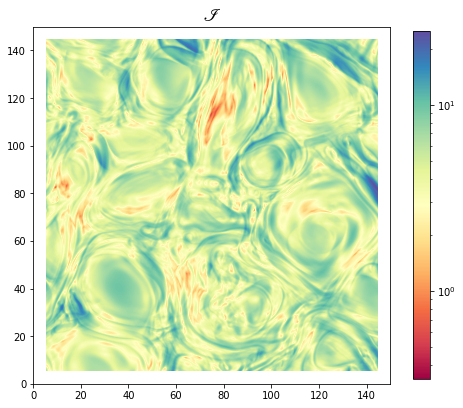

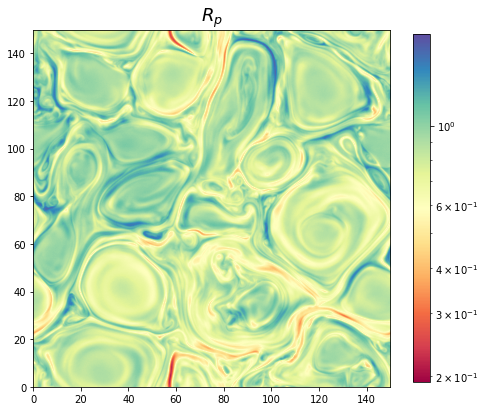

In [ ]:
plt.figure(figsize=(8,8))
im1 = plt.imshow( transpose(pvi2dpp), origin='lower', extent=[0,150, 0, 150], cmap=plt.cm.Spectral, norm=mpl.colors.LogNorm())
plt.colorbar(orientation='vertical', pad=0.05, shrink=0.8)
plt.title(r'$\mathscr{I}$', fontsize=18)
plt.figure(figsize=(8,8))
plt.title(r'$R_p$', fontsize=18)
plt.imshow( transpose(dat_2dpp['Rp']), origin='lower', extent=[0,150, 0, 150], cmap=plt.cm.Spectral, norm=mpl.colors.LogNorm())
plt.colorbar(orientation='vertical', pad=0.05, shrink=0.8);

/usr/local/lib/python3.6/dist-packages/matplotlib/colors.py:1171: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


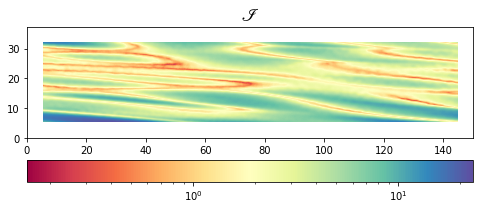

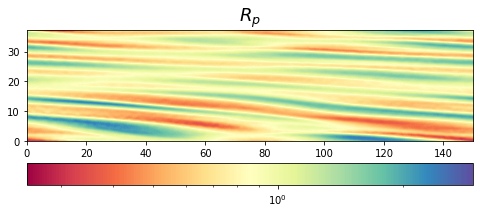

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow( transpose(pvi2dip), origin='lower', extent=[0,150, 0, 37.4], cmap=plt.cm.Spectral, norm=mpl.colors.LogNorm())
plt.colorbar(orientation='horizontal', pad=0.05, shrink=1)
plt.title(r'$\mathscr{I}$', fontsize=18)

plt.figure(figsize=(8,8))
plt.imshow( transpose(dat_2dip['Rp']), origin='lower', extent=[0,150, 0, 37.4], cmap=plt.cm.Spectral, norm=mpl.colors.LogNorm())
plt.colorbar(orientation='horizontal', pad=0.05, shrink=1)
plt.title(r'$R_p$', fontsize=18);

In [ ]:
shape(pvi2dip), shape(pvi2dpp)

((4096, 1024), (4096, 4096))

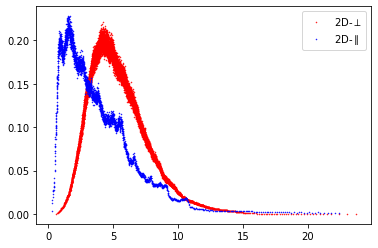

In [ ]:
pvi2dpp_arr = pvi2dpp.ravel()
pvi2dip_arr = pvi2dip.ravel()

pvi_df1 = pd.DataFrame()
pvi_df2 = pd.DataFrame()
pvi_df1['pvi2dpp'] = pvi2dpp_arr
pvi_df2['pvi2dip'] = pvi2dip_arr

pvi2dpp_pdf = calc_pdf(pvi_df1['pvi2dpp'], 1000 )
pvi2dip_pdf = calc_pdf(pvi_df2['pvi2dip'], 1000 )

plt.plot( pvi2dpp_pdf[0], pvi2dpp_pdf[1], 'r.', ms=1, lw=1, label= r'2D-$\perp$')
plt.plot( pvi2dip_pdf[0], pvi2dip_pdf[1], 'b.', ms=1, lw=1, label= r'2D-$\parallel$')
plt.legend()

In [ ]:
!pwd

/content/gdrive/My Drive/Studies/Research/Active_Research/pic/data


In [ ]:
fn = '/content/gdrive/My Drive/Studies/Research/Active_Research/Data/MMS_data/Data/g_k_di.h5'

In [ ]:
t_dat = hf.File(fn)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  """Entry point for launching an IPython kernel.


In [ ]:
shape(t_dat['g_a_par'] )

(4096, 4096)

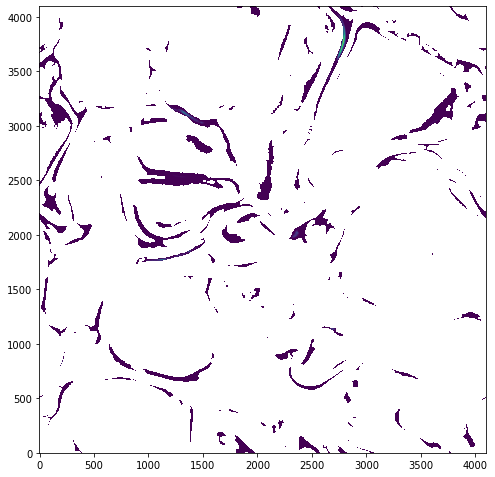

In [ ]:
plt.imshow( transpose(t_dat['g_a_par']), origin='lower')

# Wind Stuff

In [ ]:
# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/data/all_wind_data_v02.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
k_a_par = df.k_a_par
k_b_par = df.k_b_par

g_a_per = df.g_a_per
g_b_per = df.g_b_per
k_a_per = df.k_a_per
k_b_per = df.k_b_per

r_p = df.r_p
b_p = df.b_p

cf = 1.e-5

# Masking for parallel components.

#g_a_par_m = ma.masked_where( g_a_par < cf, g_a_par )
#g_b_par_m = ma.masked_where( g_b_par < cf, g_b_par )
#k_a_par_m = ma.masked_where( g_a_par < cf, k_a_par )
#k_b_par_m = ma.masked_where( g_b_par < cf, k_b_par )
#
## Masking for perpendicular components.
#
#g_a_per_m = ma.masked_where( g_a_per < cf, g_a_per )
#g_b_per_m = ma.masked_where( g_b_per < cf, g_b_per )
#k_a_per_m = ma.masked_where( g_a_per < cf, k_a_per )
#k_b_per_m = ma.masked_where( g_b_per < cf, k_b_per )

x = df.index

In [ ]:
df.keys()

Index(['b_p', 'di', 'dl', 'g_a_par', 'g_a_per', 'g_b_par', 'g_b_per',
       'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per', 'lin_time', 'omnl',
       'omnl_time', 'r_p'],
      dtype='object')

In [ ]:
t1 = datetime.strptime('09Apr2003', '%d%b%Y')
t2 = datetime.strptime('10Apr2003', '%d%b%Y')

In [ ]:
t1
t2 =t1 + timedelta(5)

In [ ]:
x>t1

array([False, False, False, ...,  True,  True,  True])

DatetimeIndex(['2009-02-20 00:01:24', '2009-02-20 00:03:02',
               '2009-02-20 00:04:40', '2009-02-20 00:06:18',
               '2009-02-20 00:07:56', '2009-02-20 00:09:34',
               '2009-02-20 00:11:11', '2009-02-20 00:12:49',
               '2009-02-20 00:14:27', '2009-02-20 00:16:05',
               ...
               '2009-02-24 22:23:29', '2009-02-24 22:25:07',
               '2009-02-24 22:26:45', '2009-02-24 22:52:51',
               '2009-02-24 23:04:16', '2009-02-24 23:12:26',
               '2009-02-24 23:25:29', '2009-02-24 23:27:07',
               '2009-02-24 23:28:45', '2009-02-24 23:30:23'],
              dtype='datetime64[ns]', length=1392, freq=None)

In [ ]:
np.min(x[1000000:1005000]), np.max(x[1000000:1002000])

(Timestamp('2001-09-22 22:45:51'), Timestamp('2001-09-28 04:22:41'))

In [ ]:
t1 + timedelta(5)

datetime.datetime(2009, 2, 25, 0, 0)

In [ ]:
for i in range( 214 ) :

    c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
    mk = [ '.', '*', '^', 'v', 'd', 's' ]

    dpi = 100 # DPI of the saved plots

    s = 1 # Marker size

    legend_transparency = 0.50 # Transparency of legend

    ncol = 2 # Number of columns for legend

    fig = plt.figure( num=None, figsize=(25, 10), dpi=400, facecolor='w',
                          edgecolor='gray' )

    fig.subplots_adjust( left=0.08, right=0.99, top=0.97, bottom=0.09, 
                                                         wspace=0.03, hspace=0 )

    axs11 = fig.add_subplot( 4, 1, 1, sharex=None )

    axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs11.scatter( x[i*10000:(i+1)*10000], r_p[i*10000:(i+1)*10000], 
                                                    marker=mk[0], s=s, c=c[2] )
#                                           label=r'$R_{\rm i{p}}$' )

    tt = x[i*10000:(i+1)*10000]
    graph_time = str(np.min(tt).year) + '-' + \
                 str(np.min(tt).month) + '-' + \
                 str(np.min(tt).day) + ' to ' + \
                 str(np.max(tt).year) + '-' + \
                 str(np.max(tt).month) + '-' + \
                 str(np.max(tt).day)

    axs11.set_yscale('log')
    axs11.set_ylim(0.06, 16)

    axs11.set_title(graph_time, fontsize=20)
    axs11.set_ylabel( r'$\mathrm{R}_p$', fontsize=18 )

    axs11.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs11.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )


    axs21 = fig.add_subplot( 4, 1, 2, sharex=axs11 )
    axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs21.scatter( x[i*10000:(i+1)*10000], b_p[i*10000:(i+1)*10000], 
                                                    marker=mk[0], s=s, c=c[3] )

    axs21.set_ylabel( r'$\beta_{\parallel}$', fontsize=18 )

    axs21.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs21.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

    axs21.set_ylim( 0.1, 100 )
    axs21.set_yscale( 'log' )

    axs41 = fig.add_subplot( 4, 1, 3, sharex=axs11 )

    axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs41.plot( x[i*10000:(i+1)*10000], g_a_par[i*10000:(i+1)*10000], ls=None, lw=0.,
                      marker='x', ms=1.5, mew=0.3, c=c[1], label=r'$\gamma_{cyclotron}$' )

    axs41.scatter( x[i*10000:(i+1)*10000], g_b_par[i*10000:(i+1)*10000], 
                       marker=mk[0], s=s, c=c[0], label=r'$\gamma_{firehose}$' )

    lgnd4 = axs41.legend(fontsize=16, numpoints=1)
    lgnd4.legendHandles[0]._sizes = [20]
    lgnd4.legendHandles[1]._sizes = [20]

    axs41.set_ylabel( r'$\gamma_{\parallel}$', fontsize=18 )

    axs41.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs41.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )


    axs41.set_ylim( 1.e-5, 0.6 )
    axs41.set_yscale( 'log' )


    axs51 = fig.add_subplot( 4, 1, 4, sharex=axs11 )

    axs51.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs51.plot( x[i*10000:(i+1)*10000], g_a_per[i*10000:(i+1)*10000], ls=None, lw=0.,
                       marker='x', ms=1.5, mew=0.3, c=c[1], label=r'$\gamma_{mirror}$' )

    axs51.scatter( x[i*10000:(i+1)*10000], g_b_per[i*10000:(i+1)*10000], 
                       marker=mk[0], s=s, c=c[0], label=r'$\gamma_{firehose}$' )

    lgnd5 = axs51.legend(fontsize=16, numpoints=1)
    lgnd5.legendHandles[0]._sizes = [20]
    lgnd5.legendHandles[1]._sizes = [20]

    axs51.set_ylabel( r'$\gamma_{\perp}$', fontsize=18 )

    axs51.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=20 )

    axs51.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

    axs51.set_ylim( 1.e-5, 0.6 )
    axs51.set_yscale( 'log' )

    axs51.set_xlabel( 'Date', fontsize=20 )

    plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/gamma_figures/png/wind_all_piecewise_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(i).zfill(3)}.png', dpi=100, format='png' )

    plt.close( 'all' )

    if (i%10==0) :
        print(f'Figure saved for i={i}')

Figure saved for i=0
Figure saved for i=10
Figure saved for i=20
Figure saved for i=30
Figure saved for i=40
Figure saved for i=50
Figure saved for i=60
Figure saved for i=70
Figure saved for i=80
Figure saved for i=90
Figure saved for i=100
Figure saved for i=110
Figure saved for i=120
Figure saved for i=130
Figure saved for i=140
Figure saved for i=150
Figure saved for i=160
Figure saved for i=170
Figure saved for i=180
Figure saved for i=190
Figure saved for i=200
Figure saved for i=210


In [ ]:
t1 = datetime.strptime('01Jan2004', '%d%b%Y')
t2 = t1 + timedelta(1550)
ind = np.where((x > t1) & (x <=t2))
tt = x[ind[0]]
tt

DatetimeIndex(['2004-03-02 02:56:21', '2004-03-02 02:57:58',
               '2004-03-02 03:01:09', '2004-03-02 03:18:55',
               '2004-03-02 03:25:24', '2004-03-02 03:44:53',
               '2004-03-02 03:48:07', '2004-03-02 03:59:21',
               '2004-03-02 04:00:59', '2004-03-02 04:05:47',
               ...
               '2008-03-29 23:18:21', '2008-03-29 23:21:36',
               '2008-03-29 23:24:52', '2008-03-29 23:28:08',
               '2008-03-29 23:41:13', '2008-03-29 23:46:07',
               '2008-03-29 23:47:45', '2008-03-29 23:49:23',
               '2008-03-29 23:51:00', '2008-03-29 23:52:38'],
              dtype='datetime64[ns]', length=642466, freq=None)

In [ ]:
t2

datetime.datetime(2008, 3, 30, 0, 0)

In [ ]:
t1 = datetime.strptime('01Jan2001', '%d%b%Y')
t2 = t1
i = 0
c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 150 # DPI of the saved plots
s = 1 # Marker size
legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend

while (t2 < x[-1]):

    t2 = t1 + timedelta(10)

    ind = np.where((x > t1) & (x <=t2))
    tt = x[ind[0]]
    #tt = x[i*10000:(i+1)*10000]
    graph_time = str(np.min(tt).year) + '-' + \
                 str(np.min(tt).month) + '-' + \
                 str(np.min(tt).day) + ' to ' + \
                 str(np.max(tt).year) + '-' + \
                 str(np.max(tt).month) + '-' + \
                 str(np.max(tt).day)

    fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                          edgecolor='gray' )

    fig.subplots_adjust( left=0.08, right=0.99, top=0.97, bottom=0.09, 
                                                         wspace=0.03, hspace=0 )

    axs11 = fig.add_subplot( 4, 1, 1, sharex=None )

    axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs11.scatter( x[ind[0]], r_p[ind[0]], marker=mk[0], s=s, c=c[2] )
#                                           label=r'$R_{\rm i{p}}$' )
    axs11.set_yscale('log')
    axs11.set_ylim(0.06, 16)

    axs11.set_title(graph_time, fontsize=20)
    axs11.set_ylabel( r'$\mathrm{R}_p$', fontsize=18 )

    axs11.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs11.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )


    axs21 = fig.add_subplot( 4, 1, 2, sharex=axs11 )
    axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs21.scatter( x[ind[0]], b_p[ind[0]], 
                                                    marker=mk[0], s=s, c=c[3] )

    axs21.set_ylabel( r'$\beta_{\parallel}$', fontsize=18 )

    axs21.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs21.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

    axs21.set_ylim( 0.1, 100 )
    axs21.set_yscale( 'log' )

    axs41 = fig.add_subplot( 4, 1, 3, sharex=axs11 )

    axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs41.plot( x[ind[0]], g_a_par[ind[0]], ls=None, lw=0.,
                      marker='x', ms=1.5, mew=0.3, c=c[1], label=r'$\gamma_{cyclotron}$' )

    axs41.scatter( x[ind[0]], g_b_par[ind[0]], 
                       marker=mk[0], s=s, c=c[0], label=r'$\gamma_{firehose}$' )

    lgnd4 = axs41.legend(fontsize=16, numpoints=1)
    lgnd4.legendHandles[0]._sizes = [20]
    lgnd4.legendHandles[1]._sizes = [20]

    axs41.set_ylabel( r'$\gamma_{\parallel}$', fontsize=18 )

    axs41.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )

    axs41.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )


    axs41.set_ylim( 1.e-5, 0.6 )
    axs41.set_yscale( 'log' )

    axs51 = fig.add_subplot( 4, 1, 4, sharex=axs11 )

    axs51.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

    axs51.plot( x[ind[0]], g_a_per[ind[0]], ls=None, lw=0.,
                       marker='x', ms=1.5, mew=0.3, c=c[1], label=r'$\gamma_{mirror}$' )

    axs51.scatter( x[ind[0]], g_b_per[ind[0]], 
                       marker=mk[0], s=s, c=c[0], label=r'$\gamma_{firehose}$' )

    lgnd5 = axs51.legend(fontsize=16, numpoints=1)
    lgnd5.legendHandles[0]._sizes = [20]
    lgnd5.legendHandles[1]._sizes = [20]

    axs51.set_ylabel( r'$\gamma_{\perp}$', fontsize=18 )

    axs51.get_xaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=20 )

    axs51.get_yaxis().set_tick_params( which='both', direction='out', 
    labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

    axs51.set_ylim( 1.e-5, 0.6 )
    axs51.set_yscale( 'log' )
    axs51.set_xlim(t1, t2)
    axs51.set_xlabel( 'Date', fontsize=20 )

    plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/gamma_figures/png/10days//wind_all_piecewise_10days_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(i).zfill(3)}.png', dpi=150, format='png', bbox_inches = 'tight', pad_inches = 0.05 )

    plt.close( 'all' )

    i += 1
    t1 = t2
    if (i%10==0) :
        print(f'Figure saved for i={i}')

In [ ]:
t2

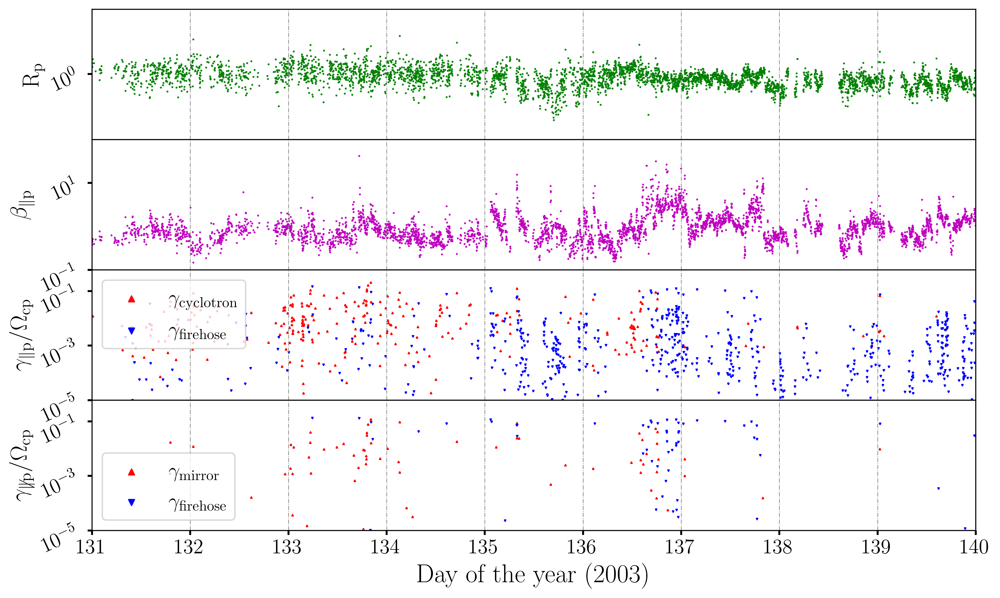

CPU times: user 5.4 s, sys: 49.4 ms, total: 5.44 s
Wall time: 5.4 s


In [ ]:
%%time

t1 = datetime.strptime('2003051100', '%Y%m%d%H')
t2 = datetime.strptime('2003052000', '%Y%m%d%H')

indices = np.where((x>= t1) & (x<=t2))[0]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 1 # Marker size
mew = 1
legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.19, right=0.98, top=0.99, bottom=0.19, 
                                                     wspace=0.03, hspace=0 )
axs11 = fig.add_subplot( 4, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs11.scatter( x[indices], r_p[indices], marker=mk[0], s=s, c=c[2] )

tt = x[indices]
graph_time = str(np.min(tt).year) + '-' + \
             str(np.min(tt).month) + '-' + \
             str(np.min(tt).day) + ' to ' + \
             str(np.max(tt).year) + '-' + \
             str(np.max(tt).month) + '-' + \
             str(np.max(tt).day)
axs11.set_yscale('log')
axs11.set_ylim(0.06, 16)
#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\mathrm{R_p}$', fontsize=18 )
axs11.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs11.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

axs21 = fig.add_subplot( 4, 1, 2, sharex=axs11 )
axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs21.scatter( x[indices], b_p[indices], 
                                                marker=mk[0], s=s, c=c[3] )
axs21.set_ylabel( r'$\beta_{\parallel \rm p}$', fontsize=18 )
axs21.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs21.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs21.set_ylim( 0.1, 100 )
axs21.set_yscale( 'log' )

axs41 = fig.add_subplot( 4, 1, 3, sharex=axs11 )
axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs41.scatter( x[indices], g_a_par[indices],
                  marker=mk[2], s=s, c=c[1], label=r'$\gamma_{\rm cyclotron}$' )
axs41.scatter( x[indices], g_b_par[indices], 
                   marker=mk[3], s=s, c=c[0], label=r'$\gamma_{\rm firehose}$' )
lgnd4 = axs41.legend(fontsize=16, numpoints=1)
lgnd4.legendHandles[0]._sizes = [20]
lgnd4.legendHandles[1]._sizes = [20]
axs41.set_ylabel( r'$\gamma_{\parallel \rm p}/\Omega_{\rm cp}$', fontsize=18 )
axs41.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs41.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs41.set_ylim( 1.e-5, 0.6 )
axs41.set_yscale( 'log' )

axs51 = fig.add_subplot( 4, 1, 4, sharex=axs11 )
axs51.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs51.scatter( x[indices], g_a_per[indices],
                   marker=mk[2], s=s, c=c[1], label=r'$\gamma_{\rm mirror}$' )
axs51.scatter( x[indices], g_b_per[indices], 
                   marker=mk[3], s=s, c=c[0], label=r'$\gamma_{\rm firehose}$' )
lgnd5 = axs51.legend(fontsize=16, numpoints=1)
lgnd5.legendHandles[0]._sizes = [20]
lgnd5.legendHandles[1]._sizes = [20]
axs51.set_ylabel( r'$\gamma_{\not \parallel \rm p}/\Omega_{\rm cp}$', fontsize=18 )

axs51.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=0 )
axs51.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs51.set_ylim( 1.e-5, 0.6 )
axs51.set_yscale( 'log' )
axs51.set_xlim(t1, t2)
date_form = DateFormatter("%j")
axs51.xaxis.set_major_formatter(date_form)
#fig.autofmt_xdate()

ddd = t1.strftime('%Y')
axs51.set_xlabel( f'Day of the year ({ddd})', fontsize=20 )

plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/gamma_figures/pdf/wind_all_piecewise_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf', dpi=400, format='pdf', bbox_inches = 'tight', pad_inches = 0.05 )
plt.show()
plt.close( 'all' )

# MMS Stuff

In [ ]:
# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_1_gamma_kdi_pvi_v02.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
k_a_par = df.k_a_par
k_b_par = df.k_b_par

g_a_per = df.g_a_per
g_b_per = df.g_b_per
k_a_per = df.k_a_per
k_b_per = df.k_b_per

r_p = df.r_p
b_p = df.b_p

cf = 1.e-5

# Masking for parallel components.

#g_a_par_m = ma.masked_where( g_a_par < cf, g_a_par )
#g_b_par_m = ma.masked_where( g_b_par < cf, g_b_par )
#k_a_par_m = ma.masked_where( g_a_par < cf, k_a_par )
#k_b_par_m = ma.masked_where( g_b_par < cf, k_b_par )
#
## Masking for perpendicular components.
#
#g_a_per_m = ma.masked_where( g_a_per < cf, g_a_per )
#g_b_per_m = ma.masked_where( g_b_per < cf, g_b_per )
#k_a_per_m = ma.masked_where( g_a_per < cf, k_a_per )
#k_b_per_m = ma.masked_where( g_b_per < cf, k_b_per )

x = df.index

In [ ]:
x.min(), x.max()

(Timestamp('2017-12-26 06:12:43.839900017'),
 Timestamp('2017-12-26 06:52:22.258699894'))

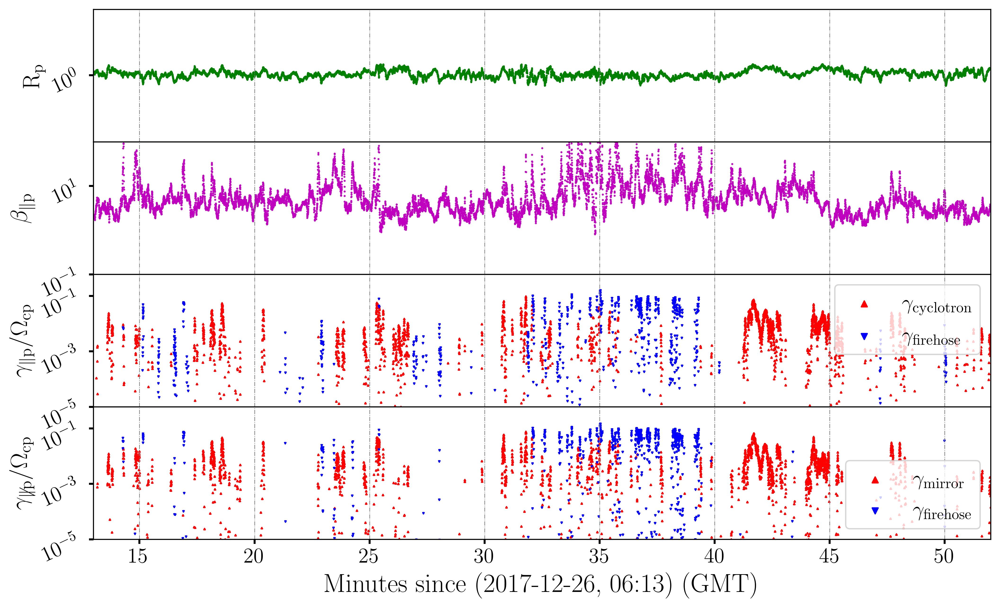

CPU times: user 10.8 s, sys: 157 ms, total: 10.9 s
Wall time: 11.2 s


In [ ]:
%%time

t1 = datetime.strptime('201712260613', '%Y%m%d%H%M')
t2 = datetime.strptime('201712260652', '%Y%m%d%H%M')

indices = np.where((x>= t1) & (x<=t2))[0]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 1 # Marker size
mew = 1
legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.19, right=0.98, top=0.99, bottom=0.19, 
                                                     wspace=0.03, hspace=0 )
axs11 = fig.add_subplot( 4, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs11.scatter( x[indices], r_p[indices], marker=mk[0], s=s, c=c[2] )

tt = x[indices]
graph_time = str(np.min(tt).year) + '-' + \
             str(np.min(tt).month) + '-' + \
             str(np.min(tt).day) + ' to ' + \
             str(np.max(tt).year) + '-' + \
             str(np.max(tt).month) + '-' + \
             str(np.max(tt).day)
axs11.set_yscale('log')
axs11.set_ylim(0.06, 16)
axs11.set_xlim(t1, t2)
#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\mathrm{R_p}$', fontsize=18 )
axs11.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs11.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )

axs21 = fig.add_subplot( 4, 1, 2, sharex=axs11 )
axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs21.scatter( x[indices], b_p[indices], 
                                                marker=mk[0], s=s, c=c[3] )
axs21.set_ylabel( r'$\beta_{\parallel \rm p}$', fontsize=18 )
axs21.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs21.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs21.set_ylim( 0.1, 100 )
axs21.set_yscale( 'log' )

axs41 = fig.add_subplot( 4, 1, 3, sharex=axs11 )
axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs41.scatter( x[indices], g_a_par[indices],
                  marker=mk[2], s=s, c=c[1], label=r'$\gamma_{\rm cyclotron}$' )
axs41.scatter( x[indices], g_b_par[indices], 
                   marker=mk[3], s=s, c=c[0], label=r'$\gamma_{\rm firehose}$' )
lgnd4 = axs41.legend(fontsize=16, numpoints=1)
lgnd4.legendHandles[0]._sizes = [20]
lgnd4.legendHandles[1]._sizes = [20]
axs41.set_ylabel( r'$\gamma_{\parallel \rm p}/\Omega_{\rm cp}$', fontsize=18 )
axs41.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=16, labelrotation=25 )
axs41.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs41.set_ylim( 1.e-5, 0.6 )
axs41.set_yscale( 'log' )

axs51 = fig.add_subplot( 4, 1, 4, sharex=axs11 )
axs51.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs51.scatter( x[indices], g_a_per[indices],
                   marker=mk[2], s=s, c=c[1], label=r'$\gamma_{\rm mirror}$' )
axs51.scatter( x[indices], g_b_per[indices], 
                   marker=mk[3], s=s, c=c[0], label=r'$\gamma_{\rm firehose}$' )
lgnd5 = axs51.legend(fontsize=16, numpoints=1)
lgnd5.legendHandles[0]._sizes = [20]
lgnd5.legendHandles[1]._sizes = [20]
axs51.set_ylabel( r'$\gamma_{\not \parallel \rm p}/\Omega_{\rm cp}$', fontsize=18 )

axs51.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=0 )
axs51.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=16, labelrotation=25 )
axs51.set_ylim( 1.e-5, 0.6 )
axs51.set_yscale( 'log' )
axs51.set_xlim(t1, t2)
date_form = DateFormatter("%M")
axs51.xaxis.set_major_formatter(date_form)
#fig.autofmt_xdate()

ddd = t1.strftime('%Y-%m-%d, %H:%M')
axs51.set_xlabel( f'Minutes since ({ddd}) (GMT)', fontsize=20 )
plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/figures/thesis/mms_all_piecewise_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf', dpi=400, format='pdf', bbox_inches = 'tight', pad_inches = 0.05)
plt.show()
plt.close( 'all' )

In [ ]:
t1.strftime('%Y-%m-%d, %H:%M')

'2017-12-26, 06:12'

In [ ]:
x_labels

['', '', '', '', '', '', '', '', '']

In [ ]:
!mkdir /content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/gamma_figures/png

In [ ]:
data = hf.File('mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_hf_files/20171226_1_gamma_kdi_pvi_v01.h5', 'r+')

In [ ]:
ts

1514268763.8399

In [ ]:
!pwd

/content/gdrive/Shareddrives/Shadowfax/Active_Research


In [ ]:
file_names = np.sort(glob('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_hf_files/*.h5'))

for file_name in file_names :
    dat = hf.File(file_name, 'r+')

    index = np.array([datetime.utcfromtimestamp(ts).strftime('%Y-%m-%d %H:%M:%S') for ts in dat['t'][:]])

    df = pd.DataFrame(index=index)
    df.index = pd.to_datetime(df.index)
    for key in dat.keys() :
        if (key!= 't') :
            df[key] = dat[key]

    pickle_file = file_name[:-2] + 'p'
    df.to_pickle(pickle_file)

In [ ]:
dat = hf.File('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_hf_files/20171226_4_gamma_kdi_pvi_v01.h5')
df1 = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_4_gamma_kdi_pvi_v01.p')
df2 = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_4_gamma_kdi_pvi_v02.p')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  """Entry point for launching an IPython kernel.


In [ ]:
hf_time = np.array([datetime.utcfromtimestamp(ts).strftime('%Y-%m-%d %H:%M:%S') for ts in dat['t'][:]])

In [ ]:
hf_time[0:10], df1.index[0:10], df2.index[0:10]

In [ ]:
dfn = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_hf_files/20160111_4_gamma_kdi_pvi_v01.p')

In [ ]:
df.head()

,b_p,g_a_par,g_a_per,g_b_par,g_b_per,j_mag,k_a_par,k_a_per,k_b_par,k_b_per,pvi,r_p
2017-12-26 06:12:43,1.791086,8.847624e-48,-9.833756e-34,NaN,NaN,50.402655,5.296320e-44,-2.647648e-31,NaN,NaN,0.465707,1.007657
2017-12-26 06:12:43,1.813870,NaN,NaN,-2.212135e-65,4.510731e-39,35.250059,NaN,NaN,-6.073058e-61,6.402954e-37,0.459292,0.993326
2017-12-26 06:12:44,1.835668,NaN,NaN,-6.963152e-61,-4.762116e-38,14.863158,NaN,NaN,-1.912192e-56,-6.759793e-36,0.425128,0.970338
2017-12-26 06:12:44,1.812924,NaN,NaN,6.295003e-60,4.248858e-36,6.578532,NaN,NaN,1.726326e-55,6.031227e-34,0.382686,0.952959
2017-12-26 06:12:44,1.832755,NaN,NaN,5.174695e-59,-1.226953e-36,12.603524,NaN,NaN,1.421008e-54,-1.741652e-34,0.307249,0.959949


In [ ]:
dfn.head()

,b_p,g_a_par,g_a_per,g_b_par,g_b_per,j_mag,k_a_par,k_a_per,k_b_par,k_b_per,pvi,r_p
2016-01-11 00:57:04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.231822
2016-01-11 00:57:04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.181360
2016-01-11 00:57:04,NaN,NaN,NaN,NaN,NaN,435.392313,NaN,NaN,NaN,NaN,NaN,1.180227
2016-01-11 00:57:04,NaN,NaN,NaN,NaN,NaN,296.459622,NaN,NaN,NaN,NaN,NaN,1.176441
2016-01-11 00:57:04,NaN,NaN,NaN,NaN,NaN,105.844672,NaN,NaN,NaN,NaN,NaN,1.188193


## MMS PVI Stuff

In [ ]:
# Read all the pickle files and save the data to another file with file name such that it reflects 
# all the dates in its name!

drct = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/'
fnames = np.sort(glob(f'{drct}*_v02.p'))
print(f'Total {len(fnames)} files found')

df_full_mms = pd.DataFrame()
df_list = []
date_list = []
file_version = 'v03.p'

for fn in fnames:
    dfn = pd.read_pickle(fn)
    dfn['dtp'] = dfn.T_p - dfn.T_p.mean()
    # Append dataframe to the list
    df_list.append(dfn)

    # Get the date of the file
    dates = fn[-30:-22]
    if dates not in date_list :
        date_list.append(dates)

    print(f'Data saved for date {fn[-30:-22]}')
# Concatenate all the data to one dataframe
df_full_mms = pd.concat(df_list)

date_str = ''
for xx in date_list :
    date_str = date_str + '_' + xx

# Creat a pickle file name
all_file_name = fnames[0][:-30] + date_str[1:] + '_' + fnames[0][-19:-5] + file_version

# Save the data to the pickle file
df_full_mms.to_pickle(all_file_name)

Total 16 files found
Data saved for date 20160111
Data saved for date 20160111
Data saved for date 20160111
Data saved for date 20160111
Data saved for date 20160124
Data saved for date 20160124
Data saved for date 20160124
Data saved for date 20160124
Data saved for date 20170118
Data saved for date 20170118
Data saved for date 20170118
Data saved for date 20170118
Data saved for date 20171226
Data saved for date 20171226
Data saved for date 20171226
Data saved for date 20171226


In [ ]:
df_full_mms = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20160111_20160124_20170118_20171226_gamma_kdi_pvi_v03.p')

In [ ]:
df_full_mms.T_p.mean(), df_full_mms.T_p.median()

(249.63287824025588, 236.40998607779)

In [ ]:
!pip install seaborn

In [ ]:
pvi = df_full_mms.pvi.values
jmag = df_full_mms.j_mag.values
tp = df_full_mms.T_p.values
dtp = df_full_mms.dtp.values

In [ ]:
np.median(dtp)

-5.731459667785472

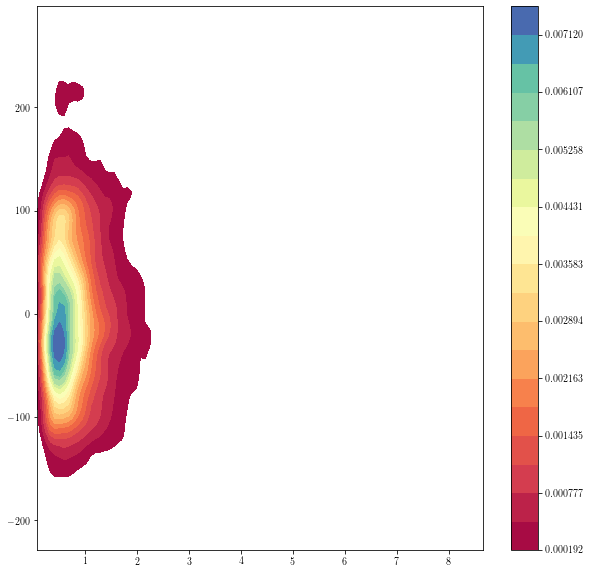

In [ ]:
kd(pvi, dtp, x='$\mathcal{I}$', y='J', gridsize=100, cut=0, cbar=True, shade_lowest=False, fill=True, levels=20, cmap='Spectral')

In [ ]:
kd(pvi, jmag, gridsize=100, cut=0, cbar=True, shade_lowest=False, fill=True, palette='Spectral')

In [ ]:
df_full_mms.j_mag.describe()

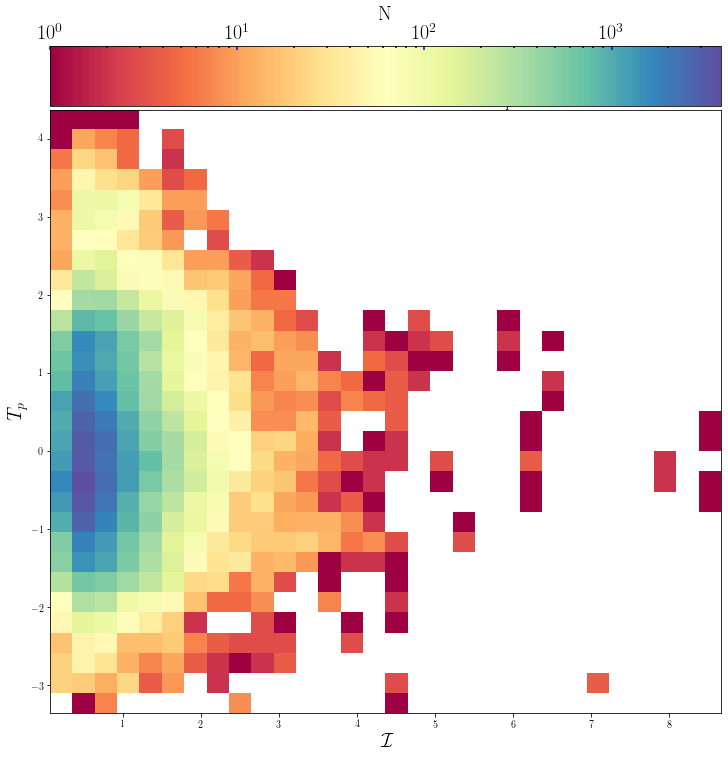

In [ ]:
hist, xs, ys = jnt_pdf(df_full_mms.pvi.values, df_full_mms.dtp.values, bins=30, comp='x')

In [ ]:
( bins, pvi ) = calc_pdf( df_full_mms.pvi, weight=200 )

In [ ]:
np.min(pvi), np.max(pvi)

(0.004315570754395635, 1.8723721856054332)

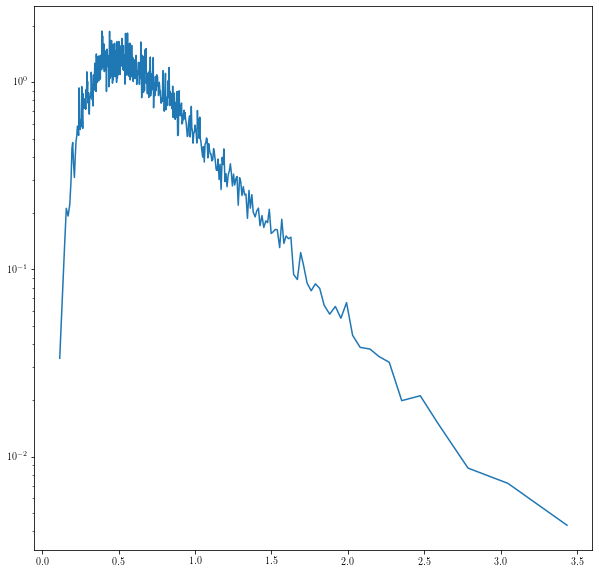

In [ ]:
plt.plot(bins, pvi)
plt.yscale('log')

In [ ]:
pvi_bins = [0, 0.5, 1, 1.5, 2, 2.5, 3]
pvig = pd.cut( df_full_mms.pvi, bins=pvi_bins, right=True, precision=3 )
Tp = df_full_mms.T_p
joint = pd.concat( { 'Tp':Tp, 'pvi':pvig }, axis=1 )
jt = joint.groupby( 'pvi' )

In [ ]:
jt.groups.keys()

dict_keys([Interval(0.0, 0.5, closed='right'), Interval(0.5, 1.0, closed='right'), Interval(1.0, 1.5, closed='right'), Interval(1.5, 2.0, closed='right'), Interval(2.0, 2.5, closed='right'), Interval(2.5, 3.0, closed='right')])

In [ ]:
keys = np.sort( jt.groups.keys() )

jt1 = jt.get_group( keys[0] )
jt2 = jt.get_group( keys[1] )
jt3 = jt.get_group( keys[2] )
jt4 = jt.get_group( keys[3] )

jts1 = jt1['Tp']
jts2 = jt2['Tp']
jts3 = jt3['Tp']
jts4 = jt4['Tp']

( bins1, jt1pdf ) = calc_pdf( jts1, weight=1500 )
( bins2, jt2pdf ) = calc_pdf( jts2, weight=1500 )
( bins3, jt3pdf ) = calc_pdf( jts3, weight=1500 )
( bins4, jt4pdf ) = calc_pdf( jts4, weight=1500 )


In [ ]:
df_full_mms = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_4_gamma_kdi_pvi_v02.p')

In [ ]:
df_sorted = df_full_mms.sort_values( by=['pvi'] )

In [ ]:
n_ind = len( df_sorted.T_p )/4
ev_to_k = 11604.523
Tp1 = df_sorted.T_p[int(n_ind)*0:int(n_ind)*1] * ev_to_k
Tp2 = df_sorted.T_p[int(n_ind)*1:int(n_ind)*2] * ev_to_k
Tp3 = df_sorted.T_p[int(n_ind)*2:int(n_ind)*3] * ev_to_k
Tp4 = df_sorted.T_p[int(n_ind)*3:] * ev_to_k
#Tp5 = df_sorted.T_p[int(n_ind)*4:int(n_ind)*5]
#Tp6 = df_sorted.T_p[int(n_ind)*5:]


In [ ]:
weight = 80
( binsn1, Tpn1 ) = calc_pdf( Tp1, weight=weight )
( binsn2, Tpn2 ) = calc_pdf( Tp2, weight=weight )
( binsn3, Tpn3 ) = calc_pdf( Tp3, weight=weight )
( binsn4, Tpn4 ) = calc_pdf( Tp4, weight=weight )
#( binsn5, Tpn5 ) = calc_pdf( Tp5, weight=weight )
#( binsn6, Tpn6 ) = calc_pdf( Tp6, weight=weight )

pvi_0 = df_sorted['pvi'][int(n_ind)*0]
pvi_1 = df_sorted['pvi'][int(n_ind)*1]
pvi_2 = df_sorted['pvi'][int(n_ind)*2]
pvi_3 = df_sorted['pvi'][int(n_ind)*3]
pvi_4 = df_sorted['pvi'][int(n_ind)*4]
#pvi_5 = df_sorted['pvi'][int(n_ind)*5]
#pvi_6 = df_sorted['pvi'][int(n_ind)*5:].max()

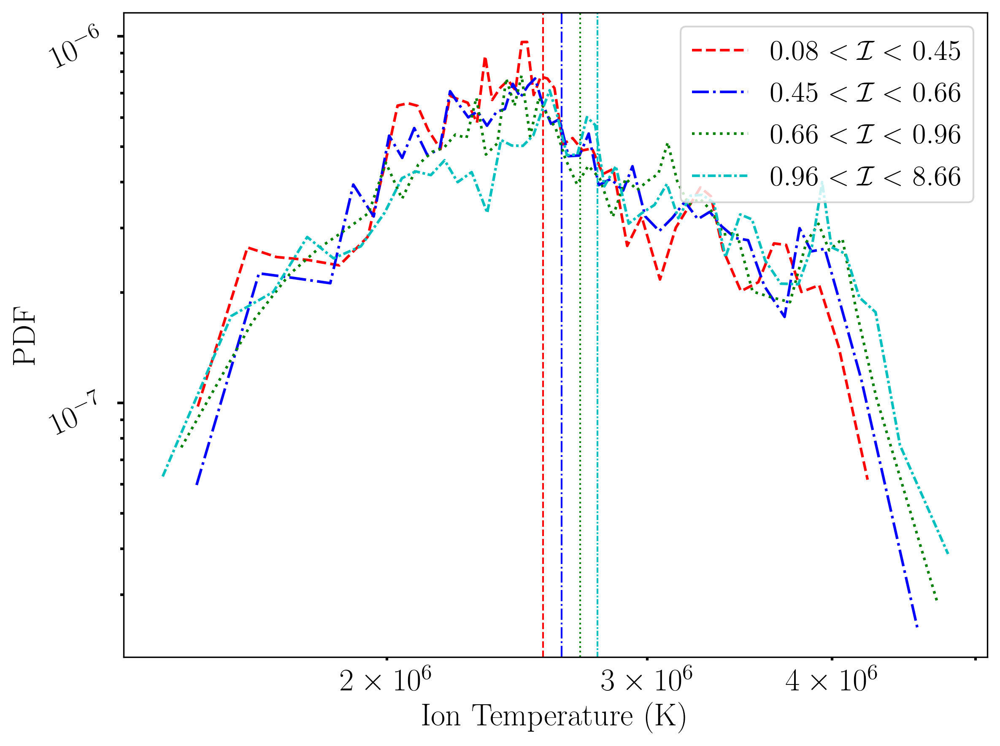

In [ ]:
fig = plt.figure( num=None, figsize=( 8, 6 ), dpi=300, facecolor='w', edgecolor='k' )

axs = fig.add_subplot( 1, 1, 1 )

axs.plot( binsn1, Tpn1, ls='--', lw=1.5, c='r', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_0, 2 ), round( pvi_1, 2 ) ) )
axs.axvline( x=Tp1.median( ), ls='--', lw=1, c='r' )
#axs.annotate("", xy=(Tp1.median(), Tpn1[25]), xytext=(Tp1.median()+1000, Tpn1[20]), arrowprops=dict(headwidth=10, headlength=10, width=10))
#plt.annotate("", xy=(40, 0.11), xytext=(30, 0.01), arrowprops=dict(headwidth=10, headlength=10, width=0.1))
#axs.arrow(x=Tp1.median(), y=Tpn1[25], dx=100, dy=1e-10, ls='-', lw=1, color='k')

axs.plot( binsn2, Tpn2, ls='-.', lw=1.5, c='b', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_1, 2 ), round( pvi_2, 2 ) ) )
axs.axvline( x=Tp2.median( ), ls='-.', lw=1, c='b' )

axs.plot( binsn3, Tpn3, ls=':', lw=1.5, c='g', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_2, 2 ), round( pvi_3, 2 ) ) )
axs.axvline( x=Tp3.median( ), ls=':', lw=1, c='g' )

axs.plot( binsn4, Tpn4, ls=(0,(3,1,1,1)), lw=1.5, c='c', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_3, 2 ), round( pvi_4, 2 ) ) )
axs.axvline( x=Tp4.median( ), ls=(0,(3,1,1,1)), lw=1, c='c' )
#
#axs.plot( binsn5, Tpn5, ls=(0,(3,5,1,5,1,5)), lw=1.5, c='m', 
#label=r'%s < $\mathcal{I}$ < %s' %( round( pvi_4, 2 ), round( pvi_5, 2 ) ) )
#axs.axvline( x=Tp5.median( ), ls=(0,(3,5,1,5,1,5)), lw=1, c='m' )
#
#axs.plot( binsn6, Tpn6, ls=(0,(3,1,1,1,1,1)), lw=1.5, c='k', 
#label=r'%s < $\mathcal{I}$ < %s' %( round( pvi_5, 2 ), round( pvi_6, 2 ) ) )
#axs.axvline( x=Tp6.median( ), ls=(0,(3,1,1,1,1,1)), lw=1, c='k' )

#axs.set_xlim( 7.0e1, 4.5e2 )
#axs.set_ylim( 1.0e-7, 6.e-6 )
axs.set_xscale( 'log' )
axs.set_yscale( 'log' )
axs.legend( fontsize=16, loc=1 )

axs.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=0 )
                                                                 
axs.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=25 )

axs.set_xlabel( 'Ion Temperature (K)', fontsize=18)
axs.set_ylabel( 'PDF', fontsize=18)
#axs.title( 'Dates: %s' %( date ), fontsize=20 )
plt.tight_layout()

fig_name = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest//brazil_riddhi/Brazil/figures/T_pdf_pvi_mms.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')

In [ ]:
!pwd

/content/gdrive/Shareddrives/Shadowfax/Active_Research


CPU times: user 571 ms, sys: 520 ms, total: 1.09 s
Wall time: 855 ms


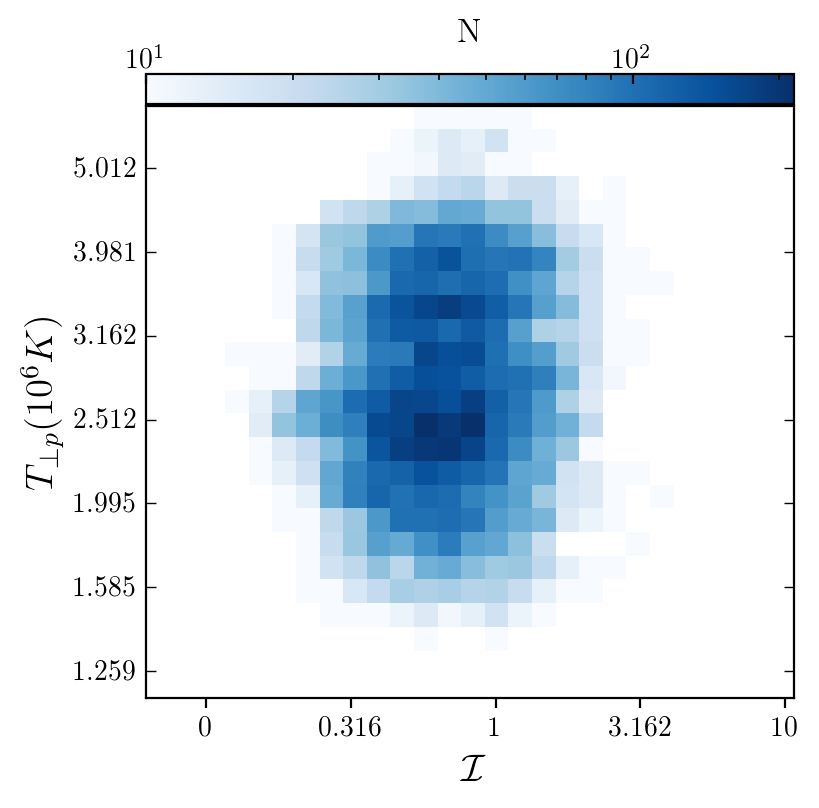

In [ ]:
%%time

def tickformatx(x):
    if int(x) == float(x):
        return str(round(int(10**x), 3))
    else:
        return str(round(10**x, 3))

def tickformaty(x):
    if int(x) == float(x):
        return str(round(int(10**x/1e6), 3))
    else:
        return str(round(10**x/1e6, 3))

axs_ylabel = r'$T_{\perp p} (10^6 K)$'

axs_xlabel = r'$\mathcal{I}$'

cbar_label = r'N'

b_arr_l = np.log10( df_full_mms.pvi )
t_par = 3*df_full_mms.T_p/(2*df_full_mms.r_p*(1+1/(2*df_full_mms.r_p))) * ev_to_k
t_per = t_par*df_full_mms.r_p
t_total = (t_par+2*t_per)/3
#r_arr_l = np.log10( df_full_mms.T_p )
r_arr_l = np.log10(t_per)

# Plotting
vmin=10
#vmax=-1
bins = 25

norm = mpl.colors.LogNorm()
hst1 = plt.hist2d( b_arr_l, r_arr_l, bins=bins, 
                  range=[ [np.nanmin(b_arr_l), np.nanmax(b_arr_l)], [np.nanmin(r_arr_l), np.nanmax(r_arr_l)] ], 
                cmin=5,  norm=norm, density=False, cmap=plt.cm.Spectral )
plt.close()
fig = plt.figure( num=None, figsize=(4,4), dpi=200, facecolor='w', edgecolor='gray' )

fig.subplots_adjust( left=0.17, right=0.98, top=0.9, bottom=0.12, wspace=0.0, hspace=0.0 )
axs1 = fig.add_subplot(1, 1, 1, sharex=None)
#plt.clf()
im1 = axs1.imshow( np.transpose(hst1[0]), origin='lower', 
                  extent=[np.nanmin(b_arr_l), np.nanmax(b_arr_l), np.nanmin(r_arr_l), np.nanmax(r_arr_l)], 
                vmin=vmin, aspect='auto',norm=norm, cmap=plt.cm.Blues )

#axs1.axhline( 0, lw=0.0, c='k' )
axs1.set_xlabel( axs_xlabel, fontsize=14 )
axs1.set_ylabel( axs_ylabel, fontsize=14 )
axs1.get_yaxis().set_tick_params( which='both', direction='in',
labelbottom=True, bottom=True, right=True, width=.5, labelsize=10, 
labelrotation=0 )

fmtx = FuncFormatter( lambda x, pos: tickformatx( x ) )
axs1.xaxis.set_major_formatter( fmtx )

fmty = FuncFormatter( lambda y, pos: tickformaty( y ) )
axs1.yaxis.set_major_formatter( fmty )

divider1 = make_axes_locatable(axs1)
cax1 = divider1.append_axes("top", size="5%", pad=0.01 )
cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
                     fraction=0.05, pad=0.0 )

#cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=18 )
cbar1.ax.tick_params( axis='both', which='both', direction='in', pad=0.01, labeltop=True,
                     labelbottom=False, color='k', top=True, bottom=False )

cbar1.ax.xaxis.set_label_position('top')
cbar1.set_label( 'N', fontsize=12, labelpad=2.50 )

axs1.set_xlim(1.1*np.nanmin(b_arr_l), 1.1*np.nanmax(b_arr_l))
#axs1.set_ylim(0.9*np.nanmin(r_arr_l), 1.1*np.nanmax(r_arr_l))
#axs1.set_ylim( -1, 0.6)

fig_name = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest//brazil_riddhi/Brazil/figures/PVIvsT_hist_masked_lin_mag_mms_per.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')

# PSP stuff

## PSP PVI stuff

### PDF

In [ ]:
# Save the data to a pickle file
fname = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/data/merged/mag/merged_all_encountr1_q2_8H_64.hf'
data = hf.File(fname)
dat = {}

for key in data.keys() :
	dat[key] = data[key].value

df_psp = pd.DataFrame( dat )
df_psp = pd.DataFrame( dat, index=df_psp.datetime.apply(datetime.utcfromtimestamp) )

# Compute the temperature from the thermal speed ( 1/2 m w**2 = 1/2 KT )
mp = 1.673e-27 # Mass of proton
kb = 1.381e-23 # Boltzmann constant

df_psp['Tp'] = ( mp/kb ) * 1.e6 * df_psp['wp1_fit']**2
df_psp['bd'] = abs( df_psp.br/df_psp.bm )

df_fname = fname[:-2] + 'p'
df_psp.to_pickle(df_fname)

In [ ]:
fname = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/data/merged/mag/merged_all_encountr1_q2_8H_64.p'
df_psp = pd.read_pickle(fname)

In [ ]:
df_psp.head()

,bm,bn,br,bt,datetime,n3_fit,n3_fit_uncertainty,na_fit,na_fit_uncertainty,np1_fit,np1_fit_uncertainty,pop3_mtoq,pvi_64_8H,pvi_max_mag_64_8H,v3n,v3r,v3t,van,var,vat,vpn,vpr,vpt,w3_fit,w3_fit_uncertainty,wa_fit,wa_fit_uncertainty,wp1_fit,wp1_fit_uncertainty,Tp,bd
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-11-06 00:00:00.000,98.685956,14.369418,-76.228846,61.004924,1.541462e+09,-5.000000e+30,-5.000000e+30,12.149224,6.074612,259.883896,27.501991,-5.000000e+30,NaN,NaN,-5.000000e+30,-5.000000e+30,-5.000000e+30,32.662374,293.586243,46.952530,32.507019,291.352020,47.298189,-5.000000e+30,-5.000000e+30,21.346448,-1.000000e+31,42.692896,4.593521,220807.332389,0.772439
2018-11-06 00:00:00.873,98.108021,15.149375,-76.081893,60.060184,1.541462e+09,1.537591e+01,2.784048e+00,10.989668,5.494834,274.720734,28.993559,1.000000e+00,1.268193,1.485360,1.232038e+01,3.825855e+02,1.962208e+01,28.465473,302.020630,57.466606,28.095627,297.556335,58.021297,2.440848e+01,4.981201e+00,21.598709,-1.000000e+31,43.197418,4.929474,226056.939975,0.775491
2018-11-06 00:00:01.746,99.140020,20.279177,-75.077253,61.489061,1.541462e+09,1.525488e+01,2.548907e+00,11.057960,5.528980,280.921539,28.527809,1.000000e+00,1.107148,1.200323,6.385208e+00,3.816300e+02,2.635954e+01,30.214157,301.002838,57.363758,29.821323,296.583862,57.916164,2.445231e+01,4.722202e+00,22.552099,-1.000000e+31,45.104198,4.890772,246454.187240,0.757285
2018-11-06 00:00:02.619,99.478348,15.277615,-75.915408,62.445073,1.541462e+09,1.740355e+01,1.485671e+01,13.113138,6.556569,257.937317,41.866432,1.000000e+00,1.279004,1.415277,1.091222e+01,3.741500e+02,2.529547e+01,25.267862,298.190033,51.013100,24.886381,292.981812,51.780491,5.851252e+00,4.939786e-01,21.835445,-1.000000e+31,43.670891,7.393900,231039.568121,0.763135
2018-11-06 00:00:03.492,99.685100,15.796760,-78.439267,59.454713,1.541462e+09,-1.000000e+31,-1.000000e+31,13.043626,6.521813,294.688202,25.405945,-1.000000e+31,1.285723,1.365138,-1.000000e+31,-1.000000e+31,-1.000000e+31,33.990643,291.871338,55.179039,33.990643,291.871338,55.179039,-1.000000e+31,-1.000000e+31,25.235268,-1.000000e+31,50.470535,4.120853,308587.325129,0.786871


In [ ]:
df_psp.pvi_max_mag_64_8H.describe()

count    494843.000000
mean          1.691724
std           1.046000
min           0.045900
25%           0.823413
50%           1.507667
75%           2.392999
max           7.258351
Name: pvi_max_mag_64_8H, dtype: float64

In [ ]:
df_sorted = df_psp.sort_values( by=['pvi_max_mag_64_8H'] )

In [ ]:
n_ind = len( df_sorted.Tp )/6
#ev_to_k = 11604.523
Tp1 = df_sorted.Tp[int(n_ind)*0:int(n_ind)*1]
Tp2 = df_sorted.Tp[int(n_ind)*1:int(n_ind)*2]
Tp3 = df_sorted.Tp[int(n_ind)*2:int(n_ind)*3]
Tp4 = df_sorted.Tp[int(n_ind)*3:int(n_ind)*4]
Tp5 = df_sorted.Tp[int(n_ind)*4:int(n_ind)*5]
Tp6 = df_sorted.Tp[int(n_ind)*5:]


In [ ]:
weight = 500
( binsn1, Tpn1 ) = calc_pdf( Tp1, weight=weight )
( binsn2, Tpn2 ) = calc_pdf( Tp2, weight=weight )
( binsn3, Tpn3 ) = calc_pdf( Tp3, weight=weight )
( binsn4, Tpn4 ) = calc_pdf( Tp4, weight=weight )
( binsn5, Tpn5 ) = calc_pdf( Tp5, weight=weight )
( binsn6, Tpn6 ) = calc_pdf( Tp6, weight=weight )

pvi_0 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*0]
pvi_1 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*1]
pvi_2 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*2]
pvi_3 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*3]
pvi_4 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*4]
pvi_5 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*5]
pvi_6 = df_sorted['pvi_max_mag_64_8H'][int(n_ind)*5:].max()

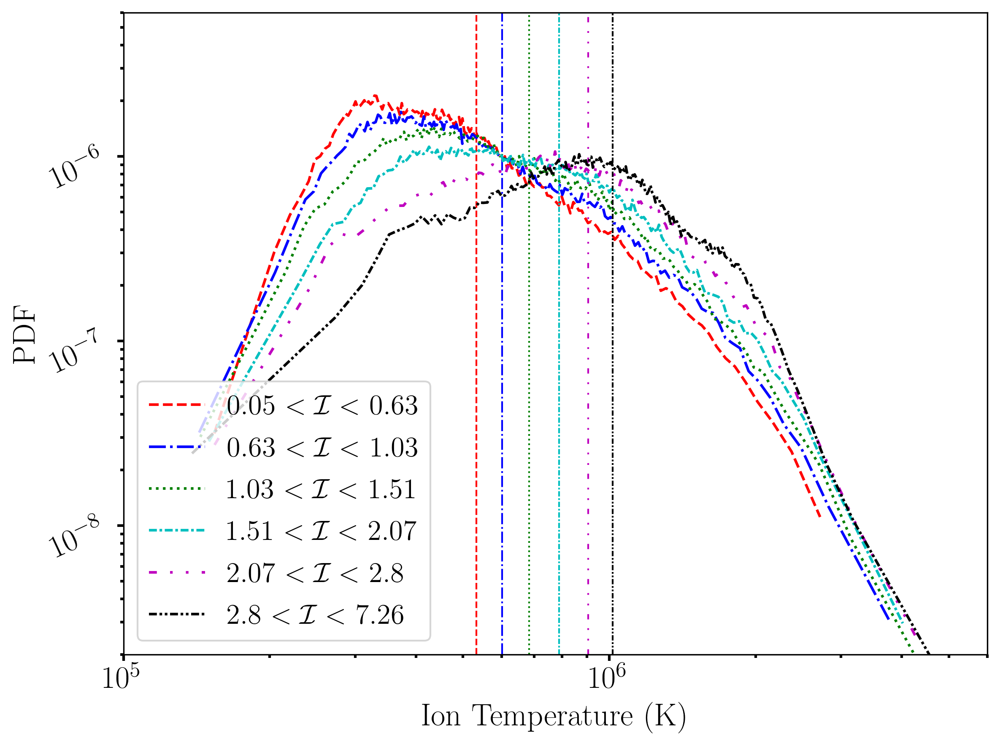

In [ ]:
fig = plt.figure( num=None, figsize=( 8, 6 ), dpi=300, facecolor='w', edgecolor='k' )

axs = fig.add_subplot( 1, 1, 1 )

axs.plot( binsn1, Tpn1, ls='--', lw=1.5, c='r', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_0, 2 ), round( pvi_1, 2 ) ) )
axs.axvline( x=Tp1.median( ), ls='--', lw=1, c='r' )
#axs.annotate("", xy=(Tp1.median(), Tpn1[25]), xytext=(Tp1.median()+1000, Tpn1[20]), arrowprops=dict(headwidth=10, headlength=10, width=10))
#plt.annotate("", xy=(40, 0.11), xytext=(30, 0.01), arrowprops=dict(headwidth=10, headlength=10, width=0.1))
#axs.arrow(x=Tp1.median(), y=Tpn1[25], dx=100, dy=1e-10, ls='-', lw=1, color='k')

axs.plot( binsn2, Tpn2, ls='-.', lw=1.5, c='b', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_1, 2 ), round( pvi_2, 2 ) ) )
axs.axvline( x=Tp2.median( ), ls='-.', lw=1, c='b' )

axs.plot( binsn3, Tpn3, ls=':', lw=1.5, c='g', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_2, 2 ), round( pvi_3, 2 ) ) )
axs.axvline( x=Tp3.median( ), ls=':', lw=1, c='g' )

axs.plot( binsn4, Tpn4, ls=(0,(3,1,1,1)), lw=1.5, c='c', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_3, 2 ), round( pvi_4, 2 ) ) )
axs.axvline( x=Tp4.median( ), ls=(0,(3,1,1,1)), lw=1, c='c' )

axs.plot( binsn5, Tpn5, ls=(0,(3,5,1,5,1,5)), lw=1.5, c='m', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_4, 2 ), round( pvi_5, 2 ) ) )
axs.axvline( x=Tp5.median( ), ls=(0,(3,5,1,5,1,5)), lw=1, c='m' )

axs.plot( binsn6, Tpn6, ls=(0,(3,1,1,1,1,1)), lw=1.5, c='k', 
label=r'%s $< \mathcal{I} <$ %s' %( round( pvi_5, 2 ), round( pvi_6, 2 ) ) )
axs.axvline( x=Tp6.median( ), ls=(0,(3,1,1,1,1,1)), lw=1, c='k' )

axs.set_xlim( 1.0e5, 6.0e6 )
axs.set_ylim( 2.0e-9, 6.e-6 )
axs.set_xscale( 'log' )
axs.set_yscale( 'log' )
axs.legend( fontsize=16, loc=3 )

axs.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=0 )
                                                                 
axs.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=25 )

axs.set_xlabel( 'Ion Temperature (K)', fontsize=18)
axs.set_ylabel( 'PDF', fontsize=18)
#axs.title( 'Dates: %s' %( date ), fontsize=20 )
plt.tight_layout()

fig_name = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/figures/T_pdf_pvi_psp.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')

### Histogram

CPU times: user 697 ms, sys: 375 ms, total: 1.07 s
Wall time: 679 ms


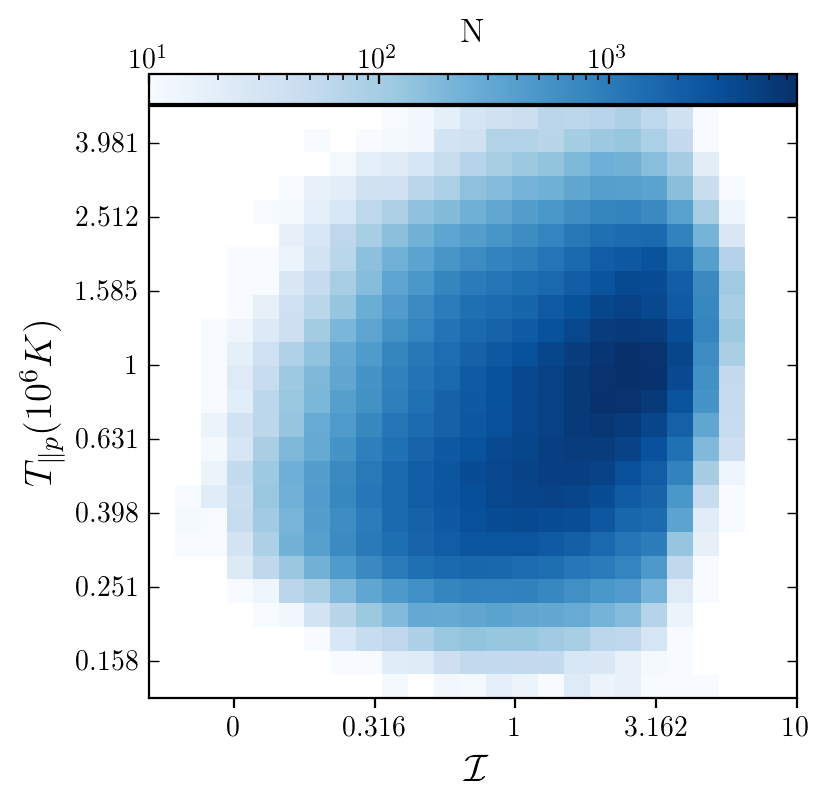

In [ ]:
%%time

from matplotlib.ticker import FuncFormatter

def tickformatx(x):
    if int(x) == float(x):
        return str(round(10**x, 3))
    else:
        return str(round(10**x, 3))

def tickformaty(x):
    if int(x) == float(x):
        return str(round(int(10**x/1e6), 3))
    else:
        return str(round(10**x/1e6, 3))

axs_ylabel = r'$T_{\parallel p} (10^6 K)$'

axs_xlabel = r'$\mathcal{I}$'

cbar_label = r'N'


b_arr_l = np.log10( df_psp.pvi_max_mag_64_8H )
t_par = df_psp.Tp
t_par = t_par.mask(t_par>=1.e7)

r_arr_l = np.log10(t_par)

# Plotting
vmin=10
#vmax=-1
bins = 25

norm = mpl.colors.LogNorm()
hst1 = plt.hist2d( b_arr_l, r_arr_l, bins=bins, 
                  range=[ [-1.3, 1], [5.1, 6.7] ], 
                cmin=5,  norm=norm, density=False, cmap=plt.cm.Spectral )
plt.close()

fig = plt.figure( num=None, figsize=(4,4), dpi=200, facecolor='w', edgecolor='gray' )

fig.subplots_adjust( left=0.17, right=0.98, top=0.9, bottom=0.12, wspace=0.0, hspace=0.0 )
axs1 = fig.add_subplot(1, 1, 1, sharex=None)
#plt.clf()
im1 = axs1.imshow( np.transpose(hst1[0]), origin='lower', 
                  extent=[-1.3, 1, 5.1, 6.7], 
                vmin=vmin, aspect='auto',norm=norm, cmap=plt.cm.Blues )

#axs1.axhline( 0, lw=0.0, c='k' )
axs1.set_xlabel( axs_xlabel, fontsize=14 )
axs1.set_ylabel( axs_ylabel, fontsize=14 )
axs1.get_yaxis().set_tick_params( which='both', direction='in',
labelbottom=True, bottom=True, right=True, width=.5, labelsize=10, 
labelrotation=0 )

fmtx = FuncFormatter( lambda x, pos: tickformatx( x ) )
axs1.xaxis.set_major_formatter( fmtx )

fmty = FuncFormatter( lambda y, pos: tickformaty( y ) )
axs1.yaxis.set_major_formatter( fmty )

divider1 = make_axes_locatable(axs1)
cax1 = divider1.append_axes("top", size="5%", pad=0.01 )
cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
                     fraction=0.05, pad=0.0 )

#cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=18 )
cbar1.ax.tick_params( axis='both', which='both', direction='in', pad=0.01, labeltop=True,
                     labelbottom=False, color='k', top=True, bottom=False )

cbar1.ax.xaxis.set_label_position('top')
cbar1.set_label( 'N', fontsize=12, labelpad=2.50 )

#axs1.set_xlim(1.1*np.nanmin(b_arr_l), 1.1*np.nanmax(b_arr_l))
axs1.set_xlim(-1.3, 1)
axs1.set_ylim(5.1, 6.7)
#axs1.set_ylim(0.9*np.nanmin(r_arr_l), 1.1*np.nanmax(r_arr_l))
#axs1.set_ylim( -1, 0.6)
fig_name = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/figures/PVIvsT_hist_masked_lin_mag_psp_par.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')

In [ ]:
round(10**-1, 3)

0.1

### Osman Plot

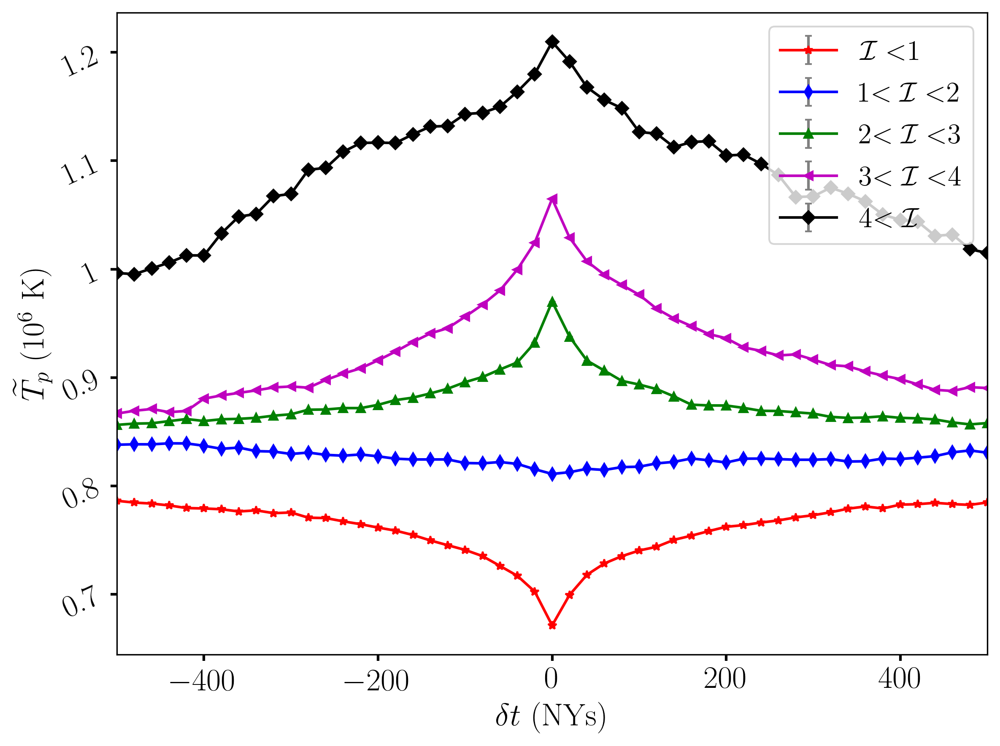

In [ ]:
from matplotlib.ticker import FuncFormatter

# Compute the temperature from the thermal speed ( 1/2 m w**2 = 1/2 KT )
mp = 1.673e-27 # Mass of proton
kb = 1.381e-23 # Boltzmann constant

def tickformat(x):
	if int(x) == float(x):
		return str(int(x))
	else:
		return str(x)

avw = np.loadtxt( '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/codes/avw_q2.txt' )
avw_error = np.loadtxt( '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/codes/avw_error_q2.txt' )

avt = ( mp/kb ) * 1.e6 * avw**2
avt_error = ( mp/kb ) * 1.e6 * avw_error**2

nstep = 51 # Note: Odd number preferable
x_cord = np.linspace( -500, 500, nstep )

fig = plt.figure( num=None, figsize=( 8, 6 ), dpi=300, facecolor='w', edgecolor='k' )

axs = fig.add_subplot( 1, 1, 1 )

axs.errorbar( x_cord, avt[0], yerr=avt_error[0], color='r', marker='*', ls='-',
 ms=5, ecolor='gray', capsize=2, label=r'$\mathcal{I}<$1' )

#axs.axhline( max( avt[0] ), color='r', marker=None, ls=':', lw=1 )

axs.errorbar( x_cord, avt[1], yerr=avt_error[1], color='b', marker='d', ls='-',
 ms=5, ecolor='gray', capsize=2, label=r'1$<\mathcal{I}<$2' )

#axs.axhline( min( avt[1] ), color='b', marker=None, ls=':', lw=1 )

axs.errorbar( x_cord, avt[2], yerr=avt_error[2], color='g', marker='^', ls='-',
 ms=5, ecolor='gray', capsize=2, label=r'2$<\mathcal{I}<$3' )

#axs.axhline( min( avt[2] ), color='g', marker=None, ls=':', lw=1 )

axs.errorbar( x_cord, avt[3], yerr=avt_error[3], color='m', marker='<', ls='-',
 ms=5, ecolor='gray', capsize=2, label=r'3$<\mathcal{I}<$4' )

#axs.axhline( min( avt[3] ), color='m', marker=None, ls=':', lw=1 )

axs.errorbar( x_cord, avt[4], yerr=avt_error[4], color='k', marker='D', ls='-',
 ms=5, ecolor='gray', capsize=2, label=r'4$<\mathcal{I}$' )

#axs.axhline( min( avt[4] ), color='k', marker=None, ls=':', lw=1 )

axs.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=0 )
                                                                 
axs.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=25 )

fmt = FuncFormatter( lambda y, pos: tickformat( y / 1e6 ) )
axs.yaxis.set_major_formatter( fmt )

axs.legend( fontsize=16, loc=1 )

axs.set_xlabel( r'$\delta t$ (NYs)', fontsize=18 )
axs.set_ylabel( r'$\widetilde{T}_p \ (10^6$ K)', fontsize=18 )

axs.set_xlim( -500, 500 )
#axs.set_title( 'Date: %s' %( fname[-16:-8]), fontsize=20 )

plt.tight_layout()
fig_name = 'figures/tem_pvi_lag_psp.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')
clear_output()

In [ ]:
avt[0]

array([786371.75647609, 784720.70447021, 783803.86021736, 782088.69310681,
       779665.7932645 , 779283.10292115, 778562.82521658, 776519.35244097,
       777553.00904089, 774963.46992817, 775583.53102281, 770768.47304758,
       770442.54705742, 767418.1843052 , 764773.47110937, 761650.68613107,
       758865.02065418, 754845.07070373, 749814.09885789, 745404.87525288,
       741078.73943658, 735363.17418538, 726332.15447404, 717192.8488848 ,
       702632.35994271, 671429.58632242, 699572.86042806, 718140.18356132,
       728579.9404749 , 735280.34284243, 740514.92967961, 743939.08169736,
       750380.66057638, 754192.08158479, 758437.4196826 , 762394.94880653,
       763905.94374405, 766328.86942639, 768264.932687  , 771066.1351035 ,
       773053.68109302, 775771.21683192, 779109.20125202, 781125.09482975,
       779285.03887632, 782824.47971132, 783234.68457492, 784504.61799594,
       783329.2164486 , 782586.16586907, 784840.80064267])

### PVI comparisons

In [ ]:
fname = '/content/gdrive/Shareddrives/Casella/SpacePlasFest/psp/data/merged/updated_merged/pvi/psp_swe_fld_merged_pvi_20181106_Hampel_v1.p'
df_psp_p = pd.read_pickle(fname)
df_psp_p.head()

,ssepoch,vpr,vpt,vpn,np_moment,np1_fit,np1_fit_uncertainty,wp_moment,wp1_fit,wp1_fit_uncertainty,sc_pr,sc_pt,sc_pn,carr_latitude,carr_longitude,pvi_den_4_1H,pvi_den_4_4H,pvi_den_4_6H,pvi_den_4_8H,pvi_den_4_12H,pvi_den_20_1H,pvi_den_20_4H,pvi_den_20_6H,pvi_den_20_8H,pvi_den_20_12H,pvi_den_100_1H,pvi_den_100_4H,pvi_den_100_6H,pvi_den_100_8H,pvi_den_100_12H,pvi_vel_4_1H,pvi_vel_4_4H,pvi_vel_4_6H,pvi_vel_4_8H,pvi_vel_4_12H,pvi_vel_20_1H,pvi_vel_20_4H,pvi_vel_20_6H,pvi_vel_20_8H,pvi_vel_20_12H,...,pvi_med_den_100_8H,pvi_max_vel_100_8H,pvi_med_vel_100_8H,pvi_max_mag_100_8H,pvi_med_mag_100_8H,pvi_max_den_4_12H,pvi_med_den_4_12H,pvi_max_vel_4_12H,pvi_med_vel_4_12H,pvi_max_mag_4_12H,pvi_med_mag_4_12H,pvi_max_den_20_12H,pvi_med_den_20_12H,pvi_max_vel_20_12H,pvi_med_vel_20_12H,pvi_max_mag_20_12H,pvi_med_mag_20_12H,pvi_max_den_100_12H,pvi_med_den_100_12H,pvi_max_vel_100_12H,pvi_med_vel_100_12H,pvi_max_mag_100_12H,pvi_med_mag_100_12H,br,bt,bn,smooth_np_moment,bmag,smooth_bmag,vA,Rs,vpm,uv_b_r,Tp,Tp_par,Tp_per,beta,beta_par,beta_per,pa
2018-11-06 00:00:00+00:00,1.541462e+09,285.041199,59.812160,27.730368,384.052979,394.745117,16.861282,53.334908,56.021473,2.360209,-20091352.0,14542780.0,1178557.500,-4.019475,-33.099350,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-76.815369,60.418724,13.536203,384.052979,98.662312,98.662312,109.898700,35.691105,292.566151,-0.778569,344608.000047,NaN,344608.000047,0.469405,NaN,0.469405,-0.778569
2018-11-06 00:00:00.873790+00:00,1.541462e+09,292.045197,62.958790,34.209156,371.725342,390.559082,19.135578,46.013721,50.879692,2.245574,-20091400.0,14542712.0,1178560.250,-4.019478,-33.099300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.340229,1.200469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-76.107502,60.528719,15.336899,377.889160,98.444391,98.553352,110.669007,35.691103,300.706622,-0.773101,256493.864458,NaN,256493.864458,0.344534,NaN,0.344534,-0.773101
2018-11-06 00:00:01.747580+00:00,1.541462e+09,295.096771,60.573952,24.233774,353.397552,358.087006,25.787758,43.656960,45.305042,3.325024,-20091448.0,14542643.0,1178563.000,-4.019480,-33.099251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.173679,1.161091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-75.174839,61.026670,20.749430,371.725342,99.025501,98.662312,111.706138,35.691101,302.222739,-0.759146,230892.185634,NaN,230892.185634,0.304413,NaN,0.304413,-0.759146
2018-11-06 00:00:02.621370+00:00,1.541462e+09,288.476166,56.504486,26.237566,364.735016,407.627472,33.328094,46.072975,55.868549,3.826328,-20091494.0,14542575.0,1178565.875,-4.019483,-33.099201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.407906,1.276638,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-75.527458,62.618237,15.443977,368.230179,99.317455,98.843906,112.441607,35.691098,295.126524,-0.760465,257154.884423,NaN,257154.884423,0.334617,NaN,0.334617,-0.760465
2018-11-06 00:00:03.495160+00:00,1.541462e+09,292.437531,63.029312,28.233130,379.727264,386.417480,19.310688,48.698200,51.753227,2.417718,-20091542.0,14542506.0,1178568.625,-4.019485,-33.099152,0.257686,0.247043,0.132494,0.120425,0.135889,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.272318,1.275336,1.10423,1.053343,1.038489,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.135889,0.135889,1.038489,1.038489,1.336174,1.318333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-78.726631,59.314688,16.527857,371.725342,99.946409,99.025501,112.117342,35.691096,300.482134,-0.787688,287295.010996,NaN,287295.010996,0.376002,NaN,0.376002,-0.787688


In [ ]:
t1 = datetime.strptime('201811060000+0000', '%Y%m%d%H%M%z')
t2 = datetime.strptime('201811060045+0000', '%Y%m%d%H%M%z')
df_new = df_psp_p[(df_psp_p.index>=t1) & (df_psp_p.index<=t2)]

In [ ]:
len(df_psp_p.index), len(df_new.index)

(98874, 3090)

CPU times: user 815 ms, sys: 4.62 ms, total: 819 ms
Wall time: 827 ms


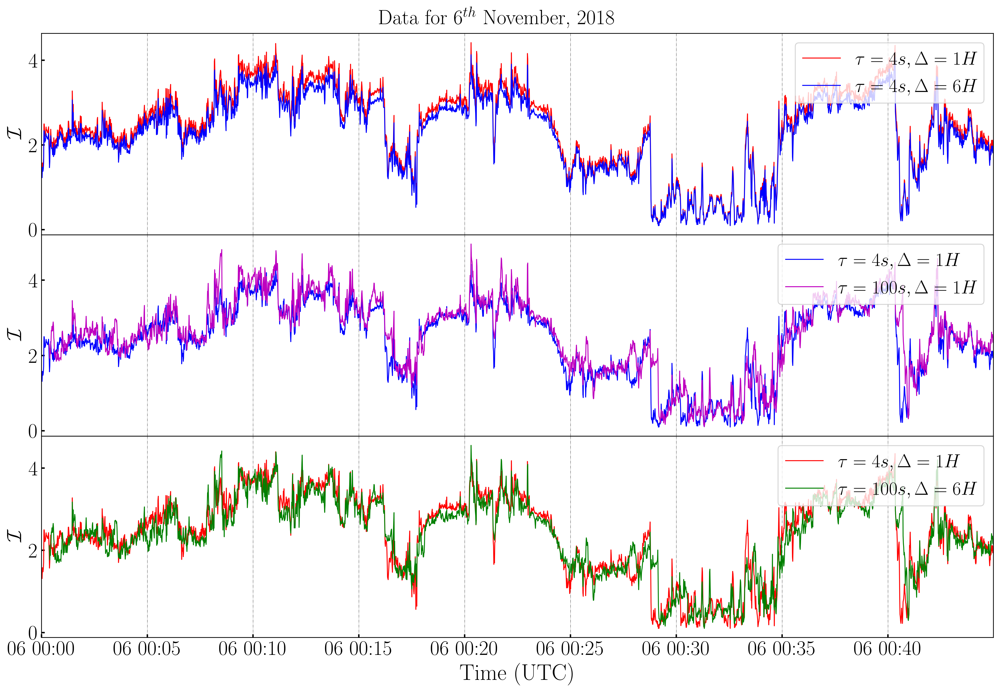

In [ ]:
%%time

t1 = datetime.strptime('201811060000+0000', '%Y%m%d%H%M%z')
t2 = datetime.strptime('201811060045+0000', '%Y%m%d%H%M%z')
df_new = df_psp_p[(df_psp_p.index>=t1) & (df_psp_p.index<=t2)]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 1 # Marker size
legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(15, 10), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.05, right=0.99, top=0.96, bottom=0.065, 
                                                     wspace=0.03, hspace=0 )
axs11 = fig.add_subplot( 3, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

axs11.plot( df_new.index, df_new.pvi_max_mag_4_1H, ms=s, c=c[1], lw=1, label=r'$\tau=4s, \Delta=1H$' )
axs11.plot( df_new.index, df_new.pvi_max_mag_4_6H, ms=s, c=c[0], lw=1, label=r'$\tau=4s, \Delta=6H$' )
axs11.legend(loc=1, ncol=1, fontsize=20)
#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\mathcal{I}$', fontsize=22 )
axs11.get_xaxis().set_tick_params( which='both', direction='in', 
labelbottom=False, bottom=False, width=1.5, labelsize=22, labelrotation=0 )
axs11.get_yaxis().set_tick_params( which='both', direction='in', 
labelbottom=True, bottom=True, width=1.5, labelsize=22, labelrotation=0 )

axs12 = fig.add_subplot( 3, 1, 2, sharex=None )
axs12.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

axs12.plot( df_new.index, df_new.pvi_max_mag_4_1H, ms=s, c=c[0], lw=1, label=r'$\tau=4s, \Delta=1H$' )
axs12.plot( df_new.index, df_new.pvi_max_mag_100_1H, ms=s, c=c[3], lw=1, label=r'$\tau=100s, \Delta=1H$' )
axs12.legend(loc=1, ncol=1, fontsize=20)
#axs12.set_title(graph_time, fontsize=20)
axs12.set_ylabel( r'$\mathcal{I}$', fontsize=22 )
axs12.get_xaxis().set_tick_params( which='both', direction='in', 
labelbottom=False, bottom=False, width=1.5, labelsize=22, labelrotation=0 )
axs12.get_yaxis().set_tick_params( which='both', direction='in', 
labelbottom=True, bottom=True, width=1.5, labelsize=22, labelrotation=0 )

axs13 = fig.add_subplot( 3, 1, 3, sharex=None )
axs13.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )

axs13.plot( df_new.index, df_new.pvi_max_mag_4_1H, ms=s, c=c[1], lw=1, label=r'$\tau=4s, \Delta=1H$' )
axs13.plot( df_new.index, df_new.pvi_max_mag_100_6H, ms=s, c=c[2], lw=1, label=r'$\tau=100s, \Delta=6H$' )
axs13.legend(loc=1, ncol=1, fontsize=20)
#axs13.set_title(graph_time, fontsize=20)
axs13.set_ylabel( r'$\mathcal{I}$', fontsize=22 )
axs13.get_xaxis().set_tick_params( which='both', direction='in', 
labelbottom=True, bottom=True, width=1.5, labelsize=22, labelrotation=0 )
axs13.get_yaxis().set_tick_params( which='both', direction='in', 
labelbottom=True, bottom=True, width=1.5, labelsize=22, labelrotation=0 )

axs11.set_xlim(df_new.index[0], df_new.index[-1])
axs12.set_xlim(df_new.index[0], df_new.index[-1])
axs13.set_xlim(df_new.index[0], df_new.index[-1])

axs13.set_xlabel( 'Time (UTC)', fontsize=24 )

plt.suptitle(r'Data for $6^{th}$ November, 2018', x=0.5, y=0.9998, fontsize=22)
fig_name = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/figures/pvi_comp_psp.pdf'
plt.savefig(fig_name, dpi=200, format='pdf', transparent=True, edgecolor='w', facecolor='w')

In [ ]:
axs11.legend?

# Chapter 7 stuff

## $\gamma_{\max}$ and $\omega_{nl}$ figures

### Simulations

#### 2D cases

In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

om_file_list = [
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dpp.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dip.h5'
#                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5'
                  ]

gamma_file_list = [
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
#               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5'
               ]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

read_data = '1'
for ( xx, yy ) in zip( om_file_list[1:], gamma_file_list[1:] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        # Extract the data

        # Non-linear frequency
        omega = data['om']

	    # gamma values for each region
        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Find out the maximum gamma among all gammas
        gamma_stacked = np.dstack((a_par, b_par, a_per, b_per))
        gamma_max = np.nanmax(gamma_stacked, axis=2)

        gamma_omega = gamma_max/omega

    # Draw the figures

    # Define the value of colorbar padding
    pad = 0.02
    labelsize = 20
    ticklabelsize = 18
    clabelsize = 15

    # Define the figure
    fig = plt.figure( num=None, figsize=( 7, 28 ), dpi=200, facecolor='w',
                                                              edgecolor='gray' )
    fig.subplots_adjust( left=0.03, right=0.99, top=0.99, bottom=0.05, 
    wspace=0.02, hspace=0. )

    if ('Time' in yy ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    axs1 = fig.add_subplot( 1, 3, 1 )

   # Figure 1

    im1 = axs1.imshow( np.transpose( gamma_max ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize,
                         labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize,
                         labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\gamma_{max}/\Omega_p$', fontsize=20 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot( 1, 3, 2 )

    im2 = axs2.imshow( np.transpose( omega ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    vmin=1.1e-4,vmax=1.e1, norm=mpl.colors.LogNorm( vmin=1.e-4, vmax=1e1 ) )
    #norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

#   labels = [ '0.25', '', '', '1.0', '', '', '', '2.0' ]

	#cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=18 )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=clabelsize,
                         labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=clabelsize,
                         labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$\omega_{nl}/\Omega_p$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot( 1, 3, 3 )

    im3 = axs3.imshow( np.transpose( gamma_omega ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
    norm=mpl.colors.LogNorm( vmin=1.1e-3, vmax=1.e1 ) )
    #norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '-1', '', '0', '', '1', '' ]
#   labels = [ '', '-1', '', '0', '', '1', '' ]
    #cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    #cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=12 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize,
                         labelrotation=0 )

    cbar3.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize,
                         labelrotation=0 )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$\gamma_{max}/\omega_{nl}$', fontsize=20 )

    fig_name = f'figures/{xx[64:-3]}_{yy[88:-3]}_ratios.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    #labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    #labels2[0] = ''

    #axs2.set_xticklabels( labels2 )

    #labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    #labels3[0] = ''
    #axs3.set_xticklabels( labels3 )
    #plt.show()
    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.05 )
    plt.close()

/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dip.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5
<KeysViewHDF5 ['om']>
<KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>
CPU times: user 6.62 s, sys: 7.35 s, total: 14 s
Wall time: 19.3 s


In [ ]:
fig_name

'figures/om_mag_2dip_gamma_k_kaw_ti0p6te0p6_Time6000wpe_ratios.pdf'

#### 3D case

In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

om_file_list = ['/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5']

gamma_file_list = ['/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5']

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = '1'
n_pln = 450

for ( xx, yy ) in zip( om_file_list[:], gamma_file_list[:] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        # Extract the data

        # Non-linear frequency
        omega = data['om'][:,:,n_pln]

	    # gamma values for each region
        a_par = gamma[ key[0] ][:,:,n_pln]
        b_par = gamma[ key[1] ][:,:,n_pln]
        a_per = gamma[ key[2] ][:,:,n_pln]
        b_per = gamma[ key[3] ][:,:,n_pln]

        #a_par_mat = np.asmatrix( a_par )
        #b_par_mat = np.asmatrix( b_par )
        #a_per_mat = np.asmatrix( a_per )
        #b_per_mat = np.asmatrix( b_per )

        #a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        #b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        #a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        #b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        #a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        #b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        #a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        #b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        #gamma_max = np.zeros_like(a_par_m)
        #for i in range(np.shape(a_par_m)[0]):
        #    for j in range(np.shape(a_par_m)[1]):
        #        gamma_max[i,j] = np.nanmax( [a_par_m[i,j],  b_par_m[i,j],  a_per_m[i,j],  b_per_m[i,j]])
        #    if (i%10==0):
        #        print(i)

        # Find out the maximum gamma among all gammas
        gamma_stacked = np.dstack((a_par, b_par, a_per, b_per))
        gamma_max = np.nanmax(gamma_stacked, axis=2)

        gamma_omega = gamma_max/omega

    # Draw the figures

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.02
    labelsize = 15
    fig = plt.figure( num=None, figsize=( 15, 45 ), dpi=200, facecolor='w',
                                                              edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.02, hspace=0. )

    if ('Time' in yy ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 41.9, 0, 41.9]

    # Define the axes in the figure

    axs1 = fig.add_subplot( 1, 3, 1 )

   # Figure 1

    im1 = axs1.imshow( np.transpose( gamma_max ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=20 )

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=labelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\gamma_{max}/\Omega_p$', fontsize=20 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot( 1, 3, 2 )

    im2 = axs2.imshow( np.transpose( omega ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    vmin=1.1e-4,vmax=1.e1, norm=mpl.colors.LogNorm( vmin=1.e-4, vmax=1e1 ) )
    #norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

#   labels = [ '0.25', '', '', '1.0', '', '', '', '2.0' ]

	#cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=18 )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$\omega_{nl}/\Omega_p$', fontsize=20 )

    # Figure 3

    axs3 = fig.add_subplot( 1, 3, 3 )

    im3 = axs3.imshow( np.transpose( gamma_omega ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.gray_r, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
    norm=mpl.colors.LogNorm( vmin=1.1e-3, vmax=1.e1 ) )
    #norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=20, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=20 )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( False )

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '-1', '', '0', '', '1', '' ]
#   labels = [ '', '-1', '', '0', '', '1', '' ]
    #cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    #cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=12 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar3.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$\gamma_{max}/\omega_{nl}$', fontsize=20 )

    fig_name = f'figures/{xx[64:-3]}_{yy[88:-3]}_pln_{n_pln}_ratios.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )
    #plt.show()
    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.05 )
    plt.close()

/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5
<KeysViewHDF5 ['om']>
<KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>
CPU times: user 9.64 s, sys: 8.22 s, total: 17.9 s
Wall time: 4min 26s


In [ ]:
fig_name

'figures/om_mag_3d_gamma_k_yan_512_pln_450_ratios.pdf'

### All cases in one

In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

omega_file_list = [
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dpp.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dip.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5'
                  ]

gamma_file_list = [
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5'
               ]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

n_pln = 0

# Read all the data files

read_data = '1'

if (read_data) :

    # Extract the data from 2dpp files
    omega_2dpp = hf.File( omega_file_list[0], 'r+' )
    gamma_2dpp = hf.File( gamma_file_list[0], 'r+' )

    # Non-linear frequency
    omega_2dpp = omega_2dpp['om']

	# gamma values for each region
    a_par_2dpp = gamma_2dpp[ key[0] ]
    b_par_2dpp = gamma_2dpp[ key[1] ]
    a_per_2dpp = gamma_2dpp[ key[2] ]
    b_per_2dpp = gamma_2dpp[ key[3] ]

    # Find out the maximum gamma among all gammas
    gamma_stacked_2dpp = np.dstack((a_par_2dpp, b_par_2dpp, a_per_2dpp, b_per_2dpp))
    gamma_max_2dpp = np.nanmax(gamma_stacked_2dpp, axis=2)

    gamma_omega_2dpp = gamma_max_2dpp/omega_2dpp

    # Extract the data from 2dip files
    omega_2dip = hf.File( omega_file_list[1], 'r+' )
    gamma_2dip = hf.File( gamma_file_list[1], 'r+' )

    # Non-linear frequency
    omega_2dip = omega_2dip['om']

	# gamma values for each region
    a_par_2dip = gamma_2dip[ key[0] ]
    b_par_2dip = gamma_2dip[ key[1] ]
    a_per_2dip = gamma_2dip[ key[2] ]
    b_per_2dip = gamma_2dip[ key[3] ]

    # Find out the maximum gamma among all gammas
    gamma_stacked_2dip = np.dstack((a_par_2dip, b_par_2dip, a_per_2dip, b_per_2dip))
    gamma_max_2dip = np.nanmax(gamma_stacked_2dip, axis=2)

    gamma_omega_2dip = gamma_max_2dip/omega_2dip

    # Extract the data from 3d files
    omega_3d = hf.File( omega_file_list[2], 'r+' )
    gamma_3d = hf.File( gamma_file_list[2], 'r+' )

    # Non-linear frequency
    omega_3d = omega_3d['om'][:,:,n_pln]

	# gamma values for each region
    a_par_3d = gamma_3d[ key[0] ][:,:,n_pln]
    b_par_3d = gamma_3d[ key[1] ][:,:,n_pln]
    a_per_3d = gamma_3d[ key[2] ][:,:,n_pln]
    b_per_3d = gamma_3d[ key[3] ][:,:,n_pln]

    # Find out the maximum gamma among all gammas
    gamma_stacked_3d = np.dstack((a_par_3d, b_par_3d, a_per_3d, b_per_3d))
    gamma_max_3d = np.nanmax(gamma_stacked_3d, axis=2)

    gamma_omega_3d = gamma_max_3d/omega_3d

CPU times: user 5.11 s, sys: 3.75 s, total: 8.85 s
Wall time: 2min 30s


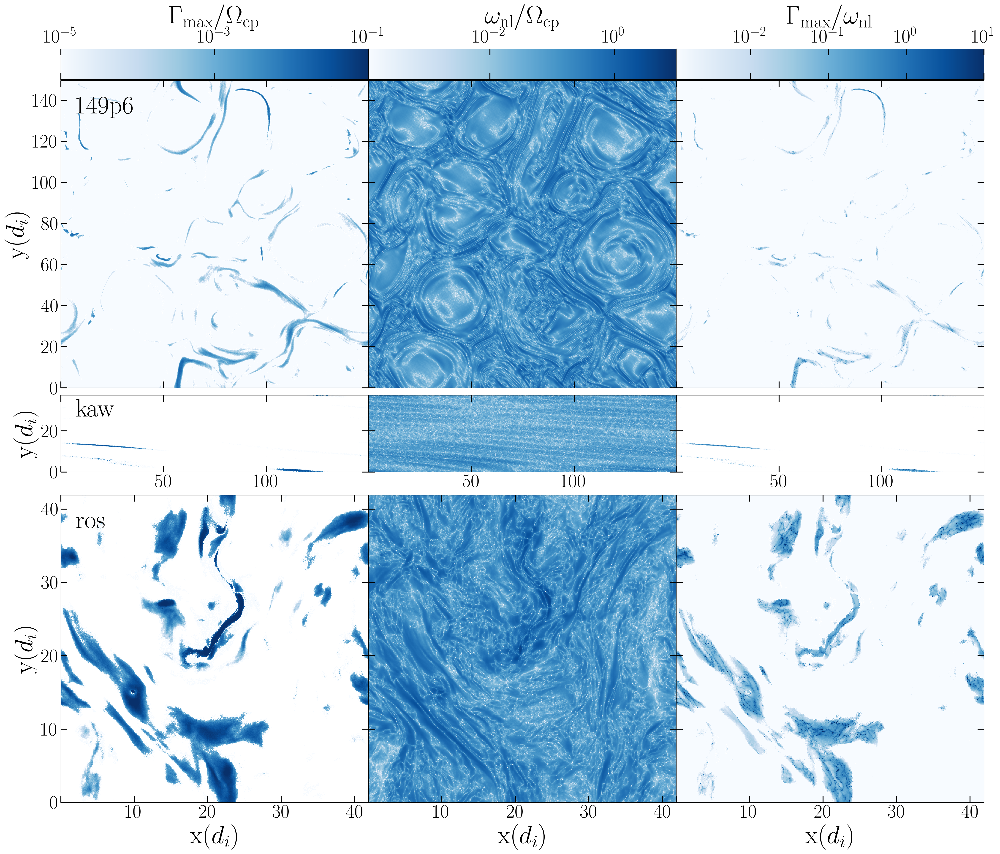

CPU times: user 51.8 s, sys: 6.62 s, total: 58.4 s
Wall time: 51.2 s


In [ ]:
%%time
data_type = ['149p6', 'kaw', 'ros']
mk_figure = '1'
if (mk_figure) :

    # Draw the figures

    # Define the value of colorbar padding
    pad = 0.02
    labelsize = 40
    ticklabelsize = 30
    clabelsize = 30
    labelpad = 10
    tick_width = 1.5
    tick_length = 10
    cmap = plt.cm.Blues
    # Define the figure
    fig = plt.figure( num=None, figsize=( 21, 18 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.03, right=0.99, top=0.99, bottom=0.05, wspace=0., hspace=0.01 )

    extent_2dpp = [0, 149.6, 0, 149.6]
    extent_2dip = [0, 149.6, 0, 37.4]
    extent_3d   = [0, 41.9, 0, 41.9]

    # Define the axes in the figure

    # Figure 1
    gs = gridspec.GridSpec(9, 3, width_ratios=[1, 1, 1]) 
    axs1 = fig.add_subplot( gs[0:4,0:1] )

    im1 = axs1.imshow( np.transpose( gamma_max_2dpp ), aspect='equal', origin='lower',
                      extent=extent_2dpp, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im1.axes.tick_params( axis='both', which='both', direction='in',
    labelbottom=False, bottom=True, labelleft=True, left=True, labeltop=False, top=True, 
    labelright=False, right=True, width=tick_width, length=tick_length, labelsize=ticklabelsize,
    labelrotation=0 )

    axs1.text(0.05, 0.95, data_type[0], horizontalalignment='left', fontsize=labelsize,
                          verticalalignment='top', transform= axs1.transAxes)
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Create a new axis for colorbar
    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar
    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=True, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=True, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=labelsize, labelpad=labelpad )

    # Figure 2
    axs2 = fig.add_subplot( gs[0:4,1:2] )

    im2 = axs2.imshow( np.transpose( omega_2dpp ), aspect='equal', origin='lower',
                      extent=extent_2dpp, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm( vmin=1.1e-4, vmax=1e1 ) )

    im2.axes.tick_params( axis='both', which='both', direction='in', labelbottom=False, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, labelright=False,
                         right=True, width=tick_width, length=tick_length, labelsize=ticklabelsize,
                         labelrotation=0 )

    axs2.get_yaxis().set_visible( True )

    # Create a new axis for colorbar
    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar
    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, fraction=0.05, pad=0)

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar
    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=True, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=True, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$\omega_{\rm nl}/\Omega_{\rm cp}$', fontsize=labelsize, labelpad=labelpad )

    # Figure 3
    axs3 = fig.add_subplot( gs[0:4,2:3] )

    im3 = axs3.imshow( np.transpose( gamma_omega_2dpp ), aspect='equal', origin='lower',
                      extent=extent_2dpp, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm( vmin=1.1e-3, vmax=1.e1 ) )

    im3.axes.tick_params( which='both', direction='in', labelbottom=False, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, right=True, 
                         labelright=False, width=tick_width, length=tick_length, 
                         labelsize=ticklabelsize, labelrotation=0 )

    axs3.get_yaxis().set_visible( True )

    # Create a new axis for colorbar
    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar
    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, fraction=0.05, pad=0)

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar
    cbar3.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=True, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar3.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=False, 
                         labelbottom=False, bottom=False, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$\Gamma_{\max}/\omega_{\rm nl}$', fontsize=labelsize, labelpad=labelpad )

    # Figure 4
    axs4 = fig.add_subplot( gs[4:5,0:1] )

    im4 = axs4.imshow( np.transpose( gamma_max_2dip ), aspect='equal', origin='lower', 
                      extent=extent_2dip, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im4.axes.tick_params( axis='both', which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=True, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length, 
                         labelsize=ticklabelsize, labelrotation=0 )

    axs4.text(0.05, 0.95, data_type[1], horizontalalignment='left', fontsize=labelsize,
                          verticalalignment='top', transform= axs4.transAxes)
    axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Figure 5
    axs5 = fig.add_subplot( gs[4:5,1:2])

    im5 = axs5.imshow( np.transpose( omega_2dip ), aspect='equal', origin='lower',
                      extent=extent_2dip, interpolation='nearest', cmap=cmap, vmin=1.1e-4,
                      vmax=1.e1, norm=mpl.colors.LogNorm( vmin=1.e-4, vmax=1e1 ) )

    im5.axes.tick_params( axis='both', which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length,
                         labelsize=ticklabelsize, labelrotation=0 )

    axs5.get_yaxis().set_visible( True )

    # Figure 6
    axs6 = fig.add_subplot( gs[4:5,2:3] )

    im6 = axs6.imshow( np.transpose( gamma_omega_2dip ), aspect='equal', origin='lower', 
                      extent=extent_2dip, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm( vmin=1.1e-3, vmax=1.e1 ) )

    im6.axes.tick_params( which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length,
                         labelsize=ticklabelsize, labelrotation=0 )

    axs6.get_yaxis().set_visible( True )


    # Figure 7
    axs7 = fig.add_subplot( gs[5:9,0:1] )
    im7 = axs7.imshow( np.transpose( gamma_max_3d ), aspect='equal', origin='lower',
                      extent=extent_3d, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im7.axes.tick_params( axis='both', which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=True, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length,
                         labelsize=ticklabelsize, labelrotation=0 )

    axs7.text(0.05, 0.95, data_type[2], horizontalalignment='left', fontsize=labelsize,
                          verticalalignment='top', transform= axs7.transAxes)
    axs7.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs7.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Figure 8
    axs8 = fig.add_subplot( gs[5:9,1:2] )

    im8 = axs8.imshow( np.transpose( omega_3d ), aspect='equal', origin='lower', extent=extent_3d,
                      interpolation='nearest', cmap=cmap, vmin=1.1e-4, vmax=1.e1, 
                      norm=mpl.colors.LogNorm( vmin=1.e-4, vmax=1e1 ) )

    im8.axes.tick_params( axis='both', which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length,
                         labelsize=ticklabelsize, labelrotation=0 )

    axs8.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    axs8.get_yaxis().set_visible( True )

    # Figure 9
    axs9 = fig.add_subplot( gs[5:9,2:3] )

    im9 = axs9.imshow( np.transpose( gamma_omega_3d ), aspect='equal', origin='lower',
                      extent=extent_3d, interpolation='nearest', cmap=cmap,
                      norm=mpl.colors.LogNorm( vmin=1.1e-3, vmax=1.e1 ) )

    im9.axes.tick_params( which='both', direction='in', labelbottom=True, bottom=True,
                         labelleft=False, left=True, labeltop=False, top=True, right=True,
                         labelright=False, width=tick_width, length=tick_length,
                         labelsize=ticklabelsize, labelrotation=0 )

    axs9.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs9.get_yaxis().set_visible( True )

    axs9.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #plt.close( 'all' )

    plt.savefig( 'figures/all_sim_gamma_omega_ratios.pdf', bbox_inches='tight', pad_inches=0.02 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )

    labels6 = [ item.get_text() for item in axs6.get_xticklabels() ]
    labels6[0] = ''
    axs6.set_xticklabels( labels6 )

    labels7 = [ item.get_text() for item in axs7.get_xticklabels() ]
    labels7[0] = ''
    axs7.set_xticklabels( labels7 )

    labels8 = [ item.get_text() for item in axs8.get_xticklabels() ]
    labels8[0] = ''
    axs8.set_xticklabels( labels8 )

    labels9 = [ item.get_text() for item in axs9.get_xticklabels() ]
    labels9[0] = ''
    axs9.set_xticklabels( labels9 )

    plt.savefig( 'figures/all_sim_gamma_omega_ratios_blues.pdf', bbox_inches='tight', pad_inches=0.02 )
    plt.show()
    plt.close()

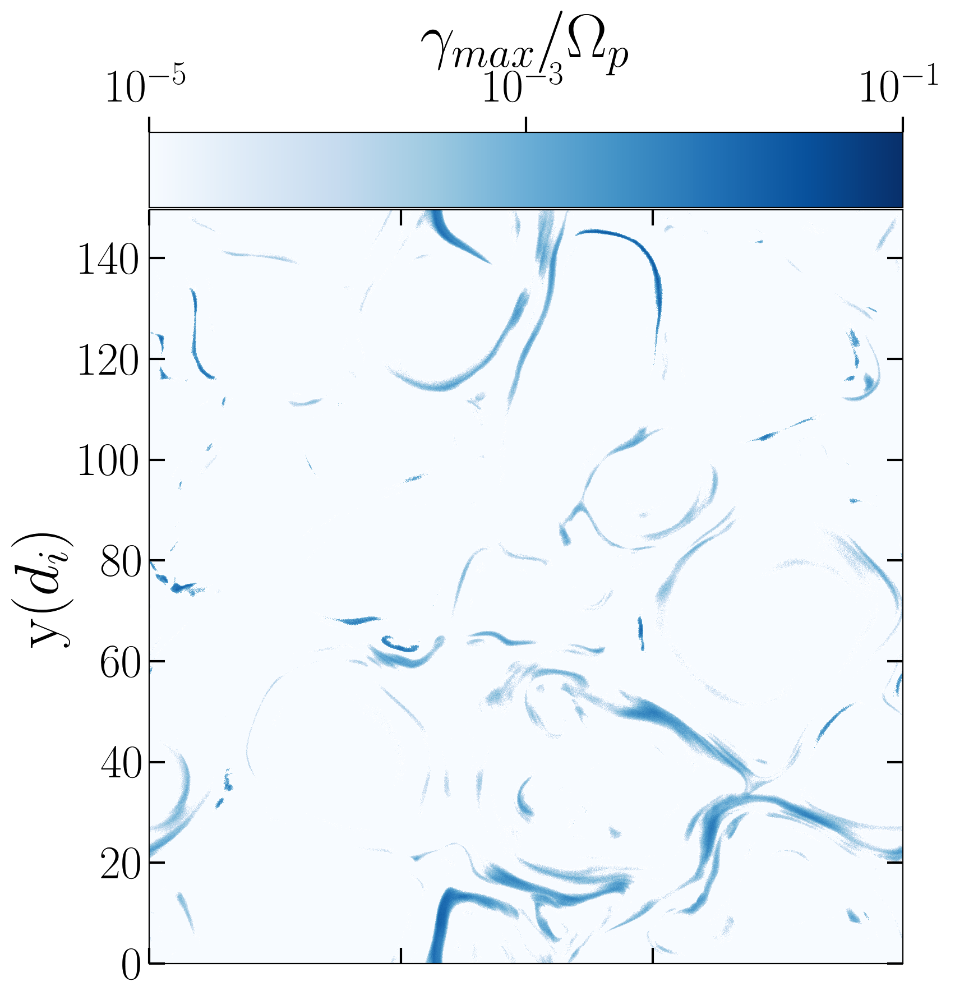

In [ ]:
mk_figure = '1'
if (mk_figure) :

    # Draw the figures

    # Define the value of colorbar padding
    pad = 0.02
    labelsize = 40
    ticklabelsize = 30
    clabelsize = 30
    labelpad = 8
    tick_width = 1.5
    tick_length = 10
    cmap = plt.cm.Blues
    # Define the figure
    fig = plt.figure( num=None, figsize=( 21, 18 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.03, right=0.99, top=0.99, bottom=0.05, wspace=0., hspace=0.01 )

    extent_2dpp = [0, 149.6, 0, 149.6]
    extent_2dip = [0, 149.6, 0, 37.4]
    extent_3d   = [0, 41.9, 0, 41.9]

    # Define the axes in the figure

    # Figure 1
    gs = gridspec.GridSpec(9, 3, width_ratios=[1, 1, 1]) 
    axs1 = fig.add_subplot( gs[0:4,0:1] )

    im1 = axs1.imshow( np.transpose( gamma_max_2dpp ), aspect='equal', origin='lower',
                      extent=extent_2dpp, interpolation='nearest', cmap=cmap, vmin=1e-5, vmax=1e-1,
                      norm=mpl.colors.LogNorm(vmin=1.e-5, vmax=1.e-1 ) )

    im1.axes.tick_params( axis='both', which='both', direction='in',
    labelbottom=False, bottom=True, labelleft=True, left=True, labeltop=False, top=True, 
    labelright=False, right=True, width=tick_width, length=tick_length, labelsize=ticklabelsize,
    labelrotation=0 )

    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )

    # Create a new axis for colorbar
    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar
    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=tick_width, length=tick_length, 
                         labelsize=clabelsize, labelrotation=0 )

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\gamma_{max}/\Omega_p$', fontsize=labelsize, labelpad=labelpad )


### MMS

In [ ]:
# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_1_gamma_kdi_pvi_v02.p')
omnl = hf.File('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/omega/omega_mms_20171226_1.h5')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
k_a_par = df.k_a_par
k_b_par = df.k_b_par

g_a_per = df.g_a_per
g_b_per = df.g_b_per
k_a_per = df.k_a_per
k_b_per = df.k_b_per

r_p = df.r_p
b_p = df.b_p

omega = omnl['omnl']

x = df.index

In [ ]:
gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

gamma_omega = gamma_max/omega[:]

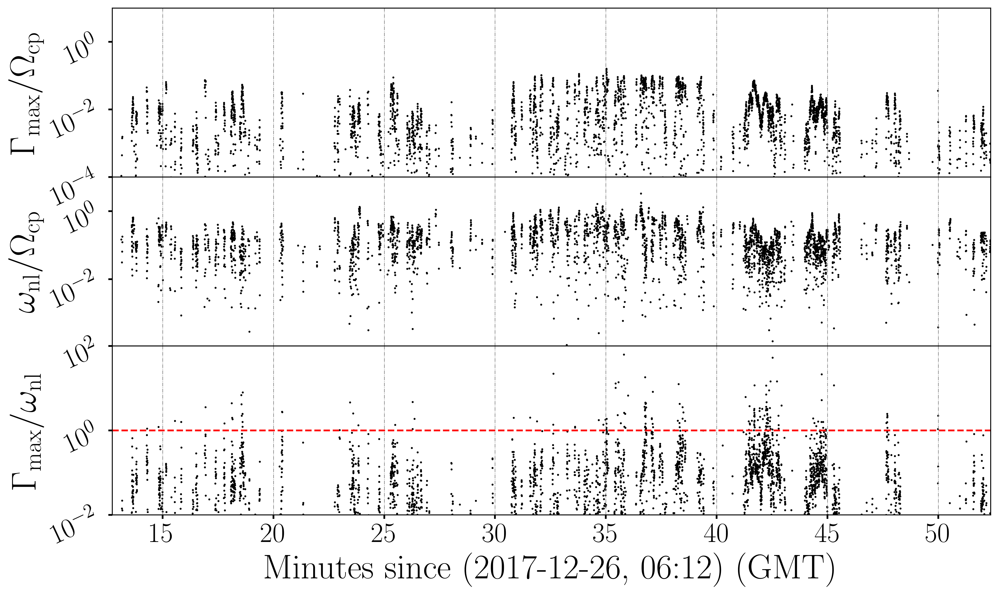

CPU times: user 4.29 s, sys: 73.7 ms, total: 4.36 s
Wall time: 4.32 s


In [ ]:
%%time

t1 = df.index[0]
t2 = df.index[-1]

indices = np.where((x>= t1) & (x<=t2))[0]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 2 # Marker size
labelsize = 30
ticklabelsize = 24

legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.11, right=0.99, top=0.99, bottom=0.12, 
                                                     wspace=0.03, hspace=0 )

axs11 = fig.add_subplot( 3, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs11.scatter( x[indices], gamma_max[indices], marker=mk[0], s=s, c=c[4] )

tt = x[indices]
#graph_time = str(np.min(tt).year) + '-' + \
#             str(np.min(tt).month) + '-' + \
#             str(np.min(tt).day) + ' to ' + \
#             str(np.max(tt).year) + '-' + \
#             str(np.max(tt).month) + '-' + \
#             str(np.max(tt).day)
axs11.set_yscale('log')
axs11.set_ylim(1e-4, 1e1)
#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=labelsize )

axs11.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs11.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )

axs21 = fig.add_subplot( 3, 1, 2, sharex=axs11 )
axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs21.scatter( x[indices], omega[indices], marker=mk[0], s=s, c=c[4] )
axs21.set_ylabel( r'$\omega_{\rm nl}/\Omega_{\rm cp}$', fontsize=labelsize )
axs21.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.set_ylim( 1.1e-4, 1e1 )
axs21.set_yscale( 'log' )

axs41 = fig.add_subplot( 3, 1, 3, sharex=axs11 )
axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs41.scatter( x[indices], gamma_omega[indices], marker=mk[0], s=s, c=c[4] )
axs41.hlines(y=1, xmin=x[0], xmax=x[-1], ls='--', lw=1.5, colors='r')
#lgnd4 = axs41.legend(fontsize=16, numpoints=1)
#lgnd4.legendHandles[0]._sizes = [20]
#lgnd4.legendHandles[1]._sizes = [20]
axs41.set_ylabel( r'$\Gamma_{\max}/\omega_{\rm nl}$', fontsize=labelsize )

axs41.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )
axs41.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs41.set_ylim( 1e-2, 1.e2 )
axs41.set_yscale( 'log' )
axs41.set_xlim(t1, t2)
date_form = DateFormatter("%M")
axs41.xaxis.set_major_formatter(date_form)
#fig.autofmt_xdate()

ddd = t1.strftime('%Y-%m-%d, %H:%M')
axs41.set_xlabel( f'Minutes since ({ddd}) (GMT)', fontsize=labelsize )
plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/figures/mms_gamma_omega_ratio_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf', dpi=400, format='pdf', bbox_inches = 'tight', pad_inches = 0.05)
plt.show()
plt.close( 'all' )

### WIND

In [ ]:
# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/data/all_wind_data_v02.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
k_a_par = df.k_a_par
k_b_par = df.k_b_par

g_a_per = df.g_a_per
g_b_per = df.g_b_per
k_a_per = df.k_a_per
k_b_per = df.k_b_per

r_p = df.r_p
b_p = df.b_p

cf = 1.e-5
omega = df.omnl

x = df.index

In [ ]:
gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

gamma_omega = gamma_max/omega[:]

In [ ]:
t1 = datetime.strptime('2003051100', '%Y%m%d%H')
t2 = datetime.strptime('2003052000', '%Y%m%d%H')

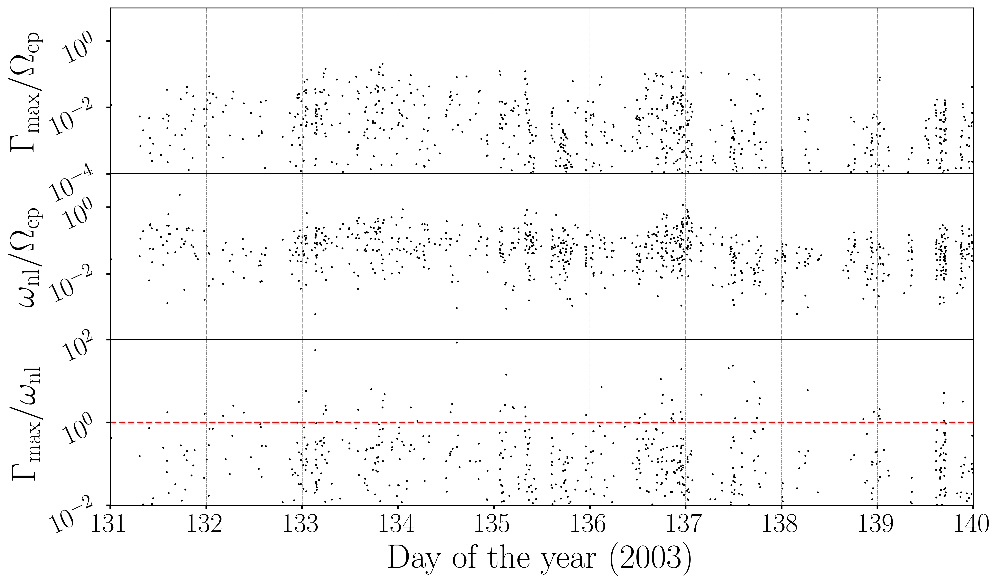

CPU times: user 3.73 s, sys: 55.5 ms, total: 3.79 s
Wall time: 3.76 s


In [ ]:
%%time

indices = np.where((x>= t1) & (x<=t2))[0]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 2 # Marker size
labelsize = 30
ticklabelsize = 24

legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.11, right=0.99, top=0.99, bottom=0.12, 
                                                     wspace=0.03, hspace=0 )

axs11 = fig.add_subplot( 3, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs11.scatter( x[indices], gamma_max[indices], marker=mk[0], s=s, c=c[4] )

tt = x[indices]
#graph_time = str(np.min(tt).year) + '-' + \
#             str(np.min(tt).month) + '-' + \
#             str(np.min(tt).day) + ' to ' + \
#             str(np.max(tt).year) + '-' + \
#             str(np.max(tt).month) + '-' + \
#             str(np.max(tt).day)
axs11.set_yscale('log')
axs11.set_ylim(1e-4, 1e1)

#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=labelsize )

axs11.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs11.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )

axs21 = fig.add_subplot( 3, 1, 2, sharex=axs11 )
axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs21.scatter( x[indices], omega[indices], marker=mk[0], s=s, c=c[4] )
axs21.set_ylabel( r'$\omega_{\rm nl}/\Omega_{\rm cp}$', fontsize=labelsize )
axs21.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.set_ylim( 1.1e-4, 1e1 )
axs21.set_yscale( 'log' )

axs41 = fig.add_subplot( 3, 1, 3, sharex=axs11 )
axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs41.scatter( x[indices], gamma_omega[indices], marker=mk[0], s=s, c=c[4] )
axs41.hlines(y=1, xmin=x[0], xmax=x[-1], ls='--', lw=1.5, colors='r')
#lgnd4 = axs41.legend(fontsize=16, numpoints=1)
#lgnd4.legendHandles[0]._sizes = [20]
#lgnd4.legendHandles[1]._sizes = [20]
axs41.set_ylabel( r'$\Gamma_{\max}/\omega_{\rm nl}$', fontsize=labelsize )

axs41.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )
axs41.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs41.set_ylim( 1e-2, 1.e2 )
axs41.set_yscale( 'log' )
axs41.set_xlim(t1, t2)
date_form = DateFormatter("%j")
axs41.xaxis.set_major_formatter(date_form)
#fig.autofmt_xdate()

ddd = t1.strftime('%Y')
axs41.set_xlabel( f'Day of the year ({ddd})', fontsize=labelsize )
plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/figures/wnd_gamma_omega_ratio_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf', dpi=400, format='pdf', bbox_inches = 'tight', pad_inches = 0.05)
plt.show()
plt.close( 'all' )

In [ ]:
f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/figures/wnd_gamma_omega_ratio_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf'

'/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/figures/wnd_gamma_omega_ratio_2003-5-11_2003-5-19_01207878_01212368.pdf'

### PSP

#### Calculate non-linear time scales

In [ ]:
#@title Function for non-linear time calculation

###############################################################################
## Function to calculate non-linear omega
###############################################################################

def calc_omnl( b_x, bm, n_p, vr, wp, k_max, i ) :

    #print ( i )
    pi = np.pi
    qp = 1.6e-19   # Charge of proton in C
    mp = 1.67e-27  # Mass of proton in kg
    mu0 = 4.0*np.pi*1e-7    # Vacuum permeability 

    # High-cadence Magnetic field

    bxh = b_x*1.e-9
#    bxh = dat_mag['b_x_high'][:]*1e-9
#    t   = dat_mag['time_mag'][:]
    dt   = 0.87379

    # Btot for the period
    btot = bm * 1e-9   # nT to T

    # proton cyclotron frequency
    omcp = (qp*btot)/mp

    # Density
    ne = n_p
    ne = ne*1e6    #/cm^3 to /m^3

    vax = bxh/np.sqrt(mu0*mp*ne)   # Alfven unit

    n = len(b_x)

    # Calculate di in km

    di = 2.28e2/((ne/1e6)**0.5)

    # Calculate Vsw in km/s
    Vsw = vr

    dl = wp/(k_max * omcp)     # dl = 1di
    dtau = dl/Vsw    # Spatial lag to time lag

    m = int(dtau/dt)

    # Go to the mid point of high-cadence B
    # and calculate nlin-time by going +/- m steps

    db = vax[int(n/2)+m+1] - vax[int(n/2)-m-1]    # x is the longitudinal dir.
    tnl = (dl*1e3)/abs(db)  # unit s
 
    omnl =  (2.0*np.pi)/(tnl*omcp)   # in units of 1/omcp

    return omnl, dl, di

In [ ]:
# Read the data
dfn = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/psp/jia/psp_gamma_k_e1_v3.p')

In [ ]:
t1 = datetime.strptime('31Oct2018', '%d%b%Y')
t2 = datetime.strptime('11Nov2018', '%d%b%Y')

In [ ]:
df = dfn[(dfn.index>t1) & (dfn.index<=t2)]

In [ ]:
file_list = np.sort(glob('/content/gdrive/Shareddrives/Casella/SpacePlasFest/psp/data/merged/updated_merged/pvi/e1/*.p'))
print(f'Toral {len(file_list)} relevant files founds')

Toral 12 relevant files founds


In [ ]:
%%time

ldf = []
for f in file_list :
    df_temp = pd.read_pickle(f)
    ldf.append(df_temp)
    df_temp=None

df_pvi = pd.concat(ldf)
df_pvir = df_pvi.resample('0.87379S').median()

CPU times: user 2.07 s, sys: 460 ms, total: 2.53 s
Wall time: 3.08 s


In [ ]:
new_index = df.index.tz_localize(tz='UTC')
df.index = new_index

In [ ]:
%%time
dt = timedelta(seconds=5)

tmin = df.index[:] - dt
tmax = df.index[:] + dt

omnl = np.full( np.shape( df.index ), np.nan )
dl = np.full( np.shape( df.index ), np.nan )
di = np.full( np.shape( df.index ), np.nan )
k_max = np.full( np.shape( df.index ), np.nan )
ind1 = 2896
ind2 = 2898
for i in range(len(df.index[:])) :
#for i in range(0, 3000) :
    try :
        if (np.nanmax([df.g_a_par[i], df.g_b_par[i], df.g_a_per[i], df.g_b_per[i]]) < 1e-5) :
            k_max[i] = np.nan
        elif (np.nanmax([df.g_a_par[i], df.g_b_par[i], df.g_a_per[i], df.g_b_per[i]]) == df.g_a_par[i]) :
            k_max[i] = df.k_a_par[i]
        elif (np.nanmax([df.g_a_par[i], df.g_b_par[i], df.g_a_per[i], df.g_b_per[i]]) == df.g_b_par[i]) :
            k_max[i] = df.k_b_par[i]
        elif (np.nanmax([df.g_a_par[i], df.g_b_par[i], df.g_a_per[i], df.g_b_per[i]]) == df.g_a_per[i]) :
            k_max[i] = df.k_a_per[i]
        elif (np.nanmax([df.g_a_par[i], df.g_b_par[i], df.g_a_per[i], df.g_b_per[i]]) == df.g_b_per[i]) :
            k_max[i] = df.k_b_per[i]

        if not np.isnan(k_max[i]) :

            b_x = df_pvir.br[(df_pvir.index[:] > tmin[i]) & (df_pvir.index[:] < tmax[i])].values

            b_m = np.mean(df_pvir.bmag[(df_pvir.index[:] > tmin[i]) & (df_pvir.index[:] < tmax[i])].values)
            n_p = np.mean(df_pvir.smooth_np_moment[(df_pvir.index[:] > tmin[i]) & (df_pvir.index[:] < tmax[i])].values)
            v_r = np.mean(df_pvir.vpr[(df_pvir.index[:] > tmin[i]) & (df_pvir.index[:] < tmax[i])].values)
            w_p = np.mean(df_pvir.wp_moment[(df_pvir.index[:] > tmin[i]) & (df_pvir.index[:] < tmax[i])].values)
            omnl[i], dl[i], di[i] = calc_omnl(b_x, b_m, n_p, v_r, w_p, k_max[i], i)
    except :
        pass

In [ ]:
df['omnl'] = omnl
df['dl'] = dl
df['di'] = di

In [ ]:
df.to_pickle('psp_e1_gamma_omega_data.p')

In [ ]:
dft = pd.read_pickle('psp_e1_gamma_omega_data.p')

,betapara_core,betaparamom,tani_core,tanimom,time_series,g_a_par,g_b_par,g_a_per,g_b_per,k_a_par,k_b_par,k_a_per,k_b_per,omnl,dl,di
time_series,,,,,,,,,,,,,,,,
2018-10-31 00:00:30+00:00,NaN,NaN,NaN,NaN,1.540944e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31 00:00:40+00:00,NaN,NaN,NaN,NaN,1.540944e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31 00:00:50+00:00,NaN,NaN,NaN,NaN,1.540944e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31 00:01:00+00:00,NaN,NaN,NaN,NaN,1.540944e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-10-31 00:01:10+00:00,NaN,NaN,NaN,NaN,1.540944e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Read the data

In [ ]:
df = pd.read_pickle('data/psp_e1_gamma_omega_data.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
k_a_par = df.k_a_par
k_b_par = df.k_b_par

g_a_per = df.g_a_per
g_b_per = df.g_b_per
k_a_per = df.k_a_per
k_b_per = df.k_b_per

omega = df.omnl

x = df.index

In [ ]:
gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

gamma_omega = gamma_max/omega[:]

In [ ]:
t1 = datetime.strptime('05Nov2018 +0000', '%d%b%Y %z')
t1, x[0]

(datetime.datetime(2018, 11, 5, 0, 0, tzinfo=datetime.timezone.utc),
 Timestamp('2018-10-31 00:00:30+0000', tz='UTC'))

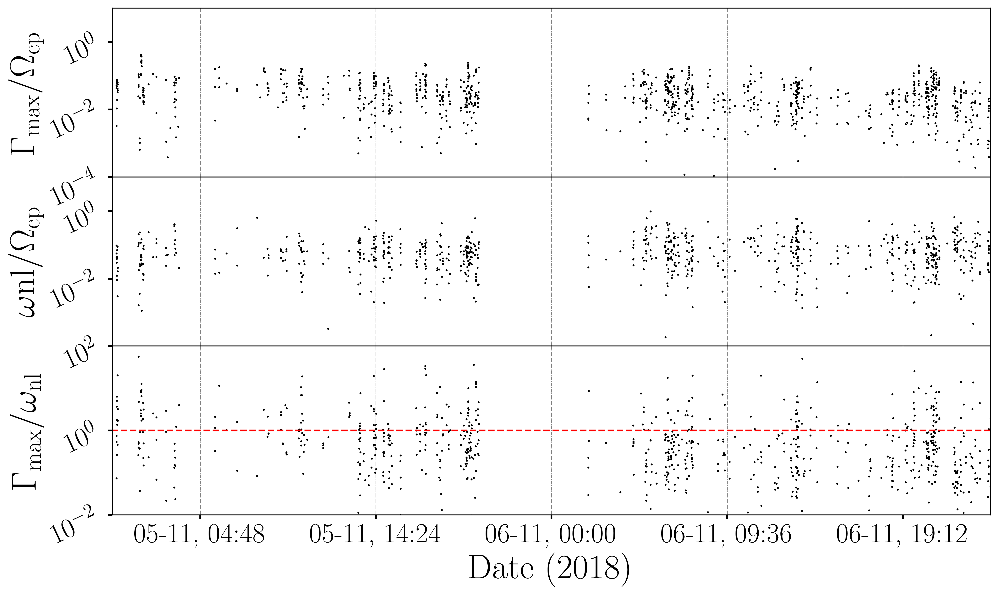

CPU times: user 3.26 s, sys: 123 ms, total: 3.38 s
Wall time: 3.68 s


In [ ]:
%%time

t1 = datetime.strptime('05Nov2018 +0000', '%d%b%Y %z')
t2 = datetime.strptime('07Nov2018 +0000', '%d%b%Y %z')

indices = np.where((x>= t1) & (x<=t2))[0]

c  = [ 'b', 'r', 'g', 'm', 'k', 'y' ]
mk = [ '.', '*', '^', 'v', 'd', 's' ]
dpi = 400 # DPI of the saved plots
s = 2 # Marker size
labelsize = 30
ticklabelsize = 24

legend_transparency = 0.50 # Transparency of legend
ncol = 2 # Number of columns for legend
fig = plt.figure( num=None, figsize=(12, 7), dpi=400, facecolor='w',
                      edgecolor='gray' )
fig.subplots_adjust( left=0.11, right=0.99, top=0.99, bottom=0.12, 
                                                     wspace=0.03, hspace=0 )

axs11 = fig.add_subplot( 3, 1, 1, sharex=None )
axs11.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs11.scatter( x[indices], gamma_max[indices], marker=mk[0], s=s, c=c[4] )

tt = x[indices]
#graph_time = str(np.min(tt).year) + '-' + \
#             str(np.min(tt).month) + '-' + \
#             str(np.min(tt).day) + ' to ' + \
#             str(np.max(tt).year) + '-' + \
#             str(np.max(tt).month) + '-' + \
#             str(np.max(tt).day)
axs11.set_yscale('log')
axs11.set_ylim(1e-4, 1e1)
#axs11.set_title(graph_time, fontsize=20)
axs11.set_ylabel( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=labelsize )

axs11.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs11.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )

axs21 = fig.add_subplot( 3, 1, 2, sharex=axs11 )
axs21.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs21.scatter( x[indices], omega[indices], marker=mk[0], s=s, c=c[4] )
axs21.set_ylabel( r'$\omega{\rm nl}/\Omega_{\rm cp}$', fontsize=labelsize )
axs21.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=False, bottom=False, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs21.set_ylim( 1.1e-4, 1e1 )
axs21.set_yscale( 'log' )

axs41 = fig.add_subplot( 3, 1, 3, sharex=axs11 )
axs41.grid( True, which='both', axis='x', color='gray', lw=0.5, ls='-.' )
axs41.scatter( x[indices], gamma_omega[indices], marker=mk[0], s=s, c=c[4] )
axs41.hlines(y=1, xmin=x[0], xmax=x[-1], ls='--', lw=1.5, colors='r')
#lgnd4 = axs41.legend(fontsize=16, numpoints=1)
#lgnd4.legendHandles[0]._sizes = [20]
#lgnd4.legendHandles[1]._sizes = [20]
axs41.set_ylabel( r'$\Gamma_{\max}/\omega_{\rm nl}$', fontsize=labelsize )

axs41.get_xaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=0 )
axs41.get_yaxis().set_tick_params( which='both', direction='out', 
labelbottom=True, bottom=True, width=1.5, labelsize=ticklabelsize, labelrotation=25 )
axs41.set_ylim( 1e-2, 1.e2 )
axs41.set_yscale( 'log' )
axs41.set_xlim(t1, t2)
#locator = AutoDateLocator()
#date_form = AutoDateFormatter(locator='%m')
start, end = axs41.get_xlim()
start = start
axs41.set_xticks(np.arange(start+0.2, end, 0.4))
date_form = DateFormatter('%d-%m, %H:%M')
axs41.xaxis.set_major_formatter(date_form)

#labels41 = [ item.get_text() for item in axs41.get_xticklabels()[:] ]
#labels41[0] = ''
#labels41[2] = ''
#labels41[4] = ''
#labels41[6] = ''
#labels41[8] = ''
#axs41.set_xticklabels( labels41 )
#fig.autofmt_xdate()

ddd = t1.strftime('%Y')
axs41.set_xlabel( f'Date ({ddd})', fontsize=labelsize )
plt.savefig( f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis/figures/psp_gamma_omega_ratio_{np.min(tt).year}-{np.min(tt).month}-{np.min(tt).day}_{np.max(tt).year}-{np.max(tt).month}-{np.max(tt).day}_{str(indices[0]).zfill(8)}_{str(indices[-1]).zfill(8)}.pdf', dpi=400, format='pdf', bbox_inches = 'tight', pad_inches = 0.05)
plt.show()
plt.close( 'all' )

In [ ]:
start + 100, start, end

(737103.0, 737003.0, 737005.0)

In [ ]:
axs41.get_xticklabels()[:]

[Text(737003.0, 0, '05/11, 00:00'),
 Text(737003.25, 0, '05/11, 06:00'),
 Text(737003.5, 0, '05/11, 12:00'),
 Text(737003.75, 0, '05/11, 18:00'),
 Text(737004.0, 0, '06/11, 00:00'),
 Text(737004.25, 0, '06/11, 06:00'),
 Text(737004.5, 0, '06/11, 12:00'),
 Text(737004.75, 0, '06/11, 18:00'),
 Text(737005.0, 0, '07/11, 00:00')]

In [ ]:
a = np.where(~np.isnan(omnl))[0]
len(a)

0

### KDE

In [ ]:
# Function for KDE plot using Seaborn for difference cases

def kde_plots(x_data, y_data, data_type=None, fig_save=False, nlevels=20) :

    pad = 0.02
    labelsize = 28
    ticklabelsize = 20
    clabelsize = 15
    ticklength = 10
    
    plt.subplots_adjust(left=.1, right=.9, top=0.9, bottom=0.1)

    axs1 = sns.jointplot(x_data, y_data, kind="kde", cbar=True, shade_lowest=False, fill=True,
                            levels=nlevels, log_scale=True, hue_norm=mpl.colors.LogNorm(), cmap='Blues',
                            xlim=[1e-5, 1e1], ylim=[1e-5, 1e1], height=6, ratio=8, space=0.)

    x0, x1 = axs1.ax_joint.get_xlim()
    y0, y1 = axs1.ax_joint.get_ylim()
    lims = [max(x0, y0), min(x1, y1)]
    axs1.ax_joint.plot(lims, lims, '--r', lw=2) 

    pos_joint_ax = axs1.ax_joint.get_position()
    pos_marg_x_ax = axs1.ax_marg_x.get_position()
    axs1.ax_joint.set_position([pos_joint_ax.x0, pos_joint_ax.y0, pos_marg_x_ax.width,
                                pos_joint_ax.height])
    axs1.fig.axes[-1].set_position([1, pos_joint_ax.y0, .07, pos_joint_ax.height])

    # get the current colorbar ticks
    cbar_ticks = axs1.fig.axes[-1].get_yticks()
    # get the maximum value of the colorbar
    _, cbar_max = axs1.fig.axes[-1].get_ylim()
    # change the labels (not the ticks themselves) to a percentage
    axs1.fig.axes[-1].set_yticklabels([f'{t / cbar_max * 1:.3f} %' for t in cbar_ticks], size=clabelsize)

    axs1.fig.axes[-1].set_xlabel('Density', fontsize=clabelsize, labelpad=10)

    axs1.fig.axes[0].tick_params( axis='both', which='major', direction='in', labelbottom=True,
                                 bottom=True, labeltop=False, top=True, labelleft=True, left=True,
                                 labelright=False, right=True, width=1.5, length=ticklength,
                                 labelsize=ticklabelsize, labelrotation=0 )

    axs1.fig.axes[0].tick_params( axis='both', which='minor', direction='in', labelbottom=False,
                                 bottom=False, left=False, width=1.5, length=ticklength,
                                 labelsize=ticklabelsize, labelrotation=0 )

    axs1.fig.axes[1].tick_params( axis='both', which='both', direction='in', labelbottom=False,
                                 bottom=False, labelleft=False, left=False, width=1.5,
                                 length=ticklength, labelsize=ticklabelsize, labelrotation=0 )

    axs1.fig.axes[2].tick_params( axis='both', which='both', direction='in', labelbottom=False,
                                 bottom=False, labelleft=False, left=False, width=1.5,
                                 length=ticklength, labelsize=ticklabelsize, labelrotation=0 )

    axs1.fig.axes[3].tick_params( axis='y', which='major', direction='in', labelbottom=False,
                                 bottom=False, labelleft=False, left=False, labelright=True,
                                 right=True, width=1.5, length=ticklength, labelsize=clabelsize,
                                 labelrotation=0 )

    axs1.fig.axes[0].text(0.1, 0.95, data_type, horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.fig.axes[0].transAxes)

    axs1.set_axis_labels('x', 'y', fontsize=labelsize)
    axs1.ax_joint.set_ylabel( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=labelsize )
    axs1.ax_joint.set_xlabel( r'$\omega_{\rm nl}/\Omega_{\rm cp}$', fontsize=labelsize )

    if (fig_save) :
        fname = f'figures/{data_type}_kdeplot.pdf'
        axs1.savefig(fname, format='pdf', dpi=400)
    plt.show()
    plt.close('all')
    return axs1

#### MMS

<Figure size 576x720 with 0 Axes>

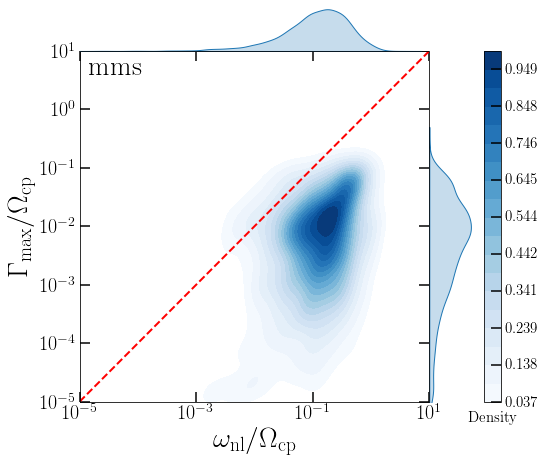

CPU times: user 7.84 s, sys: 1.45 s, total: 9.29 s
Wall time: 20.5 s


In [ ]:
%%time

# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_1_gamma_kdi_pvi_v02.p')
omnl = hf.File('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/omega/omega_mms_20171226_1.h5')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = omnl['omnl'][:]

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

axs1 = kde_plots(omega[inds], gamma_max[inds], data_type='mms', fig_save=True)

#### WIND

<Figure size 576x720 with 0 Axes>

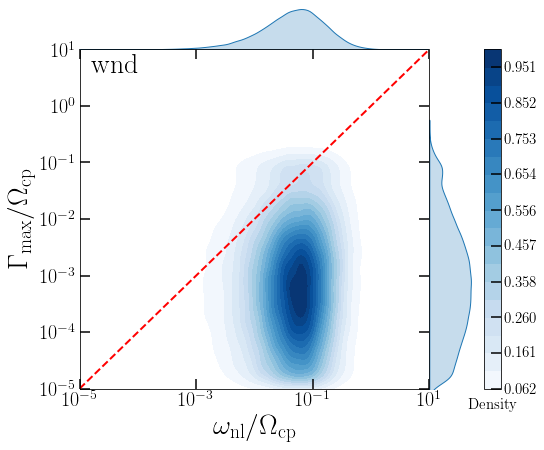

CPU times: user 4min 47s, sys: 16.5 s, total: 5min 4s
Wall time: 5min 8s


In [ ]:
%%time

# Read the required data
df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/data/all_wind_data_v02.p')

t1 = datetime.strptime('01Jan2000', '%d%b%Y')
t2 = datetime.strptime('31Dec2009', '%d%b%Y')

indices = np.where((df.index>= t1) & (df.index<=t2))[0]

g_a_par = df.g_a_par[indices]
g_b_par = df.g_b_par[indices]
g_a_per = df.g_a_per[indices]
g_b_per = df.g_b_per[indices]
omega = df.omnl[indices]

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

#axs1 = sns.jointplot(omega[inds], gamma_max[inds], kind="kde", cbar=True, shade_lowest=False, fill=True,
#                            levels=20, log_scale=True, hue_norm=mpl.colors.LogNorm(), cmap='Blues',
#                            xlim=[1e-5, 1e1], ylim=[1e-5, 1e1], height=6, ratio=8, space=0.)
axs1 = kde_plots(omega[inds], gamma_max[inds], data_type='wnd', fig_save=True)

#### PSP

<Figure size 576x720 with 0 Axes>

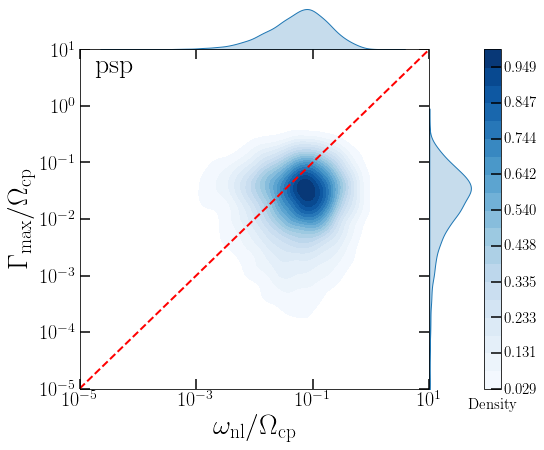

CPU times: user 9 s, sys: 1.06 s, total: 10.1 s
Wall time: 13.3 s


In [ ]:
%%time
# Read the required data
df = pd.read_pickle('data/psp_e1_gamma_omega_data.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = df.omnl

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

axs1 = kde_plots(omega[inds], gamma_max[inds], data_type='psp', fig_save=True)

#### Simulations

In [ ]:
%%time

om_file_list = [
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dpp.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dip.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5'
                  ]

gamma_file_list = [
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5'
               ]

data_type = ['149p6', 'kaw', 'ros']

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

read_data = '1'
count = 2
n_pln = 0
for ( xx, yy ) in zip( om_file_list[2:], gamma_file_list[2:] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        # Extract the data

        if (count > 1 ) :
            # Non-linear frequency
            omega = data['om'][:,:,n_pln]
            data  = []

	        # gamma values for each region
            a_par = gamma[ key[0] ][:,:,n_pln]
            b_par = gamma[ key[1] ][:,:,n_pln]
            a_per = gamma[ key[2] ][:,:,n_pln]
            b_per = gamma[ key[3] ][:,:,n_pln]
            gamma = []

            omega_1d = omega.flatten()
            omega = []
            a_par_1d = a_par.flatten()
            a_par = []
            b_par_1d = b_par.flatten()
            b_par = []
            a_per_1d = a_per.flatten()
            a_per = []
            b_per_1d = b_per.flatten()
            b_per = []

            # Find out the maximum gamma among all gammas
            gamma_stacked = np.dstack((a_par_1d, b_par_1d, a_per_1d, b_per_1d))
            gamma_max_1d = np.nanmax(gamma_stacked, axis=2)
            gamma_stacked = []

            #gamma_omega = gamma_max/omega

        else :
            # Non-linear frequency
            omega = data['om'][:]

	        # gamma values for each region
            a_par = gamma[ key[0] ][:]
            b_par = gamma[ key[1] ][:]
            a_per = gamma[ key[2] ][:]
            b_per = gamma[ key[3] ][:]

            # Find out the maximum gamma among all gammas
            gamma_stacked = np.dstack((a_par, b_par, a_per, b_per))
            gamma_max = np.nanmax(gamma_stacked, axis=2)

            gamma_omega = gamma_max/omega

            gamma_max_1d = gamma_max.flatten()
            omega_1d = omega.flatten()

        inds = np.where((gamma_max_1d >= 1e-5) & (omega_1d > 0))[0]

        axs1 = kde_plots(omega_1d[inds], gamma_max_1d[inds], data_type=data_type[count], fig_save=True)
        count += 1

/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5


### Computing statistics

#### MMS

In [ ]:
%%time

# Read the required data

df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_1_gamma_kdi_pvi_v02.p')
omnl = hf.File('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/omega/omega_mms_20171226_1.h5')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = omnl['omnl'][:]

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]
inds2 = np.where(gamma_max/omega > 1)[0]

print(len(df.index[:]), len(inds), len(inds2))

15857 3887 174
CPU times: user 12.2 ms, sys: 4.88 ms, total: 17.1 ms
Wall time: 20.7 ms


#### WIND

In [ ]:
df = pd.read_pickle('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/wind_stuff/data/all_wind_data_v02.p')

t1 = datetime.strptime('01Jan2000', '%d%b%Y')
t2 = datetime.strptime('31Dec2009', '%d%b%Y')

indices = np.where((df.index>= t1) & (df.index<=t2))[0]

g_a_par = df.g_a_par[indices]
g_b_par = df.g_b_par[indices]
g_a_per = df.g_a_per[indices]
g_b_per = df.g_b_per[indices]
omega = df.omnl[indices]

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]
inds2 = np.where(gamma_max/omega > 1)[0]

print(len(indices), len(inds), len(inds2))

1316621 187838 27857


#### PSP

In [ ]:
%%time
# Read the required data
df = pd.read_pickle('data/psp_e1_gamma_omega_data.p')

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = df.omnl

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]
inds2 = np.where(gamma_max/omega > 1)[0]

print(len(df.index[:]), len(inds), len(inds2))

95034 5347 1483
CPU times: user 38.5 ms, sys: 49.8 ms, total: 88.3 ms
Wall time: 858 ms


#### Simulations

In [ ]:
om_file_list = [
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dpp.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_2dip.h5',
                  '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5'
                  ]

gamma_file_list = [
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5',
               '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5',
               ]

data_type = ['149p6', 'kaw']

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

read_data = '1'
count = 0
n_pln = 1
for ( xx, yy ) in zip( om_file_list[:], gamma_file_list[2:3] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

    # Non-linear frequency
    omega = data['om'][:]

    # gamma values for each region
    a_par = gamma[ key[0] ][:]
    b_par = gamma[ key[1] ][:]
    a_per = gamma[ key[2] ][:]
    b_per = gamma[ key[3] ][:]

    # Find out the maximum gamma among all gammas
    gamma_stacked = np.dstack((a_par, b_par, a_per, b_per))
    gamma_max = np.nanmax(gamma_stacked, axis=2)

    gamma_omega = gamma_max/omega
    gamma_max_1d = gamma_max.flatten()
    omega_1d = omega.flatten()

    inds = np.where((gamma_max_1d >= 1e-5) & (omega_1d > 0))[0]

    inds = np.where(gamma_max_1d >= 1e-5)[0]

    inds2 = np.where(gamma_max_1d/omega_1d > 1)[0]

    print(data_type[count], len(omega_1d), len(inds), len(inds2))

    count += 1

/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5
ros 262144 48219 1538


In [ ]:
%%time

om_file_list = ['/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/om_mag_3d.h5']

gamma_file_list = ['/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_yan_512.h5']

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files
data = hf.File(om_file_list[0])
gamma = hf.File(gamma_file_list[0])

pln_list = np.arange(512)
N = []
n_gamma = []
n_Gamma = []

for n_pln in pln_list :
    # Extract the data

    # Non-linear frequency
    omega = data['om'][:,:,n_pln]

	# gamma values for each region
    a_par = gamma[ key[0] ][:,:,n_pln]
    b_par = gamma[ key[1] ][:,:,n_pln]
    a_per = gamma[ key[2] ][:,:,n_pln]
    b_per = gamma[ key[3] ][:,:,n_pln]

    omega_1d = omega.flatten()
    a_par_1d = a_par.flatten()
    b_par_1d = b_par.flatten()
    a_per_1d = a_per.flatten()
    b_per_1d = b_per.flatten()

    # Find out the maximum gamma among all gammas
    gamma_stacked = np.dstack((a_par_1d, b_par_1d, a_per_1d, b_per_1d))
    gamma_max_1d = np.nanmax(gamma_stacked, axis=2)

    inds = np.where((gamma_max_1d >= 1e-5) & (omega_1d > 0))[0]

    inds = np.where(gamma_max_1d >= 1e-5)[0]

    inds2 = np.where(gamma_max_1d/omega_1d > 1)[0]

    #N.append(len(omega_1d))
    n_gamma.append(len(inds))
    n_Gamma.append(len(inds2))
    #print(data_type[count], len(omega_1d), len(inds), len(inds2))
    if(n_pln % 10 == 0):
        print(f'Plane number {n_pln}')

N_gamma = sum(n_gamma)
N_Gamma = sum(n_Gamma)

Plane number 0
Plane number 10
Plane number 20
Plane number 30
Plane number 40
Plane number 50
Plane number 60
Plane number 70
Plane number 80
Plane number 90
Plane number 100
Plane number 110
Plane number 120
Plane number 130
Plane number 140
Plane number 150
Plane number 160
Plane number 170
Plane number 180
Plane number 190
Plane number 200
Plane number 210
Plane number 220
Plane number 230
Plane number 240
Plane number 250
Plane number 260
Plane number 270
Plane number 280
Plane number 290
Plane number 300
Plane number 310
Plane number 320
Plane number 330
Plane number 340
Plane number 350
Plane number 360
Plane number 370
Plane number 380
Plane number 390
Plane number 400
Plane number 410
Plane number 420
Plane number 430
Plane number 440
Plane number 450
Plane number 460
Plane number 470
Plane number 480
Plane number 490
Plane number 500
Plane number 510
CPU times: user 49.5 s, sys: 7min 34s, total: 8min 23s
Wall time: 8min 25s


In [ ]:
N_gamma, N_Gamma


(22001875, 794220)

# Brazil plot of $\gamma$ and $\omega$

## Functional forms

### Histograms

In [ ]:
#-------------------------------------------------------------------------------
# Brazil Histogram
#-------------------------------------------------------------------------------

# Define the function for generation of Brazil Histogram

def brzl_hist( x=None, y=None, z=[], xlim=None, ylim=None, ztype='', spc='', 
              date='', bins=50, n_min=5, dens=False, vmin=None, vmax=None ) :

    # Check to make sure all required values are passed. If not, abort.
    # Note: 'z = None' produces standard bins of number of data

    if ( x is None ) :

        raise ValueError( 'x data not provided' )
        return

    if ( y is None ) :

        raise ValueError( 'y data not provided' )
        return

    # Change x, y, and z into numpy arrays

    x = np.array( x )
    y = np.array( y )
    z = np.array( z )

    # Determine if 1 or 2 bin values are given and separate values
    # if necessary.

    if ( hasattr( bins, 'len' ) ) :

        nx = bins[0]
        ny = bins[1]

    else :

        nx = bins
        ny = bins

    if( xlim is None ) :

        xlim = [ np.nanmin( x ), np.nanmax( x ) ]

    if( ylim is None ) :

        ylim = [ np.nanmin( y ), np.nanmax( y ) ]

    # If no z data have been provided, generate a standard histogram.
    # Otherwise, manually generate bins and bin the data.

    if len(z) == 0 :

        # Note: bins variables are lists of all leading edges plus
        # the lagging edge of the final bin.

        xbins = np.linspace( xlim[0], xlim[1], nx+1 )
        ybins = np.linspace( ylim[0], ylim[1], ny+1 )

        hst = plt.hist2d( x, y, bins=bins, cmin=n_min, range=[ xlim, ylim ] )

        plt.close('all')
        # number of data points
        N = np.nansum( np.nansum( hst[0], axis=0 ) )

        zplot1 = np.transpose(hst[0])
        zplot2 = np.transpose(hst[0])
    else :

        # set number of data points to zero for running tally
        N = 0

        # Note: bins variables are lists of all leading edges plus
        # the lagging edge of the final bin.

        xbins = np.linspace( xlim[0], xlim[1], nx+1 )
        ybins = np.linspace( ylim[0], ylim[1], ny+1 )

        # For each bin, find all the z data whose corresponding
        # x and y values fall within that bin and save the medians
        # as an array to be plotted.

        zplot1 = np.array( [ [ float('nan') for n in range( nx ) ]
                                        for m in range( ny ) ] )
        zplot2 = np.array( [ [ float('nan') for n in range( nx ) ]
                                        for m in range( ny ) ] )

        tkx = []
        tky = []
        tkz = []

        # For each bin along the x-axis...

        for i in range( nx ) :

            # find the x data with beta values within that bin

            tkx = np.where( ( x >= xbins[i]   ) &
                     ( x <  xbins[i+1] )   )[0]

            # If no valid beta values were found,
            # move to the next bin.

            if len( tkx ) == 0 :

                continue

            # For each bin along the y-axis...

            for j in range( ny ) :

                # find the y data with anisotropy values
                # within that bin.

                tkxy = np.where( ( y[tkx] >= ybins[j]   ) &
                              ( y[tkx] <  ybins[j+1] )   )[0]

                # If any valid data were found, take the
                # median of those data (ignoring 'Nan's) and
                # assign that value to the corresponding
                # location in 'zplot' for plotting.

                if len( tkxy ) >= n_min :
                    zplot1[i,j] = np.nanmedian( z[tkx][tkxy] )
                    zplot2[i,j] = np.nanmean( z[tkx][tkxy] )
                    # running tally of number of data points
                    N += len( np.where( z[tkx][tkxy] != float('nan') )[0] )

        # Generate the histogram (not actually a matplotlib histogram)
        # Note: imshow() plots according to ( y, x )

        zplot1 = np.transpose( zplot1 )
        zplot2 = np.transpose( zplot2 )

    return xbins, ybins, zplot1, zplot2

### Brazil plot

In [ ]:
def brz_plotting_routine(data=None, ex=None, ey=None, xmin=None, xmax=None, ymin=None, ymax=None,
                         bins=None, nbins=None, cmin=None, cmax=None, norm=None, cmap=None,
                         vmin=None, vmax=None, spc=None, save_fig=False, plot_show=False) :

    pad = 0.02
    clabelpad = 5.0
    labelsize = 30
    ticklabelsize = 30
    cticklabelsize = 20
    clabelsize = 25
    ticklength = 10
    mticklength = 4
    tickwidth = 1.5
    tick_width = 1.5
    tick_length = 10
    ctick_length = 5
    mcticklength = 4
    aspect = 'auto'
    labelrotation = 0
    alpha = 0.9

    if None in [xmin, xmax, ymin, ymax] :
        xmin = min(ex)
        xmax = max(ex)
        ymin = min(ey)
        ymax = max(ey)

    if bins is None :
        if (nbins is None):
            nbins = 50
        bins = (np.logspace(np.log10(xmin), np.log10(xmax),nbins),
                np.logspace(np.log10(ymin), np.log10(ymax),nbins))

    if cmap is None :
        cmap = plt.cm.Blues

    if cmin is None :
        cmin = 5
    if cmax is None :
        cmax = 1e2

    if norm is None :
        norm = mpl.colors.LogNorm(vmin, vmax)

    fig = plt.figure(num=None, figsize=( 24, 7.5), dpi=300, facecolor='w', edgecolor='gray')
    fig.subplots_adjust(left=0.01, right=0.95, top=0.99, bottom=0.01, wspace=0.0, hspace=0.0)

    axs_xlabel = r'$\beta_{\parallel \mathrm{p}} = 2 \mu_0 n_\mathrm{p} k_\mathrm{B}$' +\
                 r'$T_{\parallel \mathrm{p}}/B^2$'

    axs_ylabel = r'$R_{\mathrm{p}} = T_{\perp \mathrm{p}}/T_{\parallel \mathrm{p}}$'

    cbar_label = r'$\tilde{p}( \beta_{\parallel \mathrm{p}}, R_\mathrm{p}) = n/( N \Delta \beta_{\parallel \mathrm{p}} \Delta R_\mathrm{p} )$'

    # Figure 1
    axs1 = fig.add_subplot(1, 4, 1, sharex=None)

    im1 = axs1.pcolormesh(ex, ey, data[0], alpha=alpha, shading='auto', cmap=cmap, norm=norm)

    axs1.axhline( 0, lw=1.0, c='k' )

    axs1.set_xlabel( axs_xlabel, fontsize=labelsize )
    axs1.set_ylabel( axs_ylabel, fontsize=labelsize )

    axs1.set_xlim(xmin, xmax)
    axs1.set_ylim(ymin, ymax)
    axs1.set_xscale('log')
    axs1.set_yscale('log')

    im1.axes.tick_params(which='major', axis='both', direction='in', labelbottom=True, bottom=True,
                         labeltop=False, top=True, labelleft=True, left=True, labelright=False,
                         right=True, width=tickwidth, length=ticklength, labelsize=ticklabelsize,
                         labelrotation=labelrotation)
    im1.axes.tick_params(which='minor', axis='both', direction='in', labelbottom=False, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=mticklength,
                         labelsize=ticklabelsize, labelrotation=labelrotation)

    divider1 = make_axes_locatable(axs1)
    cax1 = divider1.append_axes("top", size="5%", pad=pad )
    cbar1 = plt.colorbar(im1, cax=cax1, orientation='horizontal', ticks=None, fraction=0.05,
                         pad=0.0)

    cbar1.ax.tick_params(axis='x', which='both', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=tick_width, length=ctick_length, 
                         labelsize=clabelsize, labelrotation=0, pad=0)

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$N$', fontsize=clabelsize, labelpad=clabelpad )


    # Figure 2
    axs2 = fig.add_subplot(1, 4, 2, sharex=None)

    im2 = axs2.pcolormesh(ex, ey, data[1], alpha=alpha, shading='auto',
                          norm=mpl.colors.LogNorm(8e-5, 6e-1), cmap=cmap)

    axs2.axhline( 0, lw=1.0, c='k' )

    axs2.set_xlabel( axs_xlabel, fontsize=labelsize )

    axs2.set_xlim(xmin, xmax)
    axs2.set_ylim(ymin, ymax)
    axs2.set_xscale('log')
    axs2.set_yscale('log')

    im2.axes.tick_params(which='major', axis='both', direction='in', labelbottom=True, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=ticklength, labelsize=ticklabelsize,
                         labelrotation=labelrotation)
    im2.axes.tick_params(which='minor', axis='both', direction='in', labelbottom=False, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=mticklength,
                         labelsize=ticklabelsize, labelrotation=labelrotation)

    #fmtx = FuncFormatter( lambda x, pos: tickformatx( x ) )
    #axs2.xaxis.set_major_formatter( fmtx )
    #axs2.yaxis.set_major_formatter( fmtx )

    divider2 = make_axes_locatable(axs2)
    cax2 = divider2.append_axes("top", size="5%", pad=pad )
    cbar2 = plt.colorbar(im2, cax=cax2, orientation='horizontal', ticks=None, fraction=0.05,
                         pad=0.0)

    cbar2.ax.tick_params(axis='x', which='both', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=tick_width, length=ctick_length,
                         labelsize=clabelsize, labelrotation=0, pad=0)

    cbar2.ax.xaxis.set_label_position('top')
    cbar2.set_label( r'$\Gamma_{\max}/\Omega_{\rm cp}$', fontsize=clabelsize, labelpad=clabelpad )

    # Figure 3
    axs3 = fig.add_subplot(1, 4, 3, sharex=axs1)

    im3 = axs3.pcolormesh(ex, ey, data[2], alpha=alpha, shading='auto',
                          norm=mpl.colors.LogNorm(1e-2, 1e0), cmap=cmap)

    axs3.axhline( 0, lw=1.0, c='k' )

    axs3.set_xlabel( axs_xlabel, fontsize=labelsize )

    axs3.set_xlim(xmin, xmax)
    axs3.set_ylim(ymin, ymax)
    axs3.set_xscale('log')
    axs3.set_yscale('log')

    im3.axes.tick_params(which='major', axis='both', direction='in', labelbottom=True, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=ticklength, labelsize=ticklabelsize,
                         labelrotation=labelrotation)
    im3.axes.tick_params(which='minor', axis='both', direction='in', labelbottom=False, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=mticklength,
                         labelsize=ticklabelsize, labelrotation=labelrotation)

    #fmtx = FuncFormatter( lambda x, pos: tickformatx( x ) )
    #axs3.xaxis.set_major_formatter( fmtx )
    #axs3.yaxis.set_major_formatter( fmtx )

    divider3 = make_axes_locatable(axs3)
    cax3 = divider3.append_axes("top", size="5%", pad=pad )
    cbar3 = plt.colorbar(im3, cax=cax3, orientation='horizontal', ticks=None, fraction=0.05,
                         pad=0.0)

    cbar3.ax.tick_params(axis='x', which='both', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=tick_width, length=ctick_length, 
                         labelsize=clabelsize, labelrotation=0, pad=0)

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$\omega_{\rm nl}/\Omega_{\rm cp}$', fontsize=clabelsize, labelpad=clabelpad )


    # Figure 4
    axs4 = fig.add_subplot(1, 4, 4, sharex=None)

    im4 = axs4.pcolormesh(ex, ey, data[3], alpha=alpha, shading='auto',
                          norm=mpl.colors.LogNorm(1e-2, 1e2), cmap=plt.cm.bwr)

    axs4.axhline( 0, lw=1.0, c='k' )

    axs4.set_xlabel( axs_xlabel, fontsize=labelsize )

    axs4.set_xlim(xmin, xmax)
    axs4.set_ylim(ymin, ymax)
    axs4.set_xscale('log')
    axs4.set_yscale('log')

    im4.axes.tick_params(which='major', axis='both', direction='in', labelbottom=True, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=True,
                         right=True, width=tickwidth, length=ticklength, labelsize=ticklabelsize,
                         labelrotation=labelrotation)
    im4.axes.tick_params(which='minor', axis='both', direction='in', labelbottom=False, bottom=True,
                         labeltop=False, top=True, labelleft=False, left=True, labelright=False,
                         right=True, width=tickwidth, length=mticklength,
                         labelsize=ticklabelsize, labelrotation=labelrotation)

    #fmtx = FuncFormatter( lambda x, pos: tickformatx( x ) )
    #axs4.xaxis.set_major_formatter( fmtx )
    #axs4.yaxis.set_major_formatter( fmtx )

    divider4 = make_axes_locatable(axs4)
    cax4 = divider4.append_axes("top", size="5%", pad=pad )
    cbar4 = plt.colorbar(im4, cax=cax4, orientation='horizontal', ticks=None, fraction=0.05,
                         pad=0.0)

    cbar4.ax.tick_params(axis='x', which='both', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=tick_width, length=ctick_length, 
                         labelsize=clabelsize, labelrotation=0, pad=0)

    cbar4.ax.xaxis.set_label_position('top')

    cbar4.set_label( r'$\Gamma_{\max}/\omega_{\rm nl}$', fontsize=clabelsize, labelpad=clabelpad )

    xticks2 = im2.axes.xaxis.get_majorticklabels()
    xticks2[1].set_visible(False)
    xticks2[-2].set_visible(False)

    xticks3 = im3.axes.xaxis.get_majorticklabels()
    xticks3[-2].set_visible(False)

    #yticks1 = axs1.xaxis.get_minor_ticks()
    #yticks1[-1].set_visible(False)

    #xticks2 = axs2.xaxis.get_major_ticks()
    #xticks2[0].set_visible(False)

    #xticks3 = axs3.xaxis.get_major_ticks()
    #xticks3[0].set_visible(False)

    #xticks4 = axs4.xaxis.get_major_ticks()
    #xticks4[0].set_visible(False)

    #yticks4 = axs1.xaxis.get_major_ticks()
    #yticks4[-1].set_visible(False)

    #cxticks2 = cax2.xaxis.get_major_ticks()
    #cxticks2[0].set_visible(False)

    cxticks3 = cax3.xaxis.get_major_ticks()
    cxticks3[-1].set_visible(False)

    #cxticks4 = cax4.xaxis.get_major_ticks()
    #cxticks4[0].set_visible(False)

    if (save_fig) :
        plt.savefig(f'figures/{spc}_brz_omega_gamma_mean.pdf', bbox_inches='tight',
                    pad_inches = 0.05, format='pdf', dpi=300)

        print(f'Figure saved for spacecraft {spc}')

    if (plot_show==True) :
        plt.show()
    #plt.close('all')

### MMS

In [ ]:
%%time

# Read the required data

df = pd.read_pickle('data/all_spc_20160111_20160124_20170118_20171226.p')

b_p = df.b_p
r_p = df.r_p

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = df.omnl

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

gamma_omega = gamma_max/omega

CPU times: user 44.1 ms, sys: 61.7 ms, total: 106 ms
Wall time: 1.19 s


In [ ]:
log_b = np.log10(b_p[inds])
log_t = np.log10(r_p[inds])
z1 = []
z2 = gamma_max[inds]
z3 = omega[inds]
z4 = gamma_omega[inds]

x_min = 0
x_max = 2
y_min = -0.22
y_max = np.log10(2)

xlim = [x_min, x_max]
ylim = [y_min, y_max]

bins = 50

(ex2, ey2, hst1, hst2) = brzl_hist( x=np.log10(b_p), y=np.log10(r_p), z=z1, xlim=xlim, ylim=ylim, bins=bins)
(ex4, ey4, hst3, hst4) = brzl_hist( x=log_b, y=log_t, z=z2, xlim=xlim, ylim=ylim, bins=bins)
(ex6, ey6, hst5, hst6) = brzl_hist( x=log_b, y=log_t, z=z3, xlim=xlim, ylim=ylim, bins=bins)
(ex8, ey8, hst7, hst8) = brzl_hist( x=log_b, y=log_t, z=z4, xlim=xlim, ylim=ylim, bins=bins)

Figure saved for spacecraft mms


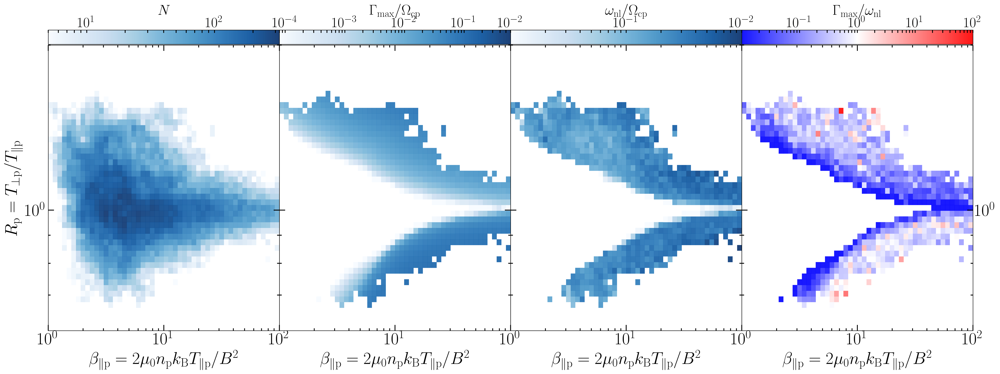

In [ ]:
data = [hst2, hst4, hst6, hst8]
ex = 10**ex2
ey = 10**ey2
bins = (ex, ey)
brz_plotting_routine(data=data, ex=ex, ey=ey, bins=bins, cmin=5, cmax=100, spc='mms', save_fig=True,
                     plot_show=True)

### PSP

In [ ]:
%%time

# Read the required data

df = pd.read_pickle('data/psp_e1_all_merged_data.p')

b_p = df.betaparamom
r_p = df.tanimom

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = df.omnl

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

gamma_omega = gamma_max/omega

CPU times: user 62.3 ms, sys: 248 ms, total: 311 ms
Wall time: 1.64 s


In [ ]:
log_b = np.log10(b_p[inds])
log_t = np.log10(r_p[inds])
z1 = []
z2 = gamma_max[inds]
z3 = omega[inds]
z4 = gamma_omega[inds]

x_min = -1
x_max = 0
y_min = -0.9
y_max = 1

xlim = [x_min, x_max]
ylim = [y_min, y_max]

bins = 50

(ex2, ey2, hst1, hst2) = brzl_hist( x=np.log10(b_p), y=np.log10(r_p), z=z1, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst3, hst4) = brzl_hist( x=log_b, y=log_t, z=z2, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst5, hst6) = brzl_hist( x=log_b, y=log_t, z=z3, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst7, hst8) = brzl_hist( x=log_b, y=log_t, z=z4, xlim=xlim, ylim=ylim, bins=bins)

Figure saved for spacecraft psp


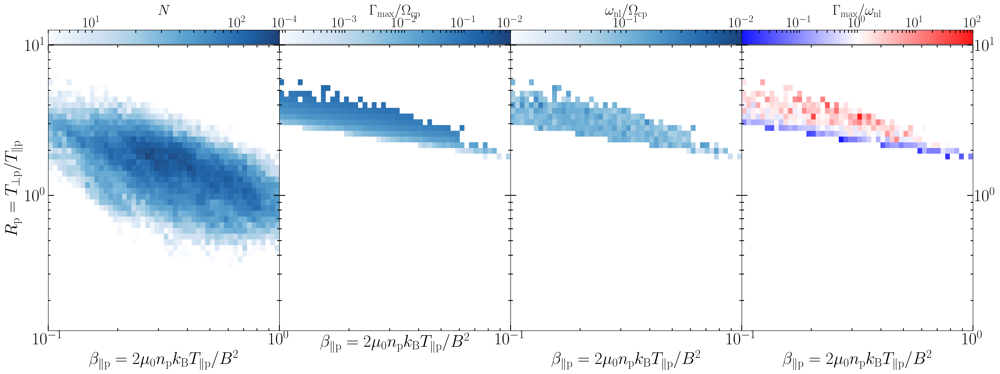

In [ ]:
data = [hst2, hst4, hst6, hst8]
ex = 10**ex2
ey = 10**ey2
bins = (ex, ey)
brz_plotting_routine(data=data, ex=ex, ey=ey, bins=bins, cmin=1, cmax=100, spc='psp', save_fig=True,
                     plot_show=True)

### Wind

In [ ]:
%%time

# Read the required data

df = pd.read_pickle('data/all_wind_data_v06.p')

b_p = df.b_p
r_p = df.r_p_x

g_a_par = df.g_a_par
g_b_par = df.g_b_par
g_a_per = df.g_a_per
g_b_per = df.g_b_per
omega = df.omnl

gamma_stacked = np.dstack((g_a_par, g_b_par, g_a_per, g_b_per))
gamma_max = np.nanmax(gamma_stacked, axis=2)[0]

inds = np.where((gamma_max >=1e-5) & (omega>0))[0]

gamma_omega = gamma_max/omega

CPU times: user 708 ms, sys: 2.11 s, total: 2.81 s
Wall time: 6.78 s


In [ ]:
log_b = np.log10(b_p[inds])
log_t = np.log10(r_p[inds])
z1 = []
z2 = gamma_max[inds]
z3 = omega[inds]
z4 = gamma_omega[inds]

x_min = -1
x_max = 1
y_min = -0.9
y_max = 1

xlim = [x_min, x_max]
ylim = [y_min, y_max]

bins = 50

(ex2, ey2, hst1, hst2) = brzl_hist( x=np.log10(b_p), y=np.log10(r_p), z=z1, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst3, hst4) = brzl_hist( x=log_b, y=log_t, z=z2, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst5, hst6) = brzl_hist( x=log_b, y=log_t, z=z3, xlim=xlim, ylim=ylim, bins=bins)
(ex2, ey2, hst7, hst8) = brzl_hist( x=log_b, y=log_t, z=z4, xlim=xlim, ylim=ylim, bins=bins)

Figure saved for spacecraft wnd


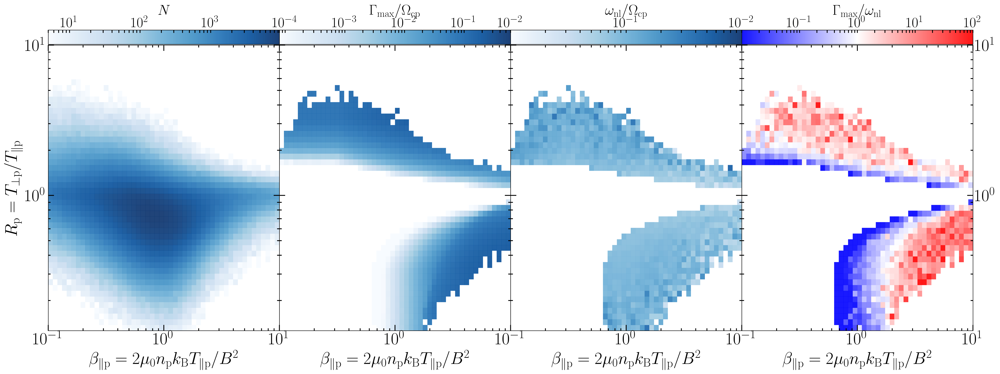

In [ ]:
data = [hst2, hst4, hst6, hst8]
ex = 10**ex2
ey = 10**ey2
bins = (ex, ey)
brz_plotting_routine(data=data, ex=ex, ey=ey, bins=bins, cmin=1, cmax=100, spc='wnd', save_fig=True,
                     plot_show=True)

# Chapter 1

In [ ]:
%%time

wnd_data = pd.read_pickle('data/all_wind_data_v06.p')
psp_data = pd.read_pickle('data/psp_e1_all_merged_data.p')
mms_data1 = pd.read_pickle('data/all_spc_20160111_20160124_20170118_20171226.p')
mms_data2 = pd.read_pickle('data/all_spc_20160111_20160124_20170118_20171226_new_set.p')

CPU times: user 121 ms, sys: 1.07 s, total: 1.19 s
Wall time: 1.63 s


In [ ]:
wnd_data.keys()

Index(['b', 'b_x', 'b_y', 'b_z', 'beta_par_a', 'beta_par_p', 'c_a', 'c_a_var',
       'col_age', 'dv_ap', 'dvca', 'dvca_var', 'n_a', 'n_i', 'n_p', 'nanp',
       'r_a', 'r_p_x', 't_a', 't_i', 't_p', 't_par_a', 't_par_p', 't_per_a',
       't_per_p', 't_sec', 'tatp', 'time_new', 'v_p', 'v_x_p', 'v_y_p',
       'v_z_p', 'w_par_a', 'w_par_p', 'w_per_a', 'w_per_p', 'b_p', 'di', 'dl',
       'g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per',
       'k_b_par', 'k_b_per', 'lin_time', 'omnl', 'omnl_time', 'r_p_y'],
      dtype='object')

In [ ]:
mms_data2.keys()

Index(['ion_temp_aniso', 'ion_time_strt', 'mag_vec_x', 'mag_vec_y',
       'mag_vec_z', 'ion_time_stop', 'ion_temp_per', 'ion_temp_par',
       'ion_dens', 'curr_vec_x', 'curr_vec_y', 'curr_vec_z', 'mag_mag',
       'ion_beta_par', 'elec_dens', 'ion_temp_tot', 'ion_vel_vec_x',
       'ion_vel_vec_y', 'ion_vel_vec_z', 'curr_mag', 'elec_vel_vec_x',
       'elec_vel_vec_y', 'elec_vel_vec_z'],
      dtype='object')

In [ ]:
psp_data.keys()

Index(['betapara_core', 'betaparamom', 'tani_core', 'tanimom', 'time_series',
       'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per', 'k_a_par', 'k_b_par',
       'k_a_per', 'k_b_per', 'omnl', 'dl', 'di', 'ssepoch', 'vpr', 'vpt',
       'vpn', 'np_moment', 'np1_fit', 'np1_fit_uncertainty', 'wp_moment',
       'wp1_fit', 'wp1_fit_uncertainty', 'sc_pr', 'sc_pt', 'sc_pn',
       'carr_latitude', 'carr_longitude', 'pvi_max_mag_4_8H',
       'pvi_med_mag_4_8H', 'br', 'bt', 'bn', 'smooth_np_moment', 'bmag',
       'smooth_bmag', 'vA', 'Rs', 'vpm', 'uv_b_r', 'Tp', 'Tp_par', 'Tp_per',
       'beta', 'beta_par', 'beta_per', 'pa'],
      dtype='object')

In [ ]:
mms_data2.ion_dens[0:10].values

array([69.98333 , 75.31407 , 81.21484 , 74.096794, 71.23719 , 76.880135,
       82.193405, 72.93831 , 78.91818 , 80.93349 ], dtype=float32)

## Plasma Paramters

### Inertial length

In [ ]:
%%time

plasma_paramaters = {}

mms_np = [xx * u.cm ** -3 for xx in mms_data2.ion_dens]
plasma_paramaters['d_i_mms'] = pfp.inertial_length(mms_np[0:], particle='p+')

print('Done for mms')

wnd_np = [xx * u.cm ** -3 for xx in wnd_data.n_p]
plasma_paramaters['d_i_wnd'] = pfp.inertial_length(wnd_np[0:], particle='p+')

print('Done for wnd')

psp_np = [xx * u.cm ** -3 for xx in psp_data.np_moment]
plasma_paramaters['d_i_psp'] = pfp.inertial_length(psp_np[0:], particle='p+')

print('Done for psp')

Done for mms
Done for wnd
Done for psp
CPU times: user 1min 33s, sys: 1.9 s, total: 1min 35s
Wall time: 1min 35s



### Debye Length

In [ ]:
%%time

mms_tp_ev = [xx * u.eV for xx in mms_data2.ion_temp_tot]
mms_tp = [xx.to(u.K, equivalencies=u.temperature_energy()) for xx in mms_tp_ev]
plasma_paramaters['debye_mms'] = pfp.Debye_length(mms_tp, mms_np)

print('Done for mms')

wnd_tp = [xx * u.K for xx in wnd_data.t_p]
plasma_paramaters['debye_wnd'] = pfp.Debye_length(wnd_tp, wnd_np)

print('Done for wnd')

psp_tp = [xx * u.K for xx in psp_data.Tp]
plasma_paramaters['debye_psp'] = pfp.Debye_length(psp_tp, psp_np)
print('Done for psp')

Done for mms
Done for wnd
Done for psp
CPU times: user 37.5 s, sys: 494 ms, total: 38 s
Wall time: 37.8 s


In [ ]:
plasma_paramaters.keys()

dict_keys(['d_i_mms', 'd_i_wnd', 'd_i_psp', 'debye_mms', 'debye_wnd', 'debye_psp'])

### Gyrofrequency

In [ ]:
%%time

mms_b = [xx * u.nT for xx in mms_data2.mag_mag]
plasma_paramaters['gyrofrequency_mms'] = pfp.gyrofrequency(mms_b[0:], particle='p+')
print('Done for mms')

wnd_b = [xx * u.nT for xx in wnd_data.b]
plasma_paramaters['gyrofrequency_wnd'] = pfp.gyrofrequency(wnd_b[0:], particle='p+')
print('Done for wnd')

psp_b = [xx * u.nT for xx in psp_data.bmag]
plasma_paramaters['gyrofrequency_psp'] = pfp.gyrofrequency(psp_b[0:], particle='p+')

print('Done for psp')

Done for mms
Done for wnd
Done for psp
CPU times: user 36.9 s, sys: 511 ms, total: 37.5 s
Wall time: 37.3 s


### Gyroradius

In [ ]:

plasma_paramaters['gyroradius_mms'] = pfp.gyroradius(mms_b[0:], T_i=mms_tp, particle='p+')
print('Done for mms')

plasma_paramaters['gyroradius_wnd'] = pfp.gyroradius(wnd_b[0:], T_i=wnd_tp, particle='p+')
print('Done for wnd')

gyroradius_psp = []
for (xx, yy) in zip(psp_b[0:], psp_tp) :
    try :
        gyroradius_psp.append(pfp.gyroradius(xx, T_i=yy, particle='p+').value)
    except :
        gyroradius_psp.append(np.nan)

plasma_paramaters['gyroradius_psp'] = gyroradius_psp
print('Done for psp')

Done for mms
Done for wnd
Done for psp


### Plasma Frequency

In [ ]:
%%time

plasma_paramaters['plasma_frequency_mms'] = pfp.plasma_frequency(mms_np[0:], particle='p+')
print('Done for mms')

wnd_b = [xx * u.nT for xx in wnd_data.b]
plasma_paramaters['plasma_frequency_wnd'] = pfp.plasma_frequency(wnd_np[0:], particle='p+')
print('Done for wnd')

psp_b = [xx * u.nT for xx in psp_data.bmag]
plasma_paramaters['plasma_frequency_psp'] = pfp.plasma_frequency(psp_np[0:], particle='p+')

print('Done for psp')

Done for mms
Done for wnd
Done for psp
CPU times: user 36.3 s, sys: 488 ms, total: 36.8 s
Wall time: 36.6 s


### Alfven Speed

In [ ]:
#%%time
#
#plasma_paramaters['Alfven_speed_mms'] = pfp.Alfven_speed(mms_b[0:], mms_np[0:], ion='p+')
#print('Done for mms')
#
#wnd_b = [xx * u.nT for xx in wnd_data.b]
#plasma_paramaters['Alfven_speed_wnd'] = pfp.Alfven_speed(wnd_b[0:], wnd_np[0:], ion='p+')
#print('Done for wnd')
#
#psp_b = [xx * u.nT for xx in psp_data.bmag]
#plasma_paramaters['Alfven_speed_psp'] = pfp.Alfven_speed(psp_b[0:], psp_np[0:], ion='p+')
#
#print('Done for psp')

In [ ]:
%%time

vA_mms = []
for (xx,yy) in zip(mms_data2.ion_dens, mms_data2.mag_mag) :
    vA_mms.append(pfp.Alfven_speed(yy * u.nT,  xx * u.cm ** -3, ion='p').value)

vA_wnd = []
for (xx,yy) in zip(wnd_data.n_p, wnd_data.b) :
    vA_wnd.append(pfp.Alfven_speed(yy * u.nT,  xx * u.cm ** -3, ion='p').value)

vA_psp = []
for (xx,yy) in zip(psp_data.np_moment, psp_data.bmag) :
    vA_psp.append(pfp.Alfven_speed(yy * u.nT,  xx * u.cm ** -3, ion='p').value)

plasma_paramaters['Alfven_speed_mms'] = vA_mms
plasma_paramaters['Alfven_speed_wnd'] = vA_wnd
plasma_paramaters['Alfven_speed_psp'] = vA_psp

In [ ]:
vA_psp = []
for (xx,yy) in zip(psp_data.np_moment, psp_data.bmag) :
    try :
        vA_psp.append(pfp.Alfven_speed(yy * u.nT,  xx * u.cm ** -3, ion='p').value)
    except :
        pass

In [ ]:
vA_wnd = wnd_data.b*1e-9/(4e-7 * np.pi * wnd_data.n_p * 1e6 * 1.67e-27)**0.5

In [ ]:
import pickle

In [ ]:
with open('data/palasma_parameters_mms_psp_wnd_SI_v04.p', 'wb') as f :
    pickle.dump(plasma_paramaters, f, protocol=4)

In [ ]:
df = pd.read_pickle('data/palasma_parameters_mms_psp_wnd_SI_v03.p')

In [ ]:
n_p[1:10]

<Quantity [6.2622633, 6.6382146, 6.3186154, 6.5822535, 6.293467 ,
           6.075579 , 5.9907503, 5.770216 , 5.5671716] 1 / cm3>

In [ ]:
%%time
d_i_mms = []
for xx in n_p[0:] :
    d_i_mms.append(pfp.inertial_length(xx * u.cm ** -3, 'p+').value)

CPU times: user 8.1 s, sys: 13.5 ms, total: 8.12 s
Wall time: 8.1 s


In [ ]:
vA_wnd = wnd_data.b*1e-9/(4e-7 * np.pi * wnd_data.n_p * 1e6 * 1.67e-27)**0.5

27219.883714459975

In [ ]:
len(vA_wnd), len(df['Alfven_speed_wnd'])

(2148228, 2148228)

(0.0, 2000000.0)

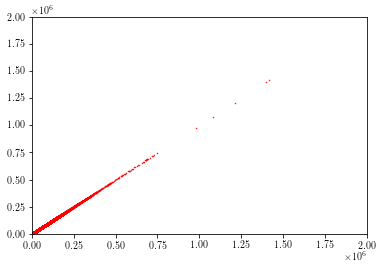

In [ ]:
plt.figure()
plt.plot(vA_wnd[0:], df['Alfven_speed_wnd'][0:], 'r.', ms=1)
plt.xlim(0, 2e6)
plt.ylim(0, 2e6)
#plt.plot(wnd_data.index[0:1000], vA_wnd[0:1000]*1000, 'b.', ms=1)

In [ ]:
np.mean(vA_wnd[vA_wnd<=5e5]), np.mean(vA_wnd)

(46543.63183956101, 46577.38986743763)

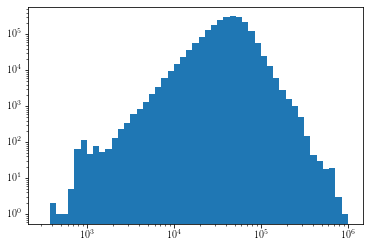

In [ ]:
bins = np.logspace(2.5, 6, 50)
hist = plt.hist(vA_wnd, bins=bins)
plt.yscale('log')
plt.xscale('log')

In [ ]:
wnd_data.di.describe()

count    334942.000000
mean        103.516935
std          30.332525
min          32.257520
25%          81.985828
50%         100.576862
75%         122.336047
max         321.961117
Name: di, dtype: float64

## Making figures

In [ ]:
df = pd.read_pickle('data/palasma_parameters_mms_psp_wnd_SI_v04.p')

In [ ]:
key_list = ['d_i', 'debye', 'gyrofrequency', 'gyroradius', 'plasma_frequency', 'Alfven_speed']
key_name = {'d_i':r'$d_i$',
            'debye':r'$\lambda_D$',
            'gyrofrequency':r'$\Omega_{cp}$',
            'gyroradius':r'$\rho_p$',
            'plasma_frequency':r'$\omega_{pp}$',
            'Alfven_speed':r'$v_A$'}

plt.clf()
plt.close('all')
for spc in ['wnd']:#['mms', 'wnd', 'psp'] :

    fig = plt.figure(num=None, figsize=( 5, 5 ), dpi=200, facecolor='w', edgecolor='gray')
    fig.subplots_adjust(left=0.01, right=0.99, top=0.99, bottom=0.01, wspace=0.0, hspace=0.)

    j = 1
    #try :
    for kk in range(1) :
        for key in key_list[0:] :
            param = f'{key}_{spc}'
            #print(param, spc)

            try :
                xx = df[param].value
            except :
                xx = df[param]
            n_bins = 20
            xscale = 'log'
            yscale = 'log'

            x_10 = np.nanpercentile(xx, 10)
            x_25 = np.nanpercentile(xx, 25)
            x_75 = np.nanpercentile(xx, 75)
            x_90 = np.nanpercentile(xx, 90)

            labelsize = 20
            legend_size = 18

            xmin = np.nanmin(xx)
            xmax = np.nanmax(xx[xx!=np.inf])
            if np.isnan(xmax) :
                xmax = np.nanmax(xx)

            #print(x_10, x_25,x_75,x_90, xmax, xmin)

            # Define the axes in the figure
            axs = fig.add_subplot( 2, 3, j )

            if xscale == 'log' :
                bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
            elif xscale == 'linear' :
                bins = np.linspace(xmin, xmax, n_bins)

            axs.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[key])

            axs.axvspan(x_10, x_90, alpha=0.3, facecolor='c')

            axs.axvspan(x_25, x_75, alpha=0.2, facecolor='m')

            axs.legend(loc=1, fontsize=legend_size)
            axs.set_xscale(xscale)
            axs.set_yscale(yscale)
            axs.set_xlabel(r'$d_i$', fontsize=labelsize)
            if (j==0 or j==3) :
                axs.tick_params(axis='y', which='both', direction='in', labelbottom=False,
                                bottom=False, labelleft=True, left=True, width=1.5,
                                labelsize=labelsize, labelrotation=0)
            elif (j==1 or j==4) :
                axs.tick_params(axis='y', which='both', direction='in', labelbottom=False,
                                bottom=False, labelleft=False, left=False, width=1.5,
                                labelsize=labelsize, labelrotation=0)
            elif (j==2 or j==5) :
                axs.tick_params(axis='y', which='both', direction='in', labelbottom=False,
                                bottom=False, labelleft=False, left=False, labelright=True,
                                right=True, width=1.5, labelsize=labelsize, labelrotation=0)

            j += 1
    #except :
    #    pass
#plt.show()
#plt.savefig('figures/chap1/plasma_parameters_all_spc.pdf', bbox_inches='tight', pad_inches=0.05,
#            dpi=300)

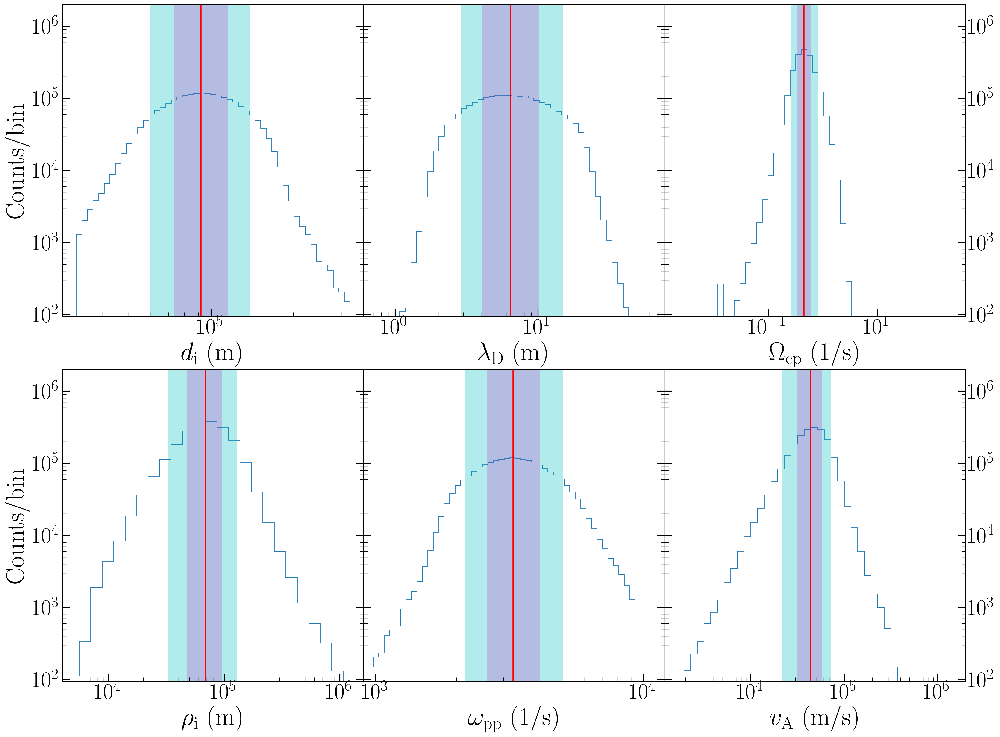

In [ ]:
key_list = ['d_i', 'debye', 'gyrofrequency', 'gyroradius', 'plasma_frequency', 'Alfven_speed']
key_name = {'d_i':r'$d_i (m)$',
            'debye':r'$\lambda_D (m)$',
            'gyrofrequency':r'$\Omega_{cp} (1/s)$',
            'gyroradius':r'$\rho_p (m)$',
            'plasma_frequency':r'$\omega_{pp} (1/s)$',
            'Alfven_speed':r'$v_A (m/s)$'}

fig = plt.figure(num=None, figsize=(20, 15), dpi=200, facecolor='w', edgecolor='gray')
fig.subplots_adjust(left=0.01, right=0.99, top=0.99, bottom=0.01, wspace=0.0, hspace=0.17)

labelsize = 35
legend_size = 40
tick_length = 12
minor_tick_length = 6
tick_width = 1.5
minor_tick_width = 0.5
nbins = 50
line_width = 2

# for d_i

param = 'd_i_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs1 = fig.add_subplot( 2, 3, 1 )

if xscale == 'log' :
    bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs1.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs1.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs1.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs1.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs1.legend(loc=1, fontsize=legend_size)
#leg = axs1.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs1.set_ylabel('Counts/bin', fontsize=legend_size)
axs1.set_xlabel(r'$d_{\rm i}$ (m)', fontsize=legend_size)

axs1.set_xscale(xscale)
axs1.set_yscale(yscale)
axs1.set_ylim(0, 2e6)

axs1.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs1.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

# for lambda_d

param = 'debye_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs2 = fig.add_subplot( 2, 3, 2, sharey=axs1 )

if xscale == 'log' :
    bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs2.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs2.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs2.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs2.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs2.legend(loc=1, fontsize=legend_size)
#leg = axs2.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs2.set_xlabel(r'$\lambda_{\rm D}$ (m)', fontsize=legend_size)

axs2.set_xscale(xscale)
axs2.set_yscale(yscale)

axs2.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=False, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs2.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=False, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

# for omega_cp

param = 'gyrofrequency_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs3 = fig.add_subplot( 2, 3, 3, sharey=axs1 )

if xscale == 'log' :
    bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs3.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs3.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs3.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs3.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs3.legend(loc=1, fontsize=legend_size)
#leg = axs3.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs3.set_xlabel(r'$\Omega_{\rm cp}$ (1/s)', fontsize=legend_size)

axs3.set_xscale(xscale)
axs3.set_yscale(yscale)

axs3.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=True, labelleft=False, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs3.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=True, labelleft=False, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

# for rho_p

param = 'gyroradius_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs4 = fig.add_subplot( 2, 3, 4, sharey=axs1 )

if xscale == 'log' :
    bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs4.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs4.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs4.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs4.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs4.legend(loc=1, fontsize=legend_size)
#leg = axs4.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs4.set_ylabel('Counts/bin', fontsize=legend_size)
axs4.set_xlabel(r'$\rho_{\rm i}$ (m)', fontsize=legend_size)

axs4.set_xscale(xscale)
axs4.set_yscale(yscale)
axs4.set_ylim(0, 2e6)
axs4.set_xlim(4e3, 1.6e6)

axs4.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs4.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

#for omega_pp

param = 'plasma_frequency_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs5 = fig.add_subplot( 2, 3, 5, sharey=axs1 )

if xscale == 'log' :
    bins = np.logspace(np.log10(xmin), np.log10(xmax), n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs5.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs5.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs5.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs5.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs5.legend(loc=1, fontsize=legend_size)
#leg = axs5.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs5.set_xlabel(r'$\omega_{\rm pp}$ (1/s)', fontsize=legend_size)

axs5.set_xscale(xscale)
axs5.set_yscale(yscale)
axs5.set_xlim(9e2, 1.2e4)

axs5.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                 right=True, labelright=False, labelleft=False, left=True, width=tick_width,
                 length=tick_length, labelsize=labelsize, labelrotation=0)
axs5.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                 right=True, labelright=False, labelleft=False, left=True, width=minor_tick_width,
                 length=minor_tick_length, labelsize=labelsize, labelrotation=0)
#for v_A
param = 'Alfven_speed_wnd'
try :
    xx = df[param].value
except :
    xx = df[param]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_10 = np.nanpercentile(xx, 10)
x_25 = np.nanpercentile(xx, 25)
x_75 = np.nanpercentile(xx, 75)
x_90 = np.nanpercentile(xx, 90)

xmin = np.nanmin(xx)
xmax = np.nanmax(xx[xx!=np.inf])
if np.isnan(xmax) :
    xmax = np.nanmax(xx)

# Define the axes in the figure
axs6 = fig.add_subplot( 2, 3, 6, sharey=axs1 )

if xscale == 'log' :
    bins = np.logspace(2.5, 6, n_bins)
elif xscale == 'linear' :
    bins = np.linspace(xmin, xmax, n_bins)

axs6.hist(xx, bins=bins, density=False, histtype='step', align='mid', label=key_name[param[:-4]])
axs6.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
axs6.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs6.vlines(np.nanmedian(xx), 0, 2e6, 'r', lw=line_width)

#axs6.legend(loc=1, fontsize=legend_size)
#leg = axs6.legend(handlelength=0, handletextpad=0, fancybox=True, fontsize=legend_size, loc='best')
#for item in leg.legendHandles:
#    item.set_visible(False)
axs6.set_xlabel(r'$v_{\rm A}$ (m/s)', fontsize=legend_size)

axs6.set_xscale(xscale)
axs6.set_yscale(yscale)
axs6.set_xlim(1.2e3, 2e6)

axs6.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=True, labelleft=False, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs6.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=True, labelleft=False, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

plt.savefig('figures/chap1/plasma_parameters_wnd.pdf', bbox_inches='tight', pad_inches=0.05,
            dpi=300)

In [ ]:
key_list = ['d_i', 'debye', 'gyrofrequency', 'gyroradius', 'plasma_frequency', 'Alfven_speed']
key_name = {'d_i':r'$d_i$',
            'debye':r'$\lambda_D$',
            'gyrofrequency':r'$\Omega_{cp}$',
            'gyroradius':r'$\rho_p$',
            'plasma_frequency':r'$\omega_{pp}$',
            'Alfven_speed':r'$v_A$'}

for spc in ['mms']:#['wnd', 'psp', 'mms'] :
    for key in key_list :
        param = f'{key}_{spc}'
        xx = df[param]
        diff = np.nanpercentile(xx, 75) - np.nanpercentile(xx, 25)
        print(f'{key_name[key]}-{spc} = {np.nanmedian(xx)}, pm ({diff})\n')

$d_i$-mms = 45600.768968434335 m, pm (9861.311941304652 m)

$\lambda_D$-mms = 23.184502128332625 m, pm (7.946098910665473 m)

$\Omega_{cp}$-mms = 2.1637623541771323 rad / s, pm (0.9876589276262617 rad / s)

$\rho_p$-mms = 97795.78874116248 m, pm (68965.4484189213 m)

$\omega_{pp}$-mms = 6574.28514435115 rad / s, pm (1472.7601582400493 rad / s)

$v_A$-mms = 94256.60131354685, pm (50064.7877880938)



# Chapter 2

## Temperature profiles

In [124]:
%%time

wnd_data = pd.read_pickle('data/all_wind_data_v06.p')
psp_data = pd.read_pickle('data/psp_e1_all_merged_data.p')
mms_data1 = pd.read_pickle('data/all_spc_20160111_20160124_20170118_20171226.p')
mms_data2 = pd.read_pickle('data/all_spc_20160111_20160124_20170118_20171226_new_set.p')

CPU times: user 324 ms, sys: 2.37 s, total: 2.7 s
Wall time: 9.8 s


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


CPU times: user 1.49 s, sys: 1.32 s, total: 2.81 s
Wall time: 7.34 s


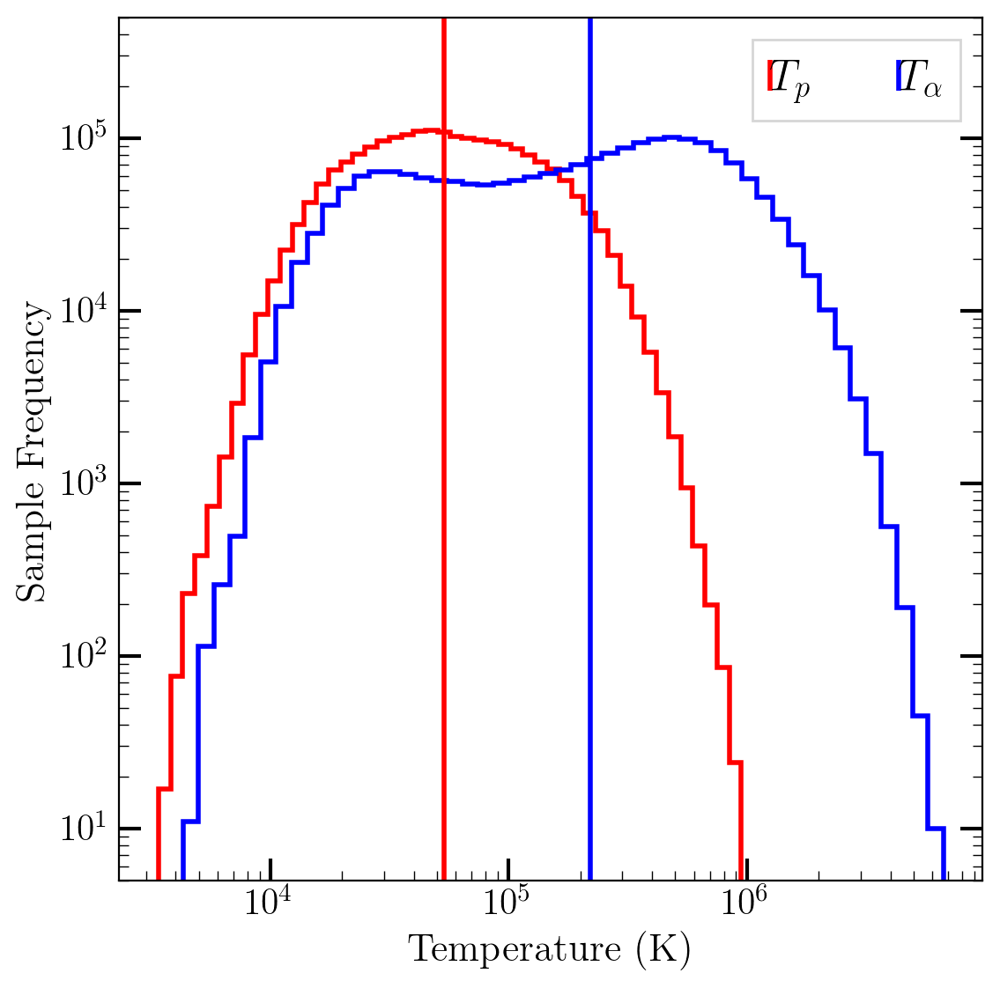

In [125]:
%%time

fig = plt.figure(num=None, figsize=(5, 5), dpi=200, facecolor='w', edgecolor='gray')
fig.subplots_adjust(left=0.01, right=0.99, top=0.99, bottom=0.01, wspace=0.0, hspace=0.07)

labelsize = 15
axis_labelsize = 16
legend_size = 18
tick_length = 9
minor_tick_length = 4
tick_width = 1.5
minor_tick_width = 0.5
nbins = 50
line_width = 2

# for Protons

param_p = 't_p'
try :
    xx_p = wnd_data[param_p].value
except :
    xx_p = wnd_data[param_p]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_p_10 = np.nanpercentile(xx_p, 10)
x_p_25 = np.nanpercentile(xx_p, 25)
x_p_75 = np.nanpercentile(xx_p, 75)
x_p_90 = np.nanpercentile(xx_p, 90)

xmin_p = np.nanmin(xx_p)
xmax_p = np.nanmax(xx_p[xx_p!=np.inf])
if np.isnan(xmax_p) :
    xmax_p = np.nanmax(xx_p)

# For alpha particles

param_a = 't_a'
try :
    xx_a = wnd_data[param_a].value
except :
    xx_a = wnd_data[param_a]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_a_10 = np.nanpercentile(xx_a, 10)
x_a_25 = np.nanpercentile(xx_a, 25)
x_a_75 = np.nanpercentile(xx_a, 75)
x_a_90 = np.nanpercentile(xx_a, 90)

xmin_a = np.nanmin(xx_a)
xmax_a = np.nanmax(xx_a[xx_a!=np.inf])
if np.isnan(xmax_a) :
    xmax_a = np.nanmax(xx_a)

# Define the axes in the figure
axs1 = fig.add_subplot( 1, 1, 1 )

if xscale == 'log' :
    bins_p = np.logspace(np.log10(xmin_p), np.log10(xmax_p), n_bins)
elif xscale == 'linear' :
    bins_p = np.linspace(xmin_p, xmax_p, n_bins)

if xscale == 'log' :
    bins_a = np.logspace(np.log10(xmin_a), np.log10(xmax_a), n_bins)
elif xscale == 'linear' :
    bins_a = np.linspace(xmin_a, xmax_a, n_bins)

axs1.hist(xx_p, bins=bins_p, density=False, color='r', histtype='step', align='mid', linewidth=line_width, label=r'$T_p$')
#axs1.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
#axs1.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs1.vlines(np.nanmedian(xx_p), 0, 2e6, 'r', lw=line_width)


axs1.hist(xx_a, bins=bins_a, density=False, color='b', histtype='step', align='mid', linewidth=line_width, label=r'$T_\alpha$')
#axs1.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
#axs1.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs1.vlines(np.nanmedian(xx_a), 0, 2e6, 'b', lw=line_width)

#axs1.legend(loc='best', fontsize=legend_size)
leg = axs1.legend(ncol=2, handlelength=0, handletextpad=0, fancybox=False, fontsize=legend_size, loc='best')
for item in leg.legendHandles:
    item.set_visible(True)

axs1.set_xscale(xscale)
axs1.set_yscale(yscale)
axs1.set_ylim(5e0, 5e5)
axs1.set_xlabel('Temperature (K)', fontsize=axis_labelsize)
axs1.set_ylabel('Sample Frequency', fontsize=axis_labelsize)

axs1.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs1.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

plt.savefig('figures/chap2/proton_alpha_temp_dist_wnd.pdf', bbox_inches='tight', pad_inches=0.05,
            dpi=300)

In [ ]:
nd_data.keys(), mms_data1.keys()

(Index(['b', 'b_x', 'b_y', 'b_z', 'beta_par_a', 'beta_par_p', 'c_a', 'c_a_var',
        'col_age', 'dv_ap', 'dvca', 'dvca_var', 'n_a', 'n_i', 'n_p', 'nanp',
        'r_a', 'r_p_x', 't_a', 't_i', 't_p', 't_par_a', 't_par_p', 't_per_a',
        't_per_p', 't_sec', 'tatp', 'time_new', 'v_p', 'v_x_p', 'v_y_p',
        'v_z_p', 'w_par_a', 'w_par_p', 'w_per_a', 'w_per_p', 'b_p', 'di', 'dl',
        'g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per',
        'k_b_par', 'k_b_per', 'lin_time', 'omnl', 'omnl_time', 'r_p_y'],
       dtype='object'),
 Index(['T_p', 'b_p', 'g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'j_mag',
        'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per', 'pvi', 'r_p', 'time',
        'omnl'],
       dtype='object'))

## Anisotropy profiles

CPU times: user 1.13 s, sys: 551 ms, total: 1.68 s
Wall time: 3.79 s


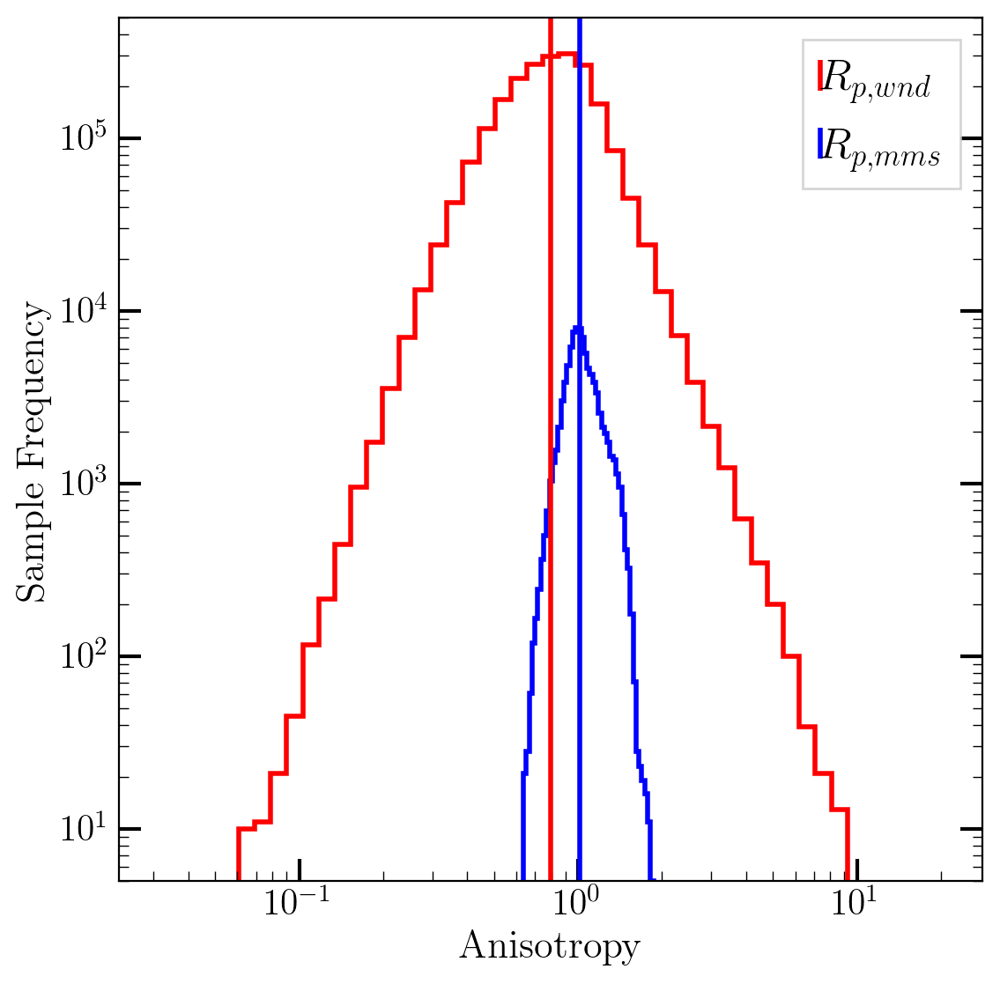

In [126]:
%%time

fig = plt.figure(num=None, figsize=(5, 5), dpi=200, facecolor='w', edgecolor='gray')
fig.subplots_adjust(left=0.01, right=0.99, top=0.99, bottom=0.01, wspace=0.0, hspace=0.07)

labelsize = 15
axis_labelsize = 16
legend_size = 18
tick_length = 9
minor_tick_length = 4
tick_width = 1.5
minor_tick_width = 0.5
nbins = 50
line_width = 2

# for Protons

param_p = 'r_p_x'
try :
    xx_p = wnd_data[param_p].value
except :
    xx_p = wnd_data[param_p]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_p_10 = np.nanpercentile(xx_p, 10)
x_p_25 = np.nanpercentile(xx_p, 25)
x_p_75 = np.nanpercentile(xx_p, 75)
x_p_90 = np.nanpercentile(xx_p, 90)

xmin_p = np.nanmin(xx_p)
xmax_p = np.nanmax(xx_p[xx_p!=np.inf])
if np.isnan(xmax_p) :
    xmax_p = np.nanmax(xx_p)

# For alpha particles

param_a = 'r_p'
try :
    xx_a = mms_data1[param_a].value
except :
    xx_a = mms_data1[param_a]
n_bins = nbins
xscale = 'log'
yscale = 'log'

x_a_10 = np.nanpercentile(xx_a, 10)
x_a_25 = np.nanpercentile(xx_a, 25)
x_a_75 = np.nanpercentile(xx_a, 75)
x_a_90 = np.nanpercentile(xx_a, 90)

xmin_a = np.nanmin(xx_a)
xmax_a = np.nanmax(xx_a[xx_a!=np.inf])
if np.isnan(xmax_a) :
    xmax_a = np.nanmax(xx_a)

# Define the axes in the figure
axs1 = fig.add_subplot( 1, 1, 1 )

if xscale == 'log' :
    bins_p = np.logspace(np.log10(xmin_p), np.log10(xmax_p), n_bins)
elif xscale == 'linear' :
    bins_p = np.linspace(xmin_p, xmax_p, n_bins)

if xscale == 'log' :
    bins_a = np.logspace(np.log10(xmin_a), np.log10(xmax_a), n_bins)
elif xscale == 'linear' :
    bins_a = np.linspace(xmin_a, xmax_a, n_bins)

axs1.hist(xx_p, bins=bins_p, density=False, color='r', histtype='step', align='mid', linewidth=line_width, label=r'$R_{p,wnd}$')
#axs1.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
#axs1.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs1.vlines(np.nanmedian(xx_p), 0, 2e6, 'r', lw=line_width)


axs1.hist(xx_a, bins=bins_a, density=False, color='b', histtype='step', align='mid', linewidth=line_width, label=r'$R_{p,mms}$')
#axs1.axvspan(x_10, x_90, alpha=0.3, facecolor='c')
#axs1.axvspan(x_25, x_75, alpha=0.2, facecolor='m')
axs1.vlines(np.nanmedian(xx_a), 0, 2e6, 'b', lw=line_width)

#axs1.legend(loc='best', fontsize=legend_size)
leg = axs1.legend(ncol=1, handlelength=0, handletextpad=0, fancybox=False, fontsize=legend_size, loc=1)
for item in leg.legendHandles:
    item.set_visible(True)

axs1.set_xscale(xscale)
axs1.set_yscale(yscale)
axs1.set_ylim(5e0, 5e5)
axs1.set_xlabel('Anisotropy', fontsize=axis_labelsize)
axs1.set_ylabel('Sample Frequency', fontsize=axis_labelsize)

axs1.tick_params(axis='both', which='major', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=tick_width,
                length=tick_length, labelsize=labelsize, labelrotation=0)
axs1.tick_params(axis='both', which='minor', direction='in', labelbottom=True, bottom=True,
                right=True, labelright=False, labelleft=True, left=True, width=minor_tick_width,
                length=minor_tick_length, labelsize=labelsize, labelrotation=0)

plt.savefig('figures/chap2/proton_aniso_dis_mms_wnd.pdf', bbox_inches='tight', pad_inches=0.05,
            dpi=300)

## Growth rate contours

In [ ]:
!pwd

/content/gdrive/Shareddrives/Shadowfax/Active_Research/udthesis


CPU times: user 13.1 s, sys: 298 ms, total: 13.4 s
Wall time: 13.4 s


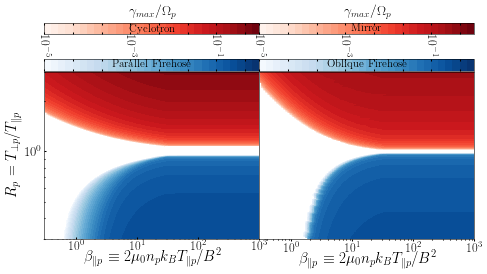

In [ ]:
%%time

plt.close('all')
# Calculate the values of gamma for parallel propagation for
# both the halves of the Brazil plot.

b  = np.logspace( -0.5,  3.1, 100 )
r1 = np.linspace(    1,  3, 200 )
r2 = np.linspace(  0.3,  1, 200 )

#b  = logspace( -1, 3, 500 )
#r1 = logspace(  0, 1, 500 )
#r2 = logspace( -1, 0, 500 )

( xx1, yy1 ) = np.meshgrid( b, r1 )
( xx2, yy2 ) = np.meshgrid( b, r2 )

#run_spl = raw_input( 'Run the spline part? ==> ' )
run_spl = '1'

if(run_spl) :

    g_a_par = spl_int( xx1, yy1, ang='par' )
    g_b_par = spl_int( xx2, yy2, ang='par' )

    g_a_per = spl_int( xx1, yy1, ang='per' )
    g_b_per = spl_int( xx2, yy2, ang='per' )

g_a_par_e = g_a_par[0].copy()
g_b_par_e = g_b_par[1].copy()
g_a_per_e = g_a_per[0].copy()
g_b_per_e = g_b_per[1].copy()

#for i in range( shape( g_a_par )[0] ) :
#
#    for j in range( shape( g_a_par )[1] ) :
num_iter = 1

for k in range( num_iter ) :

    for i in range( 1, np.shape(xx1)[0] - 1) :

        for j in range( 1, np.shape(xx1)[1] - 1 ) :

    #        g_a_par_e[i,j] = 0.5*g_a_par_e[i,j] + 0.125*g_a_par_e[i+1, j] + \
    #        0.125*g_a_par_e[i, j+1] + 0.125*g_a_par_e[i-1, j] + 0.125*g_a_par_e[i, j-1]
    #
    #        g_b_par_e[i,j] = 0.5*g_b_par[i,j] + 0.125*g_b_par[i+1, j] + \
    #        0.125*g_b_par[i, j+1] + 0.125*g_b_par[i-1, j] + 0.125*g_b_par[i, j-1]

            if( ~np.isnan( g_a_par_e[i,j] ) ) :

                g_a_par_e[i,j] = 0.25*g_a_par_e[i,j] + 0.125*g_a_par_e[i+1, j] + \
                               0.125*g_a_par_e[i, j+1] + 0.125*g_a_par_e[i-1, j] +\
                               0.125*g_a_par_e[i, j-1] + 0.0625*g_a_par_e[i+1, j+1] \
                               + 0.0625*g_a_par_e[i+1, j-1] + 0.0625*g_a_par_e[i-1, j+1]\
                              + 0.0625*g_a_par_e[i-1, j-1] 

            if( ~np.isnan( g_b_par_e[i,j] ) ) :

                g_b_par_e[i,j] = 0.25*g_b_par_e[i,j] + 0.125*g_b_par_e[i+1, j] + \
                               0.125*g_b_par_e[i, j+1] + 0.125*g_b_par_e[i-1, j] +\
                               0.125*g_b_par_e[i, j-1] + 0.0625*g_b_par_e[i+1, j+1] \
                               + 0.0625*g_b_par_e[i+1, j-1] + 0.0625*g_b_par_e[i-1, j+1]\
                              + 0.0625*g_b_par_e[i-1, j-1] 

            if( ~np.isnan( g_a_per_e[i,j] ) ) :

                g_a_per_e[i,j] = 0.25*g_a_per_e[i,j] + 0.125*g_a_per_e[i+1, j] + \
                               0.125*g_a_per_e[i, j+1] + 0.125*g_a_per_e[i-1, j] +\
                               0.125*g_a_per_e[i, j-1] + 0.0625*g_a_per_e[i+1, j+1] \
                               + 0.0625*g_a_per_e[i+1, j-1] + 0.0625*g_a_per_e[i-1, j+1]\
                              + 0.0625*g_a_per_e[i-1, j-1] 

            if( ~np.isnan( g_b_per_e[i,j] ) ) :

                g_b_per_e[i,j] = 0.25*g_b_per_e[i,j] + 0.125*g_b_per_e[i+1, j] + \
                               0.125*g_b_per_e[i, j+1] + 0.125*g_b_per_e[i-1, j] +\
                               0.125*g_b_per_e[i, j-1] + 0.0625*g_b_per_e[i+1, j+1] \
                               + 0.0625*g_b_per_e[i+1, j-1] + 0.0625*g_b_per_e[i-1, j+1]\
                              + 0.0625*g_b_per_e[i-1, j-1] 

# Parallel component

levels=31
xlabel = r'$\beta_{\parallel p} \equiv 2\mu_0 n_p k_B T_{\parallel p}/B^2$'
ylabel = r'$R_p = T_{\perp p}/T_{\parallel p}$'

fig = plt.figure(num=None, figsize=( 10, 6 ), dpi=50, facecolor='w', edgecolor='k')

fig.subplots_adjust(left=0.11, right=0.97, top=0.88, bottom=0.16, wspace=0.0, hspace=0)

axs1 = fig.add_subplot( 1, 2, 1 )

cs1 = axs1.contourf( xx1, yy1, g_a_par_e, levels=np.logspace( -5, 0, levels ),
cmap=plt.cm.Reds, norm=mpl.colors.LogNorm() )

cs1.ax.get_xaxis().set_tick_params( which='major', direction='in',
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=0 )

cs1.ax.get_yaxis().set_tick_params( which='both', direction='in',
labelleft=True, left=True, width=1.5, labelsize=0, labelrotation=0)
cs1.ax.get_yaxis().set_tick_params( which='minor', direction='in',
labelleft=False, bottom=True, width=1.5, labelsize=18, labelrotation=0 )

cs1.ax.set_yticklabels(cs1.ax.get_xticklabels(), rotation=0, fontsize=20 )

cs2 = axs1.contourf( xx2, yy2, g_b_par_e, levels=np.logspace( -5, 0, levels ),
cmap=plt.cm.Blues, norm=mpl.colors.LogNorm() )

# Create a new axis for colorbar

divider = make_axes_locatable(axs1)

# Define the location of the colorbar, it's size relative to main figure 
# and the padding between the colorbar and the figure, the orientation
# the colorbar

## Horizontal Colorbars

cax2 = divider.append_axes("top", size="7%", pad=0.01 )

cax1 = divider.append_axes("top", size="7%", pad=.5 )

cbar1 = plt.colorbar( cs1, cax=cax1, orientation='horizontal', ticks=None, 
fraction=0.95, pad=0.0 )

cbar1.ax.get_xaxis().set_tick_params(which='both', direction='in', labeltop=False,
                                     labelbottom=True, top=True, bottom=True, width=1.5,
                                     labelsize=18, rotation=270, pad=0)

cbar1.ax.text(0.5, 0.5, 'Cyclotron', verticalalignment='center', horizontalalignment='center',
              fontsize=16, transform=cbar1.ax.transAxes)

cbar1.ax.set_xlabel('$\gamma_{max}/\Omega_p$', labelpad=-75, fontsize=20)

cbar2 = plt.colorbar(cs2, cax=cax2, orientation='horizontal', ticks=None, fraction=0.95, shrink=0.5,
                     pad=0.01)
cbar2.ax.get_xaxis().set_tick_params(which='both', direction='in', labeltop=False,
                                     labelbottom=False, top=True, bottom=True, width=1.5,
                                     labelsize=18, rotation=270, pad=0)

cbar2.ax.text(0.5, 0.5, 'Parallel Firehose', verticalalignment='center',
              horizontalalignment='center', fontsize=16, transform=cbar2.ax.transAxes)

axs1.set_xlim( 0.3, 1000 )
axs1.set_ylim( 0.3, 3. )
axs1.set_yscale( 'log' )
axs1.set_xscale( 'log' )
axs1.set_xlabel(xlabel, fontsize=22, labelpad=-5)
axs1.set_ylabel(ylabel, fontsize=22)

axs2 = fig.add_subplot( 1, 2, 2, sharex=axs1 )

cs3 = axs2.contourf( xx1, yy1, g_a_per_e, interpolation='nearest', levels=np.logspace( -5, 0, levels ),
cmap=plt.cm.Reds, norm=mpl.colors.LogNorm() )

cs3.ax.get_xaxis().set_tick_params( which='both', direction='out',
labelbottom=True, bottom=True, width=1.5, labelsize=18, labelrotation=0)

cs3.ax.get_yaxis().set_tick_params( which='both', direction='out',
labelleft=False, left=False, width=1.5, labelsize=18, labelrotation=0)

cs4 = axs2.contourf( xx2, yy2, g_b_per_e, levels=np.logspace( -5, 0, levels ),
cmap=plt.cm.Blues, norm=mpl.colors.LogNorm() )

# Create a new axis for colorbar

divider = make_axes_locatable(axs2)

# Define the location of the colorbar, it's size relative to main figure 
# and the padding between the colorbar and the figure, the orientation
# the colorbar

## Horizontal colorbars

cax4 = divider.append_axes("top", size="7%", pad=0.01 )

cax3 = divider.append_axes("top", size="7%", pad=0.5 )

cbar3 = plt.colorbar( cs3, cax=cax3, orientation='horizontal', ticks=None, 
fraction=0.95, pad=0.01 )

cbar3.ax.get_xaxis().set_tick_params(which='both', direction='in', labeltop=False,
                                     labelbottom=True, top=True, bottom=True, width=1.5,
                                     labelsize=18, rotation=270, pad=0)

cbar3.ax.set_xlabel( '$\gamma_{max}/\Omega_p$', labelpad=-75, fontsize=20 )

cbar3.ax.text(0.5, 0.5, 'Mirror', verticalalignment='center',
              horizontalalignment='center', fontsize=16, transform=cbar3.ax.transAxes)

cbar4 = plt.colorbar(cs4, cax=cax4, orientation='horizontal', ticks=None, fraction=0.95, pad=0.01)

cbar4.ax.get_xaxis().set_tick_params(which='both', direction='in', labeltop=False,
                                     labelbottom=False, top=True, bottom=True, width=1.5,
                                     labelsize=18, rotation=270, pad=0)

cbar4.ax.text(0.5, 0.5, 'Oblique Firehose', verticalalignment='center',
              horizontalalignment='center', fontsize=16, transform=cbar4.ax.transAxes)

axs2.set_xlim( 0.3, 1000 )
axs2.set_ylim( 0.3, 3. )
axs2.set_yscale( 'log' )
axs2.set_xscale( 'log' )
axs2.set_xlabel( xlabel, fontsize=22, labelpad=-5 )

#plt.tight_layout()

#plt.show()

plt.savefig('figures/chap2/growth_rate_contours.pdf', bbox_inches='tight', pad_inches=0.05,
            dpi=50)

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

In [ ]:
%%time
dates = ['20160111', '20160124', '20170118', '20171226']

param_list = ['ion_temp_aniso', 'ion_time_strt', 'mag_vec', 'ion_time_stop', 'ion_temp_per',
          'ion_temp_par', 'ion_dens', 'curr_vec', 'mag_mag', 'ion_beta_par', 'elec_dens',
          'ion_temp_tot', 'ion_vel_vec', 'curr_mag', 'elec_vel_vec']

temp_file_list = []
for date in dates :
    temp_file_list.append(np.sort(glob(f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/sync_i/sync_{date}_*.p')))

file_list = temp_file_list[0]
for xx in temp_file_list[1:] :
    file_list = np.concatenate((file_list, xx))
file_list

df_list = []
for files in file_list :
    new_dat = pd.read_pickle(files)
    df = pd.DataFrame()

    for param in param_list :

        if 'vec' in param :
            df[f'{param}_x'] = new_dat[param][:,0]
            df[f'{param}_y'] = new_dat[param][:,1]
            df[f'{param}_z'] = new_dat[param][:,2]
        else :
            df[param] = new_dat[param]
    df_list.append(df)

df = pd.concat(df_list)
df.set_index(df.ion_time_strt, inplace=True)

CPU times: user 2.8 s, sys: 82.7 ms, total: 2.89 s
Wall time: 3.04 s


In [ ]:
new_dat = pd.read_pickle(files)
new_dat.keys()

dict_keys(['ion_temp_aniso', 'ion_eigen_val', 'ion_time_strt', 'mag_vec', 'ion_time_stop', 'ion_temp_per', 'ion_temp_par', 'ion_dens', 'curr_vec', 'ion_temp_asym', 'mag_mag', 'ion_beta_par', 'ion_eigen_vec', 'elec_dens', 'var_curr_mag', 'var_curr_vec', 'ion_temp_tot', 'elec_spn_ton', 'var_ion_beta_par', 'mag_dir', 'ion_vel_vec', 'curr_mag', 'ion_temp_tens', 'n', 'ion_phi', 'ion_spn_ton', 'elec_vel_vec'])

In [ ]:
new_dat['elec']

In [ ]:
df.to_pickle('data/all_spc_20160111_20160124_20170118_20171226_new_set.p')

In [ ]:
df2 = pd.read_pickle('data/all_spc_2016011_20160124_20170118_20171226.p')
df2.head()

,T_p,b_p,g_a_par,g_a_per,g_b_par,g_b_per,j_mag,k_a_par,k_a_per,k_b_par,k_b_per,pvi,r_p,time,omnl
2016-01-11 00:57:04.142400026,137.033490,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.165627,1.452474e+09,NaN
2016-01-11 00:57:04.292399883,140.313634,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.178556,1.452474e+09,NaN
2016-01-11 00:57:04.442399979,152.046254,2.652278,2.377101e-27,-7.990382e-20,NaN,NaN,435.392313,1.640281e-23,-2.086824e-17,NaN,NaN,NaN,1.099789,1.452474e+09,NaN
2016-01-11 00:57:04.592400074,146.178050,3.225775,6.229751e-22,-3.443043e-16,NaN,NaN,296.459622,4.440515e-18,-7.843759e-14,NaN,NaN,NaN,1.118814,1.452474e+09,NaN
2016-01-11 00:57:04.742399931,138.937421,4.623624,-7.475171e-12,-5.293865e-09,NaN,NaN,105.844672,-4.809554e-08,-1.852837e-06,NaN,NaN,NaN,1.158446,1.452474e+09,NaN


In [ ]:
df3 = df.join(df2)

In [ ]:
df3.describe()

,ion_temp_aniso,mag_vec_x,mag_vec_y,mag_vec_z,ion_temp_per,ion_temp_par,ion_dens,curr_vec_x,curr_vec_y,curr_vec_z,mag_mag,ion_beta_par,elec_dens,ion_temp_tot,ion_vel_vec_x,ion_vel_vec_y,ion_vel_vec_z,curr_mag,elec_vel_vec_x,elec_vel_vec_y,elec_vel_vec_z,T_p,b_p,g_a_par,g_a_per,g_b_par,g_b_per,j_mag,k_a_par,k_a_per,k_b_par,k_b_per,pvi,r_p,time,omnl
count,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,9.321200e+04,9.321200e+04,9.321200e+04,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,93212.000000,9.321200e+04,93212.000000,93212.000000,93212.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,1.042892,8.377622,-10.178951,0.417863,252.004349,244.819183,38.778271,-5.478684e-08,-6.882862e-08,5.349064e-08,22.294897,16.045786,37.970662,249.608414,-164.357224,71.603874,33.030613,2.578055e-07,-156.861654,70.413322,19.923864,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,0.152534,10.109730,11.931717,11.858237,84.974251,85.261429,44.737572,3.106528e-07,2.560273e-07,1.398808e-07,7.880014,77.836755,36.023584,83.560524,54.808643,130.760178,65.158989,3.546233e-07,55.479346,126.611732,56.521572,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,0.612033,-44.230900,-50.868942,-56.340343,54.003780,61.895065,8.733708,-3.769313e-06,-2.855182e-06,-1.271770e-06,0.731013,0.731648,9.024965,56.756443,-389.097229,-221.354736,-178.855621,3.472482e-09,-482.014984,-439.343201,-253.692963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.944866,3.157516,-18.662771,-7.585071,188.937336,183.362698,20.737041,-6.791177e-08,-1.101784e-07,-6.333523e-09,17.159774,2.948250,22.233369,189.106510,-195.222755,-80.073202,-9.206402,9.994906e-08,-190.979469,-67.255699,-16.907722,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,1.016989,9.716128,-12.491288,0.157527,239.802177,229.767738,24.935771,1.115018e-08,-3.333275e-08,4.787564e-08,22.588997,5.071128,27.010099,236.426445,-160.776825,130.201714,47.386778,1.524991e-07,-154.580620,124.127144,29.509039,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,1.121444,14.780230,-3.551448,7.808266,318.700470,311.877998,32.176642,7.197385e-08,3.325424e-08,9.800562e-08,27.470622,11.042390,33.885023,316.210243,-123.866421,174.101116,83.613783,2.502717e-07,-117.836969,169.410000,61.019426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,2.011122,53.618359,50.041195,52.089993,546.149902,613.382324,284.556458,1.518402e-06,1.305344e-06,1.966794e-06,61.720959,8212.129870,244.909912,542.986023,-36.475552,256.708221,175.177856,4.474937e-06,138.738144,408.155670,294.368652,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
new_dat['n'], new_dat['ion_temp_aniso']

(24393, array([1.1825794 , 1.353414  , 2.4337199 , ..., 1.6115267 , 0.90960175,
        0.9763177 ], dtype=float32))

In [ ]:
new_dat['mag_vec'][:,0]

array([-1.52317965, -1.52434325, -1.51646066, ..., -1.30089378,
       -1.31434321, -1.2996285 ])

In [ ]:
new_dat['ion_temp_tot']

array([16.338182 , 14.726189 , 11.9828825, ..., 17.864965 , 12.166646 ,
       17.84413  ], dtype=float32)

# Chapter 4

## MMS

### Getting number density, velocity and temeperatures

In [ ]:
dates = ['20160111', '20160124', '20170118', '20171226']
n_p = []
v_p = []
t_p = []

for date in dates[:] :
    for n_spc in range(1,5) :

        print(date, n_spc)
        drct = f'/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/ions/{date}/ions/'
        n_p.append(np.loadtxt(f'{drct}Ni_{n_spc}_resNi_1.dat')[:,1])
        
        v_vec = np.loadtxt( f'{drct}Vi_{n_spc}_resNi_1.dat' )[:,1:4]
        v_p.append(np.array( [np.linalg.norm( v ) for v in v_vec ]))
        
        t_p.append(np.loadtxt(f'{drct}Ti_{n_spc}_resNi_1.dat')[:,1] * 11604.525)

print(round(np.nanmedian(n_p), 2), round(np.nanmedian(v_p), 2), round(np.nanmedian(t_p), 2)/1e6)

In [ ]:
yy = n_p[0]
nnp = np.array([np.concatenate((yy, xx)) for xx in n_p[1:]])

In [ ]:
nnp = t_p[0]
for i in range(0,15):
    nnp = np.hstack((nnp, t_p[i+1]))
np.nanmedian(nnp)

2743425.9390287152

In [ ]:
file_list = np.sort(glob('/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/brazil_riddhi/Brazil/data/gamma/mms_gamma_pickle_files/20171226_*_gamma_kdi_pvi_v02.p'))

df_list = []
for fn in file_list :
    df_list.append(pd.read_pickle(fn))
df = pd.concat(df_list)

key_list = ['T_p', 'r_p', 'b_p']
for key in key_list :
    print(f'{key} = {np.nanmedian(df[key])}')
print(np.min(df.index), np.max(df.index))

T_p = 228.95247219374
r_p = 1.036438998709021
b_p = 4.292597943629238
2017-12-26 06:12:43.839900017 2017-12-26 06:52:22.258699894


## WND

In [ ]:
fn2dip   = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2dip/data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe_v001.p'
fn2dpp   = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2dpp/data_Rp_betap_jz_b_149p6_v001.p'
fn2d     = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/2d/data_Rp_betap_jz_b_149p6_kaw_ti0p6te0p6_Time6000wpe_v001.p'
fn3d     = '/content/gdrive/Shareddrives/Casella/SpacePlasFest/mms/pic/data/3Ddata_Rp_betap_b_yan512_v001_rp_bp.p'
fnwnd    = 'data/all_wind_data_v06.p'
fnmms    = 'data/all_spc_20160111_20160124_20170118_20171226.p'
fnpsp    = 'data/psp_e1_gamma_omega_data.p'

In [ ]:
df = pd.read_pickle(fn2dpp)
df.describe()

,rp,bp,jz,bx,by,bz,a_par,b_par,a_per,b_per
count,1.677722e+07,1.677722e+07,1.677722e+07,1.677722e+07,1.677722e+07,1.677722e+07,35384.000000,183699.000000,43479.000000,262444.000000
mean,8.272566e-01,6.571735e-01,-4.627582e-05,8.812026e-13,1.455284e-13,1.000000e+00,0.002528,0.000168,0.334996,0.553557
std,1.896129e-01,8.037372e-02,1.705183e-01,2.122686e-01,2.102587e-01,5.402244e-02,0.002687,0.000279,0.159472,0.338496
min,1.963681e-01,3.738829e-01,-2.815526e+00,-6.799363e-01,-6.241115e-01,6.822113e-01,0.000010,0.000010,0.000010,0.000010
25%,6.981192e-01,6.038242e-01,-8.772211e-02,-1.406880e-01,-1.489445e-01,9.706717e-01,0.000525,0.000025,0.365568,0.051961
50%,8.280119e-01,6.407605e-01,9.693179e-04,3.750671e-03,3.808540e-03,1.004619e+00,0.001535,0.000067,0.402744,0.730832
75%,9.380164e-01,6.981633e-01,9.045103e-02,1.399842e-01,1.438030e-01,1.034023e+00,0.003673,0.000194,0.428229,0.800987
max,1.966903e+00,1.289388e+00,1.734744e+00,6.357424e-01,6.899247e-01,1.200969e+00,0.018165,0.002983,0.522310,0.996793


In [ ]:
df = pd.read_pickle(fn3d)
df.describe()

,rp,bp
count,1.342177e+08,1.342177e+08
mean,1.084225e+00,1.550714e+00
std,3.362436e-01,6.881313e+00
min,2.093990e-01,8.310004e-02
25%,8.409387e-01,5.177241e-01
50%,1.036849e+00,8.421411e-01
75%,1.278285e+00,1.370586e+00
max,3.615584e+00,5.340864e+03


# Chapter 5

### 2-D Cases (2 rows)

#### 149p6hb

/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/data_Rp_betap_jz_b_149p6_hb.h5
/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/gamma_k_149p6_hb.h5
<KeysViewHDF5 ['Rp', 'betap', 'bx', 'by', 'bz', 'jz']>
<KeysViewHDF5 ['g_a_par', 'g_a_per', 'g_b_par', 'g_b_per', 'k_a_par', 'k_a_per', 'k_b_par', 'k_b_per']>


KeyboardInterrupt: ignored

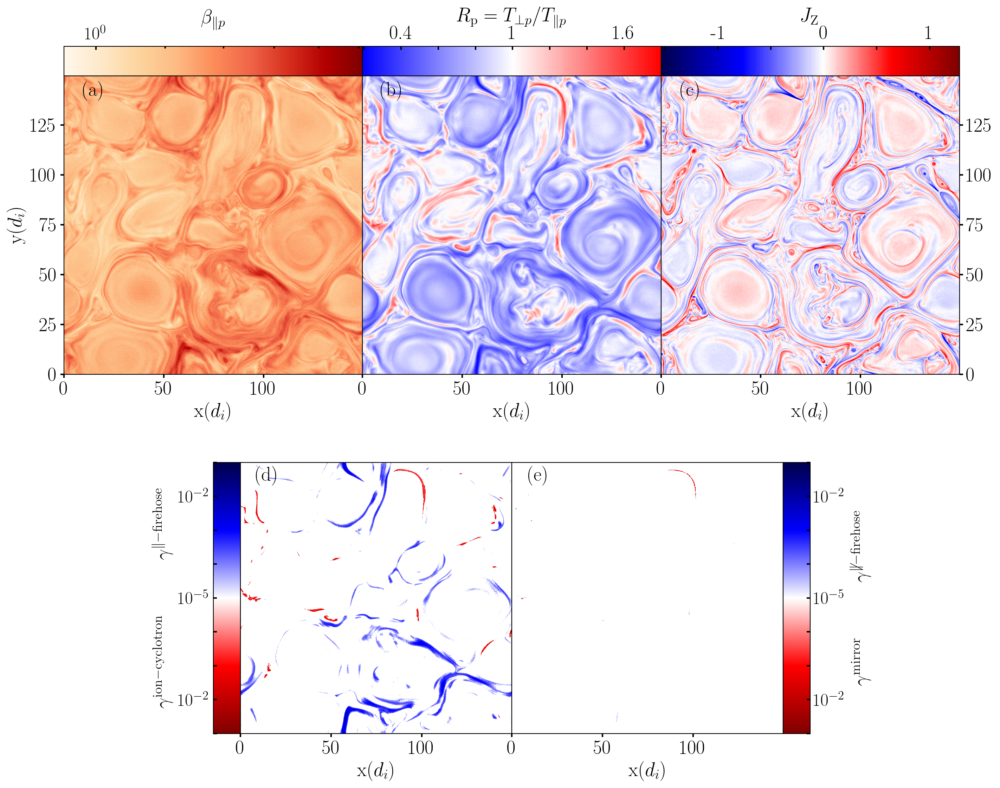

In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              #'data_Rp_betap_jz_b_149p6.h5',
              #'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              #'data_Rp_betap_jz_b_149p6_k28.h5',
              #'data_Rp_betap_jz_b_149p6_lb.h5',
              #'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              #'gamma_k_149p6.h5',
              #'gamma_k_149p6_dzobe1.h5',
              'gamma_k_149p6_hb.h5',
              #'gamma_k_149p6_k28.h5',
              #'gamma_k_149p6_lb.h5',
              #'gamma_k_149p6_rs0.h5',
              'gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[0:1], gamma_file_list[0:1] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp']

	    # Beta values

        bp = data['betap']

        # Magnetic field components

        b_x = data['bx'][:,:,0]
        b_y = data['by'][:,:,0]
        b_z = data['bz'][:,:,0]

        # z-component of the current

        #j_z = data_jz_b['jz'][:,:,0]

        j_z = data['jz'][:,:,0]

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        b_x_mat = np.asmatrix( b_x )
        b_y_mat = np.asmatrix( b_y )
        b_z_mat = np.asmatrix( b_z )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        # Change matrices to a 1d-array

        b_arr = b_mat.getA1( )

        r_arr = r_mat.getA1( )

        # Concatenate the anisotropy and beta arrays

        b_total = np.concatenate( ( b_total, b_arr ), axis=0 )
        r_total = np.concatenate( ( r_total, r_arr ), axis=0 )

        #om = om_mat.getA1()

        b_x_arr_arr = b_x_mat.getA1( )
        b_y_arr_arr = b_y_mat.getA1( )
        b_z_arr_arr = b_z_mat.getA1( )

        j_z_arr = j_mat.getA1( )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18

    fig = plt.figure( num=None, figsize=( 13, 11 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.95, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out', labelright=True, right=True, 
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.95, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out', labelright=True, right=True, labelleft=False, left=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.95, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', top=True, bottom=False, width=1.5, labelsize=labelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=labelsize )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.95, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("left", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_yticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='y', direction='in', labelleft=True, 
    labelright=False, color='k', left=True, right=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.yaxis.set_label_position('left')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_xlabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_ylabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )
    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.95, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("right", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_yticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='y', direction='in', labelright=True, 
    labelleft=False, color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.yaxis.set_label_position('right')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose',
    #                    x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_ylabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    #clabels2 = [ xx for xx in cbar2.get_ticks() ]
    #clabels2[0] = ''
    #clabels2[2] = ''
    #clabels2[4] = ''
    #clabels2[6] = ''
    #cbar2.ax.set_ticklabels(clabels2)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

#### kaw

In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = [
              #'data_Rp_betap_jz_b_149p6.h5',
              #'data_Rp_betap_jz_b_149p6_dzobe1.h5',
              'data_Rp_betap_jz_b_149p6_hb.h5',
              #'data_Rp_betap_jz_b_149p6_k28.h5',
              #'data_Rp_betap_jz_b_149p6_lb.h5',
              #'data_Rp_betap_jz_b_149p6_rs0.h5',
              'data_Rp_betap_jz_b_kaw_ti0p6te0p6_Time6000wpe.h5'
]

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = [
              #'gamma_k_149p6.h5',
              #'gamma_k_149p6_dzobe1.h5',
              'gamma_k_149p6_hb.h5',
              #'gamma_k_149p6_k28.h5',
              #'gamma_k_149p6_lb.h5',
              #'gamma_k_149p6_rs0.h5',
              'gamma_k_kaw_ti0p6te0p6_Time6000wpe.h5'
]

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

r_total = []
b_total = []

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[1:2], gamma_file_list[1:2] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )

        print(data.keys())
        print(gamma.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp']

	    # Beta values

        bp = data['betap']

        # Magnetic field components

        b_x = data['bx'][:,:,0]
        b_y = data['by'][:,:,0]
        b_z = data['bz'][:,:,0]

        # z-component of the current

        #j_z = data_jz_b['jz'][:,:,0]

        j_z = data['jz'][:,:,0]

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ]
        b_par = gamma[ key[1] ]
        a_per = gamma[ key[2] ]
        b_per = gamma[ key[3] ]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        b_x_mat = np.asmatrix( b_x )
        b_y_mat = np.asmatrix( b_y )
        b_z_mat = np.asmatrix( b_z )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        # Change matrices to a 1d-array

        b_arr = b_mat.getA1( )

        r_arr = r_mat.getA1( )

        # Concatenate the anisotropy and beta arrays

        b_total = np.concatenate( ( b_total, b_arr ), axis=0 )
        r_total = np.concatenate( ( r_total, r_arr ), axis=0 )

        #om = om_mat.getA1()

        b_x_arr_arr = b_x_mat.getA1( )
        b_y_arr_arr = b_y_mat.getA1( )
        b_z_arr_arr = b_z_mat.getA1( )

        j_z_arr = j_mat.getA1( )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18

    fig = plt.figure( num=None, figsize=( 13, 5 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 149.6, 0, 149.6]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.9, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)

    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out', labelright=True, right=True, 
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.9, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
#   norm=mpl.colors.Normalize( vmin=amin( j_mat ), vmax=amax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), 0. ) )

    im3.axes.tick_params( which='both', direction='out', labelright=True, right=True, labelleft=False, left=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.9, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', top=True, bottom=False, width=1.5, labelsize=labelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$J_{\mathrm{Z}}$', fontsize=labelsize )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.9, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("top", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='x', direction='in', labeltop=True, labelbottom=False, 
    color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.xaxis.set_label_position('top')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_xlabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_xlabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=0 )
    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.9, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("top", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='horizontal', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_xticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='x', direction='in', labeltop=True, labelbottom=False, 
    color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.xaxis.set_label_position('top')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose',
    #                    x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_xlabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        x= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=0 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    #clabels2 = [ xx for xx in cbar2.get_ticks() ]
    #clabels2[0] = ''
    #clabels2[2] = ''
    #clabels2[4] = ''
    #clabels2[6] = ''
    #cbar2.ax.set_ticklabels(clabels2)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

CPU times: user 16.3 s, sys: 7.51 s, total: 23.8 s
Wall time: 15.4 s


### 3-D case

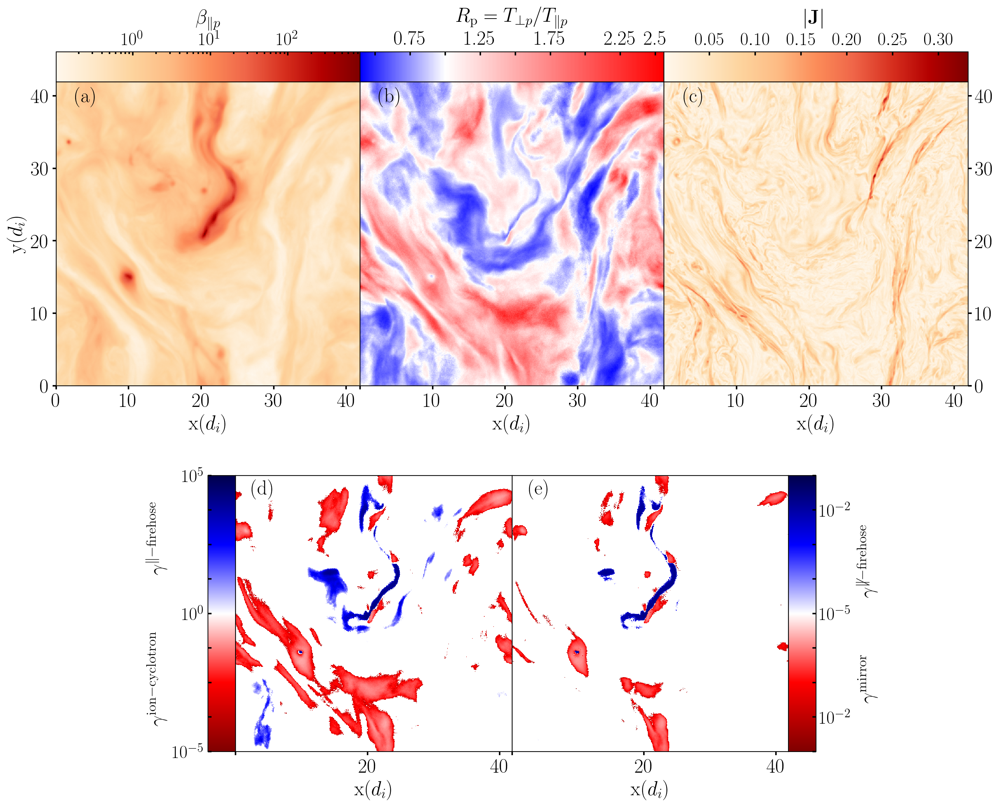

CPU times: user 12.7 s, sys: 6.1 s, total: 18.8 s
Wall time: 12.2 s


In [ ]:
%%time

###############################################################################
# Analysis
###############################################################################

data_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
data_files = ['3Ddata_Rp_betap_b_yan512.h5']

data_file_list = [data_dir + xx for xx in data_files]

gamma_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/gamma_data/'
gamma_files = ['gamma_k_yan_512.h5']

gamma_file_list = [gamma_dir + xx for xx in gamma_files]

key = [ 'g_a_par', 'g_b_par', 'g_a_per', 'g_b_per' ]

j_dir = '/content/gdrive/Shareddrives/Shadowfax/Active_Research/mms/mms_fest/pic/data/'
j_files = ['3Ddata_j_yan512.h5']
j_file_list = [j_dir + xx for xx in j_files]

r_total = []
b_total = []
j_total = []
n_pln = 0

# Read all the data files

#data_r_b = hf.File( 'data/pic_data/data_Rp_betap_jz_b_149p6_lb.h5', 'r+' )
read_data = ''
for ( xx, yy ) in zip( data_file_list[0:1], gamma_file_list[0:1] ) :

    if (read_data) :
        print(xx)
        print(yy)
        data  = hf.File( xx, 'r+' )
        gamma = hf.File( yy, 'r+' )
        j = hf.File( j_file_list[0], 'r+' )

        print(data.keys())
        print(gamma.keys())
        print(j.keys())

        #data_om = hf.File( '../data/om_mag.h5', 'r+' )

        # Extract the data

        # Anisotropy

        rp = data['Rp'][:,:,n_pln]

	    # Beta values

        bp = data['betap'][:,:,n_pln]

        # magnitude of the current
        j_z = np.sqrt(j['jx'][:,:,n_pln]**2 + j['jy'][:,:,n_pln]**2 + j['jz'][:,:,n_pln]**2)

        # non-linear frequency

        #omega  = data_om['om']

	    # gamma values for each region

        a_par = gamma[ key[0] ][:,:,n_pln]
        b_par = gamma[ key[1] ][:,:,n_pln]
        a_per = gamma[ key[2] ][:,:,n_pln]
        b_per = gamma[ key[3] ][:,:,n_pln]

        # Change the nd-arrays to matrix

        b_mat = np.asmatrix( bp )
        r_mat = np.asmatrix( rp )

        j_mat = np.asmatrix( j_z ) 

        #om_mat = asmatrix( omega )

        a_par_mat = np.asmatrix( a_par )
        b_par_mat = np.asmatrix( b_par )
        a_per_mat = np.asmatrix( a_per )
        b_per_mat = np.asmatrix( b_per )

        g_a_par_arr = a_par_mat.getA1( )
        g_b_par_arr = b_par_mat.getA1( )
        g_a_per_arr = a_per_mat.getA1( )
        g_b_per_arr = b_per_mat.getA1( )

        # Create masked arrays for each of the gamma values using a cutoff (matrix)

        a_par_mm = np.ma.masked_where( np.isnan( a_par_mat ), a_par_mat )
        b_par_mm = np.ma.masked_where( np.isnan( b_par_mat ), b_par_mat )
        a_per_mm = np.ma.masked_where( np.isnan( a_per_mat ), a_per_mat )
        b_per_mm = np.ma.masked_where( np.isnan( b_per_mat ), b_per_mat )

        a_par_m = np.ma.masked_where( a_par_mat < 1.e-5, a_par_mat )
        b_par_m = np.ma.masked_where( b_par_mat < 1.e-5, b_par_mat )
        a_per_m = np.ma.masked_where( a_per_mat < 1.e-5, a_per_mat )
        b_per_m = np.ma.masked_where( b_per_mat < 1.e-5, b_per_mat )

        # Create masked arrays for each of the gamma values using a cutoff (array)

        #g_a_par_mm = np.ma.masked_where( np.isnan( g_a_par_arr ), g_a_par_arr )
        #g_b_par_mm = np.ma.masked_where( np.isnan( g_b_par_arr ), g_b_par_arr )
        #g_a_per_mm = np.ma.masked_where( np.isnan( g_a_per_arr ), g_a_per_arr )
        #g_b_per_mm = np.ma.masked_where( np.isnan( g_b_per_arr ), g_b_per_arr )

        #g_a_par_m = np.ma.masked_where( g_a_par_mm < 1.e-5, g_a_par_mm )
        #g_b_par_m = np.ma.masked_where( g_b_par_mm < 1.e-5, g_b_par_mm )
        #g_a_per_m = np.ma.masked_where( g_a_per_mm < 1.e-5, g_a_per_mm )
        #g_b_per_m = np.ma.masked_where( g_b_per_mm < 1.e-5, g_b_per_mm )

    # Draw the figures

    ###########################################################################
    # R, beta and J_z plot
    ###########################################################################

    # Define the figure

    # Define the value of colorbar padding
    pad = 0.0
    labelsize = 20
    clabelsize = 18
    labelpad = 9

    fig = plt.figure( num=None, figsize=( 13, 11 ), dpi=200, facecolor='w', edgecolor='gray' )
    fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01, 
    wspace=0.0, hspace=0.05 )

    if ('Time' in xx ):
        extent=[0, 149.6, 0, 37.4]
    else :
        extent=[0, 41.9, 0, 41.9]

    # Define the axes in the figure

    gs = gridspec.GridSpec(2, 6, width_ratios=[1, 1, 1, 1, 1, 1]) 
    axs1 = fig.add_subplot(gs[0:1, 0:2])

   # Figure 1

    im1 = axs1.imshow( np.transpose( b_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    norm=mpl.colors.LogNorm(vmin=np.amin( b_mat ), vmax=np.amax( b_mat ) ) )

    im1.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs1.text( 125, 135, r'$\beta_{\parallel}$', fontsize=20 )

    axs1.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    axs1.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=labelsize )
    axs1.text(0.1, 0.95, '(a)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs1.transAxes)
    
    # Create a new axis for colorbar

    divider1 = make_axes_locatable(axs1)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax1 = divider1.append_axes("top", size="10%", pad=pad )

    cbar1 = plt.colorbar( im1, cax=cax1, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0.0 )

    # Rotate the ticklabels on the colorbar

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    #cbar1.ax.tick_params( axis='both', which='both', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )
    
    cbar1.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    
    cbar1.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False,width=1.5, labelsize=clabelsize, labelrotation=0 )
    #cbar1.ax.tick_params( axis='both', which='minor', direction='in', labeltop=False, 
    #labelbottom=False, color='b', top=True, bottom=False )

#    labels = [ '1']
#   labels = [ '1', '', '1.4', '', '1.8', '' ]
#   labels = [ '0.4', '', '0.8', '', '1.2', '' ]

    #cbar1.ax.set_xticklabels( labels=labels, rotation=0, fontsize=16 )
    #cbar1.ax.set_xticklabels( cbar1.ax.get_xticklabels(), rotation=0, fontsize=12 )
    #cbar1.ax.xaxis.set_minor_formatter(FormatStrFormatter("%.2f"))

    cbar1.ax.xaxis.set_label_position('top')

    cbar1.set_label( r'$\beta_{\parallel p}$', fontsize=labelsize, labelpad=labelpad )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs2 = fig.add_subplot(gs[0:1, 2:4])

    im2 = axs2.imshow( np.transpose( r_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.bwr, 
    vmin=np.amin( r_mat ),vmax=np.amax( r_mat ),
    #norm=mpl.colors.Normalize( vmin=amin( r_mat ), vmax=amax( r_mat ) ) )
    norm=MidpointNormalize( np.amin( r_mat ), np.amax( r_mat ), 1. ) )

    im2.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
#   print( [ item.get_text() for item in axs1.get_xticklabels() ] )
#   labels2[0] = ''
#
#   axs2.set_xticklabels( labels2 )

#   axs2.text( 115, 135, r'$R_{\mathrm{p}} = T_\perp/T_\parallel$', fontsize=20 )

    axs2.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )

    #axs2.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )

    axs2.get_yaxis().set_visible( False )
    axs2.text(0.1, 0.95, '(b)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs2.transAxes)

    # Create a new axis for colorbar

    divider2 = make_axes_locatable(axs2)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax2 = divider2.append_axes("top", size="10%", pad=pad )

    cbar2 = plt.colorbar( im2, cax=cax2, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '0.4', '', '', '1', '', '', '1.6' ]

    #labels = [ '0.5', '', '1.5', '', '2.5' ]

    #cbar2.ax.set_xticklabels( labels, rotation=0, fontsize=clabelsize )
    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=0, fontsize=10 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar2.ax.tick_params( axis='x', which='major', direction='in', labeltop=True, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )

    cbar2.ax.tick_params( axis='x', which='minor', direction='in', labeltop=False, top=True, 
                         labelbottom=False, bottom=False, width=1.5, labelsize=labelsize, labelrotation=0 )
    #cbar2.ax.tick_params( axis='x', direction='in', labeltop=True, 
    #labelbottom=False, color='b', top=True, bottom=False )

    cbar2.ax.xaxis.set_label_position('top')

    cbar2.set_label( r'$R_{\mathrm{p}} = T_{\perp p}/T_{\parallel p}$', fontsize=labelsize, labelpad=labelpad )

    # Figure 3

    axs3 = fig.add_subplot(gs[0:1, 4:6])

    im3 = axs3.imshow( np.transpose( j_mat ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.OrRd, 
    #vmin=amin(j_mat), vmax=-amin(j_mat), norm=mpl.colors.Normalize())
    #norm=mpl.colors.Normalize( vmin=np.nanmin( j_mat ), vmax=np.nanmax( j_mat ) ) )
    norm=MidpointNormalize( np.amin( j_mat ), np.amax( j_mat ), np.amax( j_mat )/2. ) )

    im3.axes.tick_params( which='both', direction='out', right=True, labelright=True, left=False, labelleft=False,
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

#   axs3.text( 125, 135, r'$J_{\mathrm{Z}}$', fontsize=20 )

    axs3.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs3.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=16 )
    axs3.get_yaxis().set_visible( True )
    axs3.text(0.1, 0.95, '(c)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs3.transAxes)

    # Create a new axis for colorbar

    divider3 = make_axes_locatable(axs3)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax3 = divider3.append_axes("top", size="10%", pad=pad )

    cbar3 = plt.colorbar( im3, cax=cax3, orientation='horizontal', ticks=None, 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    #labels = [ '', '-1', '', '0', '', '1', '' ]
    #labels = [ '-0.4', '', '0', '', '0.4', '' ]
    #cbar3.ax.set_xticklabels( labels, rotation=0, fontsize=18 )

    cbar3.ax.set_xticklabels( cbar3.ax.get_xticklabels(), rotation=0, fontsize=clabelsize )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar3.ax.tick_params( axis='x', direction='in', labeltop=True, 
    labelbottom=False, color='k', width=1.5, top=True, bottom=False, labelsize=clabelsize )

    cbar3.ax.xaxis.set_label_position('top')

    cbar3.set_label( r'$|\mathbf{J}|$', fontsize=labelsize, labelpad=labelpad )

#   plt.tight_layout( )

#   plt.show()

#   fig_name2 = 'figures/b_r_j_' + xx[98:-3] + '.pdf'
#   plt.savefig( fig_name2, bbox_inches = 'tight', pad_inches = 0.05, dpi=300)

    ###########################################################################
    # Gamma plots.
    ###########################################################################

    # Define the axes in the figure

    axs4 = fig.add_subplot(gs[1:2, 1:3])
#	fig.subplots_adjust( left=0.01, right=0.99, top=0.99, bottom=0.01,
#	                                                  wspace=0., hspace=0. )

    # Figure 1

    im4a = axs4.imshow( np.transpose( a_par_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b = axs4.imshow( 1.e5*np.transpose( b_par_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', cmap=plt.cm.seismic_r, 
    norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(1.e-5, 1.e4, 1.) )

    im4b.axes.tick_params( which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs4.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs4.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
#   axs4.set_ylabel( r'$\mathrm{y} ( d_i )$', fontsize=18 )
    axs4.get_yaxis().set_visible( False )
    axs4.text(0.1, 0.95, '(d)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs4.transAxes)

    # Create a new axis for colorbar

    divider4 = make_axes_locatable(axs4)

    # Define the location of the colorbar, it's size relative to main figure 
    # and the padding between the colorbar and the figure, the orientation
    # the colorbar

    cax4 = divider4.append_axes("left", size="10%", pad=pad )

    cbar4 = plt.colorbar( im4b, cax=cax4, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25),
    10**(2.5), 10**(3.75), 10**(5)  ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl4 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$', '', '', '${10^{-2}}$','' ]

    cbar4.ax.set_xticklabels( lbl4, rotation=0, fontsize=clabelsize  )
    #cbar4.ax.set_xticklabels( cbar4.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar4.ax.tick_params( axis='y', direction='in', labelleft=True, 
    labelright=False, color='k', left=True, right=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar4.ax.yaxis.set_label_position('left')

    #cbar4.ax.set_xlabel( r'\textcolor{red}{Ion-Cyclotron} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar4.ax.set_ylabel( r'Ion-Cyclotron $\hspace{2em}$ Firehose',
    #y= 0.5, weight=None, fontsize=clabelsize )
    cbar4.ax.set_ylabel(r'$\gamma^{\mathrm{ion-cyclotron}} \hspace{2cm} \gamma^{\mathrm{\parallel-firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.title( r'$\gamma$', fontsize=24 )

    # Figure 2

    axs5 = fig.add_subplot(gs[1:2, 3:5])

    im5a = axs5.imshow( np.transpose( a_per_m ), aspect='equal', origin='lower', 
    extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )

    im5b = axs5.imshow( 1.e5*np.transpose( b_per_m ), aspect='equal', 
    origin='lower', extent=extent, interpolation='nearest', 
    cmap=plt.cm.seismic_r, norm=mpl.colors.LogNorm( vmin=1.e-5, vmax=1.e5 ) )
    #norm=MidpointLogNorm(0.001, 1.1, 0.) )
    #axs.set_title( r'$\gamma_{\parallel}$', fontsize=22 )

    im5b.axes.tick_params( axis='both', which='both', direction='out',
    labelbottom=True, bottom=True, width=1.5, labelsize=labelsize, labelrotation=0 )

    #axs5.text( 95, 115, r'$\gamma_{\max}/\Omega_p$', fontsize=20 )

    axs5.set_xlabel( r'$\mathrm{x} ( d_i )$', fontsize=labelsize )
    #axs5.set_ylabel( r'$\mathrm{y} ( d_i )$' )
    axs5.get_yaxis().set_visible( False )
    axs5.text(0.1, 0.95, '(e)', horizontalalignment='center', fontsize=labelsize,
                          verticalalignment='center', transform= axs5.transAxes)
    
    # Create a new axis for colorbar

    divider5 = make_axes_locatable(axs5)

    # Define the location of the colorbar, it's size relative to main figure
    # and the padding between the colorbar and the figure, the orientation 
    # the colorbar

    cax5 = divider5.append_axes("right", size="10%", pad=pad )

    #cbar5 = plt.colorbar( im5, cax=cax5, orientation='horizontal', ticks=None, 
    #fraction=0.05, pad=0.1, shrink=0.6 )

    cbar5 = plt.colorbar( im5b, cax=cax5, orientation='vertical', ticks=[ 
    10**(-5), 10**(-3.75), 10**(-2.5), 10**(-1.25), 10**(0), 10**(1.25), 
    10**(2.5), 10**(3.75), 10**(5)  ], 
    #1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4 ], 
    fraction=0.05, pad=0 )

    # Rotate the ticklabels on the colorbar

    lbl5 = [ '', '${10^{-2}}$', '', '', '${10^{-5}}$','', '', '${10^{-2}}$', '' ]

    cbar5.ax.set_yticklabels( lbl5, rotation=0, fontsize=clabelsize  )

    #cbar2.ax.set_xticklabels( cbar2.ax.get_xticklabels(), rotation=270 )

    # Define the parameters related to the label of tickmarks and their relative
    # positioning, color of the tickmarks, and where they appear on the colorbar

    cbar5.ax.tick_params( axis='y', direction='in', labelright=True, 
    labelleft=False, color='k', top=True, bottom=False, width=1.5, labelsize=clabelsize )

    # Define the position of colorbar label and plot the label

    cbar5.ax.yaxis.set_label_position('right')

    #cbar5.ax.set_xlabel( r'\textcolor{red}{Mirror} \hspace{2em} \textcolor{blue}{Firehose}',
    #cbar5.ax.set_xlabel( r'Mirror $\hspace{2em}$ Firehose', x= 0.5, weight=None, fontsize=16 )
    cbar5.ax.set_ylabel( r'$\gamma^{\mathrm{mirror}} \hspace{2cm} \gamma^{\not \parallel-\mathrm{firehose}}$',
                        y= 0.5, weight=None, fontsize=labelsize, labelpad=5.0, rotation=90 )

    #plt.tight_layout( )

    #plt.show()

    fig_name = f'figures/chap5/{xx[77:-3]}_{yy[88:-3]}.pdf'
    plt.savefig( fig_name, bbox_inches = 'tight', pad_inches = pad )

    #plt.close( 'all' )

    labels2 = [ item.get_text() for item in axs2.get_xticklabels() ]
    labels2[0] = ''

    axs2.set_xticklabels( labels2 )

    labels3 = [ item.get_text() for item in axs3.get_xticklabels() ]
    labels3[0] = ''
    axs3.set_xticklabels( labels3 )

    labels4 = [ item.get_text() for item in axs4.get_xticklabels() ]
    labels4[0] = ''
    axs4.set_xticklabels( labels4 )

    labels5 = [ item.get_text() for item in axs5.get_xticklabels() ]
    labels5[0] = ''
    axs5.set_xticklabels( labels5 )
    
    clabels2 = [ xx for xx in cbar2.get_ticks() ]
    clabels2[0] = ''
    clabels2[2] = ''
    clabels2[4] = ''
    clabels2[6] = ''
    cbar2.ax.set_xticklabels(clabels2)

    #clabels3 = [ xx for xx in cbar3.get_ticks() ]
    #clabels3[0] = ''
    #clabels3[2] = ''
    #clabels3[4] = ''
    #clabels3[6] = ''
    #cbar3.ax.set_xticklabels(clabels3)

    plt.savefig( fig_name, bbox_inches='tight', pad_inches=0.08 )
    plt.close()

### Spacecraft vs MMS observation